<a href="https://colab.research.google.com/github/sergiomora03/deep-learning-intermediate/blob/master/Activities/Semana7_TransferLearning_Actividad.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## MIIA-4203 MODELOS AVANZADOS PARA ANÁLISIS DE DATOS II


# Aprendizaje por transferencia con redes neuronales 


### Profesor: Camilo Franco (c.franco31@uniandes.edu.co)

En este cuadernos estudiaremos una implementación de aprendizaje por transferencia utilizando la red pre-entrenada VGG-16. Implementaremos nuestra propio modelo de aprendizaje por trasferencia utilizando la biblioteca (API) Keras (https://keras.io/). 

Finalmente evaluaremos si un modelo más complejo de *deep learning* nos permite lograr un mejor desempeño para la detección automática de frailejones sobre imagenes aereas del páramo.

Primero importemos algunos de los paquetes que vamos a utilizar, junto con las imagenes de entrenamiento:


In [ ]:
import pandas as pd
import numpy as np
import h5py
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm

from ImportImagenesRGB import *
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix 
import sklearn.mixture as sm

%load_ext autoreload
%autoreload 2

import warnings
warnings.filterwarnings("ignore", category=FutureWarning)

from prettytable import PrettyTable
import datetime

import keras
from keras.models import Sequential, load_model, Model
from keras.optimizers import SGD
from keras.layers import Conv2D, MaxPooling2D, Activation, Dropout, Flatten, Dense, GlobalAveragePooling2D
from keras import applications

import optuna
import tensorflow as tf

from numpy.random import seed
seed(1)
from tensorflow.random import set_seed
set_seed(1)

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [ ]:
X,Y = import_imagenes_RGB()

print(X.shape, Y.shape, X[0,0,0])

(250, 70, 70, 3) (1, 250) [0.58823529 0.5372549  0.40392157]


**Salida esperada:**

(250, 70, 70, 3) (1, 250) [0.58823529 0.5372549  0.40392157]


## 1. Aprendizaje por transferencia

En pocas palabras, el aprendizaje por transferencia tiene su historia en la psicología, refiriendose a situaciones donde las personas aplican concimiento, estrategias y aptitudes que han aprendido previamente para enfrentar una nueva situación bajo un contexto **relacionado**. Dentro del aprendizaje computacional, este tipo de aprendizaje se enfoca en guardar un tipo de conocimiento que ya se ha mostrado útil para resolver un problema, y aplicarlo para resolver otro problema distinto pero **relacionado**.

Hay que tener en cuenta que si un modelo de transferencia tiene un efecto negativo sobre el desempeño del modelo, entonces tendremos una transferencia negativa (lo cual no es deseable). De este modo, el reto de los métodos de transferencia es el de producir una transferencia positiva entre tareas apropiadamente relacionadas, evitando transferencias negativas entre tareas poco relacionadas (ver Torrey & Shavlik (2009) Transfer learning). 

El ejemplo que vamos a ver a continuación es un tipo de aprendizaje por transferencia inductivo, característico de las redes neuronales, el cual se ajusta de acuerdo con la coincidencia de un conocimiento previo sobre la fuente de información y la tarea que se propone solucionar. En particular, vamos a llevar a cabo un *aprendizaje por transferencia inductivo-jerárquico*, buscando soluciones a tareas sencillas mediante la combinación de herramientas desarrolladas para tareas más complejas. Entonces, usamos el aprendizaje de una red pre-entrenada, la VGG-16, para aprovechar su conocimiento sobre formas, contornos, bordes, etc. que podemos hacer propias para terminar de entender mejor el problema de clasificación de frailejones, y esperamos mejorar el desempeño de los modelos.


### VGG-16

La red VGG-16 fue propuesta por Simonyan & Zisserman (2015) en Very deep CNN for large-scale image recognition, siguiendo los principios presentados en Ciresan et al. (2011): Flexible, High Performance Convolutional Neural Networks for Image Classification.

La arquitectura de la VGG-16 le permitió ganar la competición ILSVR(Imagenet) 2014 (http://www.image-net.org/challenges/LSVRC/2014/results). Los principios de esta arquitectura consisten en considerar filtros convolucionales pequeños (de $3\times 3$), que recorren las imagenes exhaustivamente, con un *stride* de 1, y capas de *max-poling* de $2\times 2$, reduciendo en gran medida el número de hiper-parámetros a optimizar. La red VGG-16 es bastante profunda, con una configuración de 16 capas (con aprox. 138 millones de parámetros): para las primeras 14 capas combina capas convolucionales y capas de agregación, y al final tiene 2 capa densamente conectadas seguidas de una capa de salida *softmax* para clasificación de múltiples clases (ver: https://neurohive.io/en/popular-networks/vgg16/).


Implementemos nuestro ejemplo de aprendizaje por transferencia utilizando la red VGG-16, la cual ha sido entrenada previamente con imagenes RGB y que podemos descargar directamente de Keras:

In [ ]:
model0   = applications.VGG16(include_top=False, weights='imagenet')
config_transI = model0.get_config()

Pasamos nuestro conjunto de datos por la red, obteniendo los nuevos patrones de acuerdo con el entendimiento de la red convolucional VGG-16 acerca de las nociones más básicas que encuentra en nuestras imagenes del Páramo:

In [ ]:
feat_X = model0.predict(X)

Agregamos unas pocas capas finales para afinar el modelo por transferencia para la tarea específica de detección de imagenes aereas del Páramo:

In [ ]:
#inicializacion Normal
initnorm = keras.initializers.RandomNormal(mean=0.0, stddev=0.05, seed=1)

model = Sequential()  
model.add(Flatten(input_shape=feat_X.shape[1:]))  
model.add(Dense(5, activation='sigmoid', kernel_initializer=initnorm, bias_initializer='zeros'))  
model.add(Dense(1, activation='sigmoid', kernel_initializer=initnorm, bias_initializer='zeros')) 

config_transF = model.get_config()

Y entrenamos esas capas finales:

In [ ]:
# Inicializamos la tabla donde guardamos los resultados
x = PrettyTable(["Exac_E", "Exac_V", "Exac_P", "Epoca"])

# Definimos el número máximo de iteraciones (épocas de la red)
epocas=100

# Definimos los parametros del Adam
adam = keras.optimizers.Adam(lr=0.001, beta_1=0.9, beta_2=0.999)

# Inicializamos el error 
err_p = 999

for i in range(0,3,1):
    r = i^3
    CE_x, CV0_x, CE_y, CV0_y = train_test_split(feat_X, Y.T, test_size = 0.3, random_state = r)
    CV_x, CP_x, CV_y, CP_y = train_test_split(CV0_x, CV0_y, test_size = 0.5, random_state = r)
       
    # Definimos la arquitectura de la red
    model = Sequential.from_config(config_transF)
    
    # Definimos el método de optimización con respecto a su funcion de perdida (además guardamos la exactitud para cada iteracion)
    model.compile(loss='binary_crossentropy', optimizer=adam, metrics=['accuracy'])
    
    # Ajustamos el modelo
    history=model.fit(x=CE_x, y=CE_y, epochs=epocas, validation_data=(CV_x, CV_y), verbose=0, shuffle=False)
    
    # Encontramos el mejor modelo en validación
    min_err=np.min(history.history['val_loss'])
    best_epoc=np.where(history.history['val_loss'] == min_err)[0] 
        
    # Conseguimos el mejor modelo de acuerdo con su desempeño en validación
    model.fit(x=CE_x, y=CE_y, epochs=best_epoc[0], validation_data=(CV_x, CV_y), verbose=0, shuffle=False)
            
    # Calculamos las metricas
    train_metrics = model.evaluate(x=CE_x, y=CE_y, verbose=0)
    valid_metrics = model.evaluate(x=CV_x, y=CV_y, verbose=0)
    test_metrics = model.evaluate(x=CP_x, y=CP_y, verbose=0)
    
    # Guardamos las métricas de desempeño
    accu_e = train_metrics[1]
    loss_e = train_metrics[0]
    accu_v = valid_metrics[1]
    loss_v = valid_metrics[0]
    accu_p = test_metrics[1]
    loss_p = test_metrics[0]
    
    if (loss_p < err_p):
        pathr =('Transfer_Adam_partseed='+str(r)+'.tf')
        model.save(pathr) 
        err_p = loss_p
    
    # Imprimimos el desempeño para cada repetición
    print('Epoca= '+str(best_epoc[0])+' , accu_v1='+str(accu_v) +' , accu_v2='+str(accu_p))
    
    x.add_row([np.round(accu_e,4), np.round(accu_v,4), np.round(accu_p,4), best_epoc[0]])

print(x)


Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.
Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.
INFO:tensorflow:Assets written to: Transfer_Adam_partseed=3.tf\assets
Epoca= 99 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339
Epoca= 99 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339
INFO:tensorflow:Assets written to: Transfer_Adam_partseed=1.tf\assets
Epoca= 99 , accu_v1=1.0 , accu_v2=0.9736841917037964
+--------+--------+--------+-------+
| Exac_E | Exac_V | Exac_P | Epoca |
+--------+--------+--------+-------+
|  1.0   | 0.973  | 0.9211 |   99  |
|  1.0   | 0.973  | 0.9211 |   99  |
|  1.0   |  1.0   | 0.9737 |   99  |
+--------+--------+--------+-------+


Graficamos el desempeño del modelo:

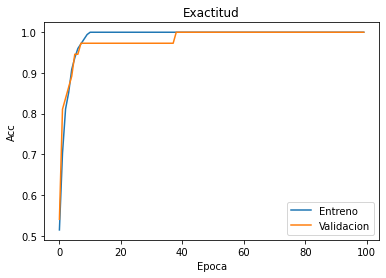

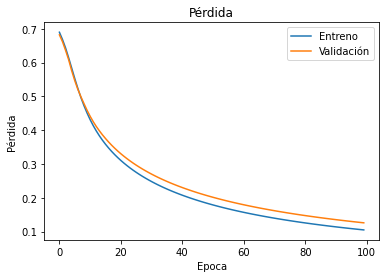

In [ ]:
plt.figure(1)
plt.plot(history.history['accuracy'])  
plt.plot(history.history['val_accuracy'])  
plt.title('Exactitud')  
plt.ylabel('Acc')  
plt.xlabel('Epoca')  
plt.legend(['Entreno', 'Validacion'], loc='lower right')
plt.show()

plt.figure(1) 
plt.plot(history.history['loss'])  
plt.plot(history.history['val_loss'])  
plt.title('Pérdida')  
plt.ylabel('Pérdida')  
plt.xlabel('Epoca')  
plt.legend(['Entreno', 'Validación'], loc='upper right')  
plt.show()

Cargamos el mejor modelo y confirmamos el desempeño del modelo sobre todo el conjunto de datos:

In [ ]:
# red convolucional
model_4 = load_model('Transfer_Adam_partseed=1.tf')

model_4.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten (Flatten)            (None, 2048)              0         
_________________________________________________________________
dense (Dense)                (None, 5)                 10245     
_________________________________________________________________
dense_1 (Dense)              (None, 1)                 6         
Total params: 10,251
Trainable params: 10,251
Non-trainable params: 0
_________________________________________________________________


Veamos el desempeño del mejor modelo sobre todo el conjunto de datos:

In [ ]:
Y_pred = model_4.predict(feat_X)
Y_preds = (Y_pred > 0.5)

confusion_matrix(Y.T, Y_preds)

array([[144,   1],
       [  0, 105]], dtype=int64)

**Salida esperada:**
    
<table style="width:20%">
    <tr>
       <td> 144 </td>
       <td> 1 </td>
    </tr>
    <tr>
       <td> 0 </td>
       <td> 105 </td>
    </tr>

</table>

Podemos observar que el desempeño del modelo a mejorado bastante. 

### Ejercicio 1.1

Encuentre el mejor modelo examinando una configuración distinta para las capas de salida, o siguiendo alguna otra estrategia como puede ser cambiando el optimizador o las funciones de activación.

#### Automatización de ajustes en hiperparámetros con [**Optuna**](https://optuna.org/)
Para mejorar los resultados. Realizaremos una automatización en los ajustes de hiperparámetros con **Optuna**. La automaticación se basará en realizar diferentes arquitecturas para varios espacios de busqueda, que denominaremos de ahora en adelante: **trials**.

Antes, revisemos la estructura del modelo **VGG16**:

In [ ]:
model0.summary()

Model: "vgg16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, None, None, 3)]   0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, None, None, 64)    1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, None, None, 64)    36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, None, None, 64)    0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, None, None, 128)   73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, None, None, 128)   147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, None, None, 128)   0     

Ahora, limpiaremos la sesión. 

In [ ]:
keras.backend.clear_session()

Ahora si, podemos continuar. En trabajo anteriores, hemos trabajado con **Tensorboard** y también realizado los ajustes de hiperparámetros con grillas. En este momento trataremos de hacerlo con [**Optuna:**](https://optuna.org/) *'Optuna es un framework de optimización de hiperparámetros'*. 

[Acá puede ver un ejemplo sencillo del uso de **Optuna**](https://nbviewer.jupyter.org/github/sergiomora03/deep-learning-intermediate/blob/master/Activities/hyper_parameter_optimization_using_optuna.ipynb)

De manera que no tengamos que probar una a una de las combinaciones de los hiperparámetros generando uno a uno de los diferentes modelos y luego comparar la exatitud y ajuste como se ha realizado con la grilla o **Tensorboard** sino que haremos de extremo a extremo un ajuste de hiperparámetros automatizado para redes neuronales profundas. 

Iniciaremos con la función `create_model(trial)`. La cual, tiene una argumento: *trial* que representa los espacios de búsqueda de:

* Número de capas
* Dropout_rate
* Funciones de activación
* Regularización
* Inicializadores

In [ ]:
initnorm = keras.initializers.RandomNormal(mean=0.0, stddev=0.05, seed=1)
def create_model(trial):
    # num of hidden layer
    n_layers = trial.suggest_int('n_layers', 1, 13)
    
    # dropout_rate
    #dropout_rate = trial.suggest_uniform('dropout_rate', 0.0, 0.5)
    
    # Activation function
    activation_selected = trial.suggest_categorical("activation", ["selu", "sigmoid", "tanh"])
    
    # Regularization ~ (maybe not now)
    #weight_decay = trial.suggest_float("weight_decay", 1e-10, 1e-3, log=True)
    
    model = Sequential()
    model.add(Flatten(input_shape=feat_X.shape[1:])) #model.add(GlobalAveragePooling2D(input_shape=feat_X.shape[1:]))
    for i in range(n_layers):
        #model.add(Dropout(rate=dropout_rate))
        num_hidden = trial.suggest_int("n_units_l{}".format(i), 4, 128, log=True)
        model.add(Dense(num_hidden, activation=activation_selected, kernel_initializer=initnorm, bias_initializer='zeros')) 
        #model.add(Dense(num_hidden,activation=init_selected,kernel_regularizer=tf.keras.regularizers.l2(weight_decay)))
    model.add(Dense(1, activation='sigmoid', kernel_initializer=initnorm, bias_initializer='zeros')) 
    
    return model

Luego crearemos un metodo para definir el optimizador de la red neuronal. Donde, acotaremos los espacios de busqueda de los hiperparamétros del optimizador. 

Definiremos dos métodos para automatizar el ajuste de hiperparámetros del optimizador. El primero es un método aplicado para Adam, llamaremos la función `create_optimizer(trial)`. Validaremos los siguiente hiperpárametros en el método:

*Optimizador de Adam*
- Tasa de aprendizaje
- Beta 1
- Beta 2

##### Definimos los parametros del Adam

Tendrá la siguiente estructura:

In [ ]:
# Definimos los parametros del Adam
def create_optimizer(trial):
    learning_rate = trial.suggest_loguniform('learning_rate', 1e-5, 1e-2)
    beta_1 = trial.suggest_loguniform('beta_1', 0.0001, 0.9)
    beta_2 = trial.suggest_loguniform('beta_2', 0.0001, 0.9)
    
    optimizer = keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1, beta_2=beta_2)
    
    return optimizer

Y el segundo método aplicado para *RMSprop*, *Adam* y *SGD*. llamaremos la función `create_optimizer_two(trial)`. Definiremos los siguientes hiperparámetros dentro del método:

*RMSprop*
- Tasa de aprendizaje
- Tasa de decadencia
- Momentum

*Adam*
- Tasa de aprendizaje
- Beta 1
- Beta 2

*SGD*
- Tasa de aprendizaje
- Momentum

##### Definimos los parametros del RMSprop, Adam, SGD

Que tendrá la siguiente estructura:

In [ ]:
def create_optimizer_two(trial):
    # We optimize the choice of optimizers as well as their parameters.
    kwargs = {}
    optimizer_options = ["RMSprop", "Adam", "SGD"]
    optimizer_selected = trial.suggest_categorical("optimizer", optimizer_options)
    if optimizer_selected == "RMSprop":
        kwargs["learning_rate"] = trial.suggest_float(
            "rmsprop_learning_rate", 1e-5, 1e-1, log=True
        )
        kwargs["decay"] = trial.suggest_float("rmsprop_decay", 0.85, 0.99)
        kwargs["momentum"] = trial.suggest_float("rmsprop_momentum", 1e-5, 1e-1, log=True)
    elif optimizer_selected == "Adam":
        kwargs["learning_rate"] = trial.suggest_float("adam_learning_rate", 1e-5, 1e-1, log=True)
        kwargs["beta_1"] = trial.suggest_loguniform('beta_1', 0.0001, 0.9)
        kwargs["beta_2"] = trial.suggest_loguniform('beta_2', 0.0001, 0.9)
    elif optimizer_selected == "SGD":
        kwargs["learning_rate"] = trial.suggest_float(
            "sgd_opt_learning_rate", 1e-5, 1e-1, log=True
        )
        kwargs["momentum"] = trial.suggest_float("sgd_opt_momentum", 1e-5, 1e-1, log=True)

    optimizer = getattr(tf.optimizers, optimizer_selected)(**kwargs)
    return optimizer

Con esto, ahora definiremos el método `trainer(trial, optimizer = "create_optimizer")` para entrenar el modelo. Tendrá además de *trial*, el tipo de optimizador que debe usarse (Aplicado solo para _Adam_ o aplicado para _RMSprop_ , _Adam_ y _SGD_ ). Mantendremos también dentro de este método la doble valición cruzada.

Además, el entrenamiento al igual que el realizado por el profesor es con base en el pronóstico de la red convolucional VGG 16. 

#### Definiremos el método de entrenamiento

En este método, además definiremos los siguientes hiperparámetros:

- Número de iteraciones o epocas.

In [ ]:
def trainer(trial, optimizer = "create_optimizer"):
    # Inicializamos la tabla donde guardamos los resultados
    x = PrettyTable(["Exac_E", "Exac_V", "Exac_P", "Epoca", "Optimizer"])
    
    # Inicializamos el error 
    err_p = 999

    for i in range(0,3,1):
        r = i^3
        CE_x, CV0_x, CE_y, CV0_y = train_test_split(feat_X, Y.T, test_size = 0.3, random_state = r)
        CV_x, CP_x, CV_y, CP_y = train_test_split(CV0_x, CV0_y, test_size = 0.5, random_state = r)
    
        epocas = trial.suggest_categorical('epocas', [100, 200, 300])
        
        # Definimos la arquitectura de la red
        model = create_model(trial)
        
        # Definimos el método de optimización con respecto a su funcion de perdida (además guardamos la exactitud para cada iteracion)
        if optimizer == "create_optimizer_two":
            optimizer = create_optimizer_two(trial)
        elif optimizer == "create_optimizer":
            optimizer = create_optimizer(trial)
        else:
            optimizer = create_optimizer(trial)
        
        # Compilamos el modelo
        model.compile(loss='binary_crossentropy', optimizer=optimizer, metrics=['accuracy'])
        
        # Ajustamos el modelo
        history=model.fit(x=CE_x, y=CE_y, epochs=epocas, validation_data=(CV_x, CV_y), verbose=0, shuffle=False)
        
        # Encontramos el mejor modelo en validación
        min_err=np.min(history.history['val_loss'])
        best_epoc=np.where(history.history['val_loss'] == min_err)[0] 
            
        # Conseguimos el mejor modelo de acuerdo con su desempeño en validación
        model.fit(x=CE_x, y=CE_y, epochs=best_epoc[0], validation_data=(CV_x, CV_y), verbose=0, shuffle=False)
            
        # Calculamos las metricas
        train_metrics = model.evaluate(x=CE_x, y=CE_y, verbose=0)
        valid_metrics = model.evaluate(x=CV_x, y=CV_y, verbose=0)
        test_metrics = model.evaluate(x=CP_x, y=CP_y, verbose=0)
        
        # Guardamos las métricas de desempeño
        accu_e = train_metrics[1]
        loss_e = train_metrics[0]
        accu_v = valid_metrics[1]
        loss_v = valid_metrics[0]
        accu_p = test_metrics[1]
        loss_p = test_metrics[0]
        
        if (loss_p < err_p):
            pathr =('Modelos/Impr_Optuna_Transfer_Adam_partseed='+str(r)+'.tf') #pathr =('Modelos/Impr_optimizer='+str(optimizer)+'_Transfer_Adam_partseed='+str(r)+'.tf')
            model.save(pathr) 
            err_p = loss_p
    
        # Imprimimos el desempeño para cada repetición
        print('Epoca= '+str(best_epoc[0])+' , accu_v1='+str(accu_v) +' , accu_v2='+str(accu_p) + ' , Optimizer=' + str(optimizer.get_config()["name"]))
        
        x.add_row([np.round(accu_e,4), np.round(accu_v,4), np.round(accu_p,4), best_epoc[0], optimizer.get_config()["name"]])
        

    
    print(x)
    return model, CV_x, CV_y

En resumen, generaremos distintos espacios de busqueda con **Optuna**. Y cada espacio de busqueda, tendrá acotados los sguientes hiperparámetros:

**Hiperparámetros en general**

- Número de capas: de 1 a 13 unidades o neuronas.
- Dropout_rate: de 0.0 a 0.5 
- Funciones de activación: Selu, Sigmoid, Tanh.
- Regularización: de 1e-10 a 1e-3
- Inicializadores: Normal~($\mu = 0.0, \sigma = 0.05$)
- Número de iteraciones o epocas: 100, 200, 300.


**Optimizadores de la red neuronal**

*RMSprop*

- Tasa de aprendizaje: de 1e-5 a 1e-1
- Tasa de decadencia: de 0.85 a 0.99
- Momentum: de 1e-5 a 1e-1

*Adam*

- Tasa de aprendizaje: de 1e-5 a 1e-1
- Beta 1: 0.0001 a 0.9
- Beta 2: 0.0001 a 0.9

*SGD*

- Tasa de aprendizaje: de 1e-5 a 1e-1
- Momentum: de 1e-5 a 1e-1


Evidentemente, si se realiza una grilla o usaramos **Tensorboard** tendríamos que probar una cantidad considerable de modelos. Lo que haremos con **Optuna** es crear distintos espacios de busqueda acotados por los límites mencionados. Luego, **Optuna** realizará una _optimización_ para cada uno de los espacios de busqueda. Y finalmente, guardará el mejor resultado de todos los espacios de busqueda.

Entendido eso, **Optuna** necesita una función objetivo. Tenemos que tener en cuenta que **Optuna** minimiza por defecto la función objetivo, por lo que definimos la función objetivo `1 - precisión`. Donde la `precisión` es con base en la exactitud del modelo en el **conjunto de validación**. 

#### Definiremos la función objetivo

De la siguiente manera:

In [ ]:
def objective(trial):

    model, CV_x, CV_y = trainer(trial)
    evaluate = model.evaluate(x=CV_x, y=CV_y, verbose=0)
    
    return 1 - evaluate[1]

### Estudio 1° (Optimizador Adam)

Finalmente, con esto. Crearemos un _estudio_ con varios espacios de busqueda, precisamente, crearemos $100$ espacios de busqueda o *trials*. Guardaremos este estudio en `study`. De la siguiente manera:

In [ ]:
study = optuna.create_study()
study.optimize(objective, n_trials=100)

[I 2020-10-01 21:59:05,051] A new study created in memory with name: no-name-013bb0e3-ee35-4bd4-8838-6fee0aaf4f4b


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 49 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=Adam
Epoca= 50 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 19 , accu_v1=0.5405405163764954 , accu_v2=0.6315789222717285 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   49  |    Adam   |
|  0.6   | 0.4595 | 0.6053 |   50  |    Adam   |
| 0.5771 | 0.5405 | 0.6316 |   19  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 21:59:58,555] Trial 0 finished with value: 0.45945948362350464 and parameters: {'epocas': 300, 'n_layers': 1, 'activation': 'sigmoid', 'n_units_l0': 4, 'learning_rate': 0.0046879992059093425, 'beta_1': 0.4350507469577737, 'beta_2': 0.008859730150013904}. Best is trial 0 with value: 0.45945948362350464.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 9 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=Adam
Epoca= 20 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 2 , accu_v1=0.5405405163764954 , accu_v2=0.6315789222717285 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   9   |    Adam   |
|  0.6   | 0.4595 | 0.6053 |   20  |    Adam   |
| 0.5771 | 0.5405 | 0.6316 |   2   |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:00:24,974] Trial 1 finished with value: 0.45945948362350464 and parameters: {'epocas': 100, 'n_layers': 2, 'activation': 'tanh', 'n_units_l0': 15, 'n_units_l1': 52, 'learning_rate': 0.007413403607973277, 'beta_1': 0.3016648980794358, 'beta_2': 0.0037796083591012295}. Best is trial 0 with value: 0.45945948362350464.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=Adam
Epoca= 0 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 1 , accu_v1=0.5405405163764954 , accu_v2=0.6315789222717285 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    Adam   |
|  0.6   | 0.4595 | 0.6053 |   0   |    Adam   |
| 0.5771 | 0.5405 | 0.6316 |   1   |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:01:27,072] Trial 2 finished with value: 0.45945948362350464 and parameters: {'epocas': 300, 'n_layers': 8, 'activation': 'sigmoid', 'n_units_l0': 18, 'n_units_l1': 37, 'n_units_l2': 45, 'n_units_l3': 20, 'n_units_l4': 28, 'n_units_l5': 33, 'n_units_l6': 128, 'n_units_l7': 20, 'learning_rate': 0.0005213677172080137, 'beta_1': 0.06877530430734735, 'beta_2': 0.010934580221230901}. Best is trial 0 with value: 0.45945948362350464.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 299 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
Epoca= 299 , accu_v1=0.9729729890823364 , accu_v2=0.8684210777282715 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 299 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.9737 |  299  |    Adam   |
| 0.9886 | 0.973  | 0.8684 |  299  |    Adam   |
|  1.0   | 0.973  | 0.9737 |  299  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:02:58,947] Trial 3 finished with value: 0.027027010917663574 and parameters: {'epocas': 300, 'n_layers': 1, 'activation': 'sigmoid', 'n_units_l0': 60, 'learning_rate': 0.00011374726913657013, 'beta_1': 0.026627255666276217, 'beta_2': 0.012896671921427192}. Best is trial 3 with value: 0.027027010917663574.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=Adam
Epoca= 0 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 99 , accu_v1=0.5405405163764954 , accu_v2=0.6315789222717285 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    Adam   |
|  0.6   | 0.4595 | 0.6053 |   0   |    Adam   |
| 0.5771 | 0.5405 | 0.6316 |   99  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:03:37,469] Trial 4 finished with value: 0.45945948362350464 and parameters: {'epocas': 100, 'n_layers': 9, 'activation': 'tanh', 'n_units_l0': 4, 'n_units_l1': 27, 'n_units_l2': 4, 'n_units_l3': 83, 'n_units_l4': 4, 'n_units_l5': 13, 'n_units_l6': 5, 'n_units_l7': 10, 'n_units_l8': 4, 'learning_rate': 6.532505612405609e-05, 'beta_1': 0.00010267156124872316, 'beta_2': 0.00020788509566038485}. Best is trial 3 with value: 0.027027010917663574.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=Adam
Epoca= 99 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 0 , accu_v1=0.5405405163764954 , accu_v2=0.6315789222717285 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    Adam   |
|  0.6   | 0.4595 | 0.6053 |   99  |    Adam   |
| 0.5771 | 0.5405 | 0.6316 |   0   |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:04:13,628] Trial 5 finished with value: 0.45945948362350464 and parameters: {'epocas': 100, 'n_layers': 4, 'activation': 'sigmoid', 'n_units_l0': 52, 'n_units_l1': 7, 'n_units_l2': 4, 'n_units_l3': 34, 'learning_rate': 8.862986468982634e-05, 'beta_1': 0.07000408203435142, 'beta_2': 0.0009935549224254912}. Best is trial 3 with value: 0.027027010917663574.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 299 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 299 , accu_v1=1.0 , accu_v2=0.9210526347160339 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 299 , accu_v1=1.0 , accu_v2=1.0 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.9211 |  299  |    Adam   |
|  1.0   |  1.0   | 0.9211 |  299  |    Adam   |
|  1.0   |  1.0   |  1.0   |  299  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:05:55,615] Trial 6 finished with value: 0.0 and parameters: {'epocas': 300, 'n_layers': 7, 'activation': 'tanh', 'n_units_l0': 32, 'n_units_l1': 8, 'n_units_l2': 73, 'n_units_l3': 119, 'n_units_l4': 10, 'n_units_l5': 18, 'n_units_l6': 14, 'learning_rate': 7.58304311601183e-05, 'beta_1': 0.005758093313705508, 'beta_2': 0.0030461601009733738}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 199 , accu_v1=1.0 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 35 , accu_v1=0.9729729890823364 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 32 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   |  1.0   | 0.9211 |  199  |    Adam   |
|  1.0   | 0.973  | 0.8947 |   35  |    Adam   |
|  1.0   | 0.973  | 0.9737 |   32  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:06:50,531] Trial 7 finished with value: 0.027027010917663574 and parameters: {'epocas': 200, 'n_layers': 4, 'activation': 'sigmoid', 'n_units_l0': 54, 'n_units_l1': 4, 'n_units_l2': 60, 'n_units_l3': 121, 'learning_rate': 0.0022257562141632142, 'beta_1': 0.00048278094710980577, 'beta_2': 0.1645869800809551}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 99 , accu_v1=1.0 , accu_v2=0.9473684430122375 , Optimizer=Adam
Epoca= 99 , accu_v1=1.0 , accu_v2=0.9210526347160339 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 99 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   |  1.0   | 0.9474 |   99  |    Adam   |
|  1.0   |  1.0   | 0.9211 |   99  |    Adam   |
|  1.0   |  1.0   | 0.9737 |   99  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:07:29,207] Trial 8 finished with value: 0.0 and parameters: {'epocas': 100, 'n_layers': 2, 'activation': 'sigmoid', 'n_units_l0': 36, 'n_units_l1': 8, 'learning_rate': 0.0007483939665709555, 'beta_1': 0.08900793534793193, 'beta_2': 0.06291995184882097}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=Adam
Epoca= 0 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 299 , accu_v1=0.5405405163764954 , accu_v2=0.6315789222717285 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    Adam   |
|  0.6   | 0.4595 | 0.6053 |   0   |    Adam   |
| 0.5771 | 0.5405 | 0.6316 |  299  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:08:54,507] Trial 9 finished with value: 0.45945948362350464 and parameters: {'epocas': 300, 'n_layers': 13, 'activation': 'tanh', 'n_units_l0': 24, 'n_units_l1': 27, 'n_units_l2': 41, 'n_units_l3': 104, 'n_units_l4': 86, 'n_units_l5': 8, 'n_units_l6': 60, 'n_units_l7': 8, 'n_units_l8': 4, 'n_units_l9': 14, 'n_units_l10': 78, 'n_units_l11': 35, 'n_units_l12': 125, 'learning_rate': 1.3226438885822682e-05, 'beta_1': 0.0006224135102399026, 'beta_2': 0.001545412601283961}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 199 , accu_v1=0.9189189076423645 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 199 , accu_v1=0.9729729890823364 , accu_v2=0.8157894611358643 , Optimizer=Adam
Epoca= 199 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.9886 | 0.9189 | 0.9211 |  199  |    Adam   |
| 0.9771 | 0.973  | 0.8158 |  199  |    Adam   |
|  1.0   | 0.973  | 0.9211 |  199  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:10:22,962] Trial 10 finished with value: 0.027027010917663574 and parameters: {'epocas': 200, 'n_layers': 12, 'activation': 'selu', 'n_units_l0': 110, 'n_units_l1': 126, 'n_units_l2': 114, 'n_units_l3': 5, 'n_units_l4': 5, 'n_units_l5': 121, 'n_units_l6': 10, 'n_units_l7': 120, 'n_units_l8': 122, 'n_units_l9': 75, 'n_units_l10': 4, 'n_units_l11': 4, 'learning_rate': 1.7111129313552724e-05, 'beta_1': 0.0034653357981704117, 'beta_2': 0.00010825787228107562}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 99 , accu_v1=1.0 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 46 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 36 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   |  1.0   | 0.8947 |   99  |    Adam   |
|  1.0   | 0.973  | 0.9211 |   46  |    Adam   |
|  1.0   | 0.973  | 0.9737 |   36  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:11:06,347] Trial 11 finished with value: 0.027027010917663574 and parameters: {'epocas': 100, 'n_layers': 6, 'activation': 'tanh', 'n_units_l0': 31, 'n_units_l1': 9, 'n_units_l2': 14, 'n_units_l3': 4, 'n_units_l4': 13, 'n_units_l5': 45, 'learning_rate': 0.0006331173435056064, 'beta_1': 0.003415505040721116, 'beta_2': 0.1405077279972041}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 37 , accu_v1=0.9459459185600281 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 32 , accu_v1=0.9729729890823364 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 14 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.9459 | 0.9211 |   37  |    Adam   |
|  1.0   | 0.973  | 0.8947 |   32  |    Adam   |
|  1.0   | 0.973  | 0.9737 |   14  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:11:42,459] Trial 12 finished with value: 0.027027010917663574 and parameters: {'epocas': 100, 'n_layers': 6, 'activation': 'selu', 'n_units_l0': 13, 'n_units_l1': 10, 'n_units_l2': 16, 'n_units_l3': 32, 'n_units_l4': 17, 'n_units_l5': 5, 'learning_rate': 0.0012396741097103038, 'beta_1': 0.010418758248242437, 'beta_2': 0.050945311953120465}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 299 , accu_v1=0.9459459185600281 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 299 , accu_v1=0.9729729890823364 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 299 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.9943 | 0.9459 | 0.9211 |  299  |    Adam   |
|  1.0   | 0.973  | 0.8947 |  299  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  299  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:13:32,596] Trial 13 finished with value: 0.0 and parameters: {'epocas': 300, 'n_layers': 11, 'activation': 'tanh', 'n_units_l0': 10, 'n_units_l1': 4, 'n_units_l2': 111, 'n_units_l3': 11, 'n_units_l4': 9, 'n_units_l5': 20, 'n_units_l6': 24, 'n_units_l7': 119, 'n_units_l8': 43, 'n_units_l9': 4, 'n_units_l10': 4, 'learning_rate': 0.00019179926121507345, 'beta_1': 0.07262984923035033, 'beta_2': 0.04385259106897164}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 233 , accu_v1=0.9729729890823364 , accu_v2=0.9473684430122375 , Optimizer=Adam
Epoca= 220 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 220 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.9474 |  233  |    Adam   |
|  1.0   | 0.973  | 0.9211 |  220  |    Adam   |
|  1.0   | 0.973  | 0.9737 |  220  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:15:07,116] Trial 14 finished with value: 0.027027010917663574 and parameters: {'epocas': 300, 'n_layers': 4, 'activation': 'selu', 'n_units_l0': 112, 'n_units_l1': 13, 'n_units_l2': 8, 'n_units_l3': 60, 'learning_rate': 3.6741536976498856e-05, 'beta_1': 0.8461232500376916, 'beta_2': 0.5993849744710997}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 50 , accu_v1=0.9729729890823364 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 199 , accu_v1=1.0 , accu_v2=0.9210526347160339 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 199 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.8947 |   50  |    Adam   |
|  1.0   |  1.0   | 0.9211 |  199  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  199  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:16:26,729] Trial 15 finished with value: 0.0 and parameters: {'epocas': 200, 'n_layers': 10, 'activation': 'tanh', 'n_units_l0': 34, 'n_units_l1': 6, 'n_units_l2': 73, 'n_units_l3': 11, 'n_units_l4': 38, 'n_units_l5': 83, 'n_units_l6': 19, 'n_units_l7': 4, 'n_units_l8': 16, 'n_units_l9': 127, 'learning_rate': 0.00027952131333578074, 'beta_1': 0.009271013935322954, 'beta_2': 0.0008214447897209386}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=Adam
Epoca= 0 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 9 , accu_v1=0.5405405163764954 , accu_v2=0.6315789222717285 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    Adam   |
|  0.6   | 0.4595 | 0.6053 |   0   |    Adam   |
| 0.5771 | 0.5405 | 0.6316 |   9   |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:17:00,175] Trial 16 finished with value: 0.45945948362350464 and parameters: {'epocas': 100, 'n_layers': 7, 'activation': 'sigmoid', 'n_units_l0': 7, 'n_units_l1': 16, 'n_units_l2': 27, 'n_units_l3': 52, 'n_units_l4': 7, 'n_units_l5': 12, 'n_units_l6': 4, 'learning_rate': 0.0013883324905920938, 'beta_1': 0.00118374176582484, 'beta_2': 0.6964325147129955}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 299 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 299 , accu_v1=1.0 , accu_v2=0.9210526347160339 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 299 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.9211 |  299  |    Adam   |
|  1.0   |  1.0   | 0.9211 |  299  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  299  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:19:01,261] Trial 17 finished with value: 0.0 and parameters: {'epocas': 300, 'n_layers': 11, 'activation': 'tanh', 'n_units_l0': 11, 'n_units_l1': 4, 'n_units_l2': 127, 'n_units_l3': 8, 'n_units_l4': 120, 'n_units_l5': 35, 'n_units_l6': 51, 'n_units_l7': 103, 'n_units_l8': 70, 'n_units_l9': 4, 'n_units_l10': 4, 'learning_rate': 0.00024175263666841373, 'beta_1': 0.13291531134133533, 'beta_2': 0.04334174267534948}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=Adam
Epoca= 8 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 6 , accu_v1=0.5405405163764954 , accu_v2=0.6315789222717285 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    Adam   |
|  0.6   | 0.4595 | 0.6053 |   8   |    Adam   |
| 0.5771 | 0.5405 | 0.6316 |   6   |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:19:54,851] Trial 18 finished with value: 0.45945948362350464 and parameters: {'epocas': 200, 'n_layers': 10, 'activation': 'sigmoid', 'n_units_l0': 78, 'n_units_l1': 6, 'n_units_l2': 25, 'n_units_l3': 13, 'n_units_l4': 34, 'n_units_l5': 108, 'n_units_l6': 31, 'n_units_l7': 4, 'n_units_l8': 13, 'n_units_l9': 90, 'learning_rate': 0.0004931413986141641, 'beta_1': 0.021303191555345498, 'beta_2': 0.0005208846279706516}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 199 , accu_v1=0.9729729890823364 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 199 , accu_v1=1.0 , accu_v2=0.9210526347160339 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 199 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.9943 | 0.973  | 0.8947 |  199  |    Adam   |
|  1.0   |  1.0   | 0.9211 |  199  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  199  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:21:30,746] Trial 19 finished with value: 0.0 and parameters: {'epocas': 200, 'n_layers': 13, 'activation': 'tanh', 'n_units_l0': 7, 'n_units_l1': 4, 'n_units_l2': 96, 'n_units_l3': 10, 'n_units_l4': 60, 'n_units_l5': 75, 'n_units_l6': 23, 'n_units_l7': 46, 'n_units_l8': 30, 'n_units_l9': 4, 'n_units_l10': 19, 'n_units_l11': 128, 'n_units_l12': 5, 'learning_rate': 0.00021518893056276964, 'beta_1': 0.018534158912920606, 'beta_2': 0.00033799421465889454}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 59 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=Adam
Epoca= 83 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 160 , accu_v1=0.5405405163764954 , accu_v2=0.6315789222717285 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   59  |    Adam   |
|  0.6   | 0.4595 | 0.6053 |   83  |    Adam   |
| 0.5771 | 0.5405 | 0.6316 |  160  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:22:43,444] Trial 20 finished with value: 0.45945948362350464 and parameters: {'epocas': 200, 'n_layers': 13, 'activation': 'tanh', 'n_units_l0': 7, 'n_units_l1': 4, 'n_units_l2': 125, 'n_units_l3': 6, 'n_units_l4': 110, 'n_units_l5': 55, 'n_units_l6': 55, 'n_units_l7': 58, 'n_units_l8': 67, 'n_units_l9': 4, 'n_units_l10': 16, 'n_units_l11': 118, 'n_units_l12': 4, 'learning_rate': 0.00017807317102895505, 'beta_1': 0.18152297035088943, 'beta_2': 0.00028417560597019536}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 299 , accu_v1=0.9729729890823364 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 299 , accu_v1=1.0 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 299 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.8947 |  299  |    Adam   |
|  1.0   |  1.0   | 0.8947 |  299  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  299  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:24:38,130] Trial 21 finished with value: 0.0 and parameters: {'epocas': 300, 'n_layers': 10, 'activation': 'tanh', 'n_units_l0': 25, 'n_units_l1': 5, 'n_units_l2': 72, 'n_units_l3': 7, 'n_units_l4': 47, 'n_units_l5': 26, 'n_units_l6': 11, 'n_units_l7': 4, 'n_units_l8': 13, 'n_units_l9': 24, 'learning_rate': 3.993071230149593e-05, 'beta_1': 0.0037521791119406395, 'beta_2': 0.0027862973787592714}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 299 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 0 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 299 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.9211 |  299  |    Adam   |
|  0.6   | 0.4595 | 0.6053 |   0   |    Adam   |
|  1.0   |  1.0   | 0.9737 |  299  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:26:08,898] Trial 22 finished with value: 0.0 and parameters: {'epocas': 300, 'n_layers': 12, 'activation': 'tanh', 'n_units_l0': 7, 'n_units_l1': 4, 'n_units_l2': 126, 'n_units_l3': 7, 'n_units_l4': 65, 'n_units_l5': 33, 'n_units_l6': 9, 'n_units_l7': 49, 'n_units_l8': 30, 'n_units_l9': 19, 'n_units_l10': 21, 'n_units_l11': 118, 'learning_rate': 2.8269370274841035e-05, 'beta_1': 0.0017579994335173675, 'beta_2': 0.00010003237456853855}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 199 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 199 , accu_v1=1.0 , accu_v2=0.8157894611358643 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 199 , accu_v1=0.9459459185600281 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.9943 | 0.973  | 0.9211 |  199  |    Adam   |
| 0.9886 |  1.0   | 0.8158 |  199  |    Adam   |
|  1.0   | 0.9459 | 0.9737 |  199  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:27:03,008] Trial 23 finished with value: 0.054054081439971924 and parameters: {'epocas': 200, 'n_layers': 12, 'activation': 'tanh', 'n_units_l0': 6, 'n_units_l1': 4, 'n_units_l2': 126, 'n_units_l3': 8, 'n_units_l4': 69, 'n_units_l5': 59, 'n_units_l6': 43, 'n_units_l7': 54, 'n_units_l8': 36, 'n_units_l9': 7, 'n_units_l10': 23, 'n_units_l11': 127, 'learning_rate': 3.706490772234454e-05, 'beta_1': 0.00130219293232423, 'beta_2': 0.00011666251543028003}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 299 , accu_v1=1.0 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 63 , accu_v1=0.9729729890823364 , accu_v2=0.8421052694320679 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 299 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   |  1.0   | 0.9211 |  299  |    Adam   |
|  1.0   | 0.973  | 0.8421 |   63  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  299  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:28:05,588] Trial 24 finished with value: 0.0 and parameters: {'epocas': 300, 'n_layers': 10, 'activation': 'tanh', 'n_units_l0': 11, 'n_units_l1': 5, 'n_units_l2': 84, 'n_units_l3': 4, 'n_units_l4': 48, 'n_units_l5': 32, 'n_units_l6': 107, 'n_units_l7': 32, 'n_units_l8': 8, 'n_units_l9': 41, 'learning_rate': 0.0002844716167794579, 'beta_1': 0.02507860402758682, 'beta_2': 0.020744771849447095}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=Adam
Epoca= 0 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 299 , accu_v1=0.9459459185600281 , accu_v2=0.9473684430122375 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    Adam   |
|  0.6   | 0.4595 | 0.6053 |   0   |    Adam   |
| 0.9771 | 0.9459 | 0.9474 |  299  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:28:56,462] Trial 25 finished with value: 0.054054081439971924 and parameters: {'epocas': 300, 'n_layers': 9, 'activation': 'tanh', 'n_units_l0': 9, 'n_units_l1': 5, 'n_units_l2': 49, 'n_units_l3': 4, 'n_units_l4': 49, 'n_units_l5': 30, 'n_units_l6': 7, 'n_units_l7': 24, 'n_units_l8': 8, 'learning_rate': 2.5763679925650542e-05, 'beta_1': 0.0001854664942312936, 'beta_2': 0.025260003293908873}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=Adam
Epoca= 0 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 199 , accu_v1=0.9729729890823364 , accu_v2=0.9473684430122375 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    Adam   |
|  0.6   | 0.4595 | 0.6053 |   0   |    Adam   |
| 0.9886 | 0.973  | 0.9474 |  199  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:29:38,793] Trial 26 finished with value: 0.027027010917663574 and parameters: {'epocas': 200, 'n_layers': 13, 'activation': 'tanh', 'n_units_l0': 5, 'n_units_l1': 13, 'n_units_l2': 91, 'n_units_l3': 17, 'n_units_l4': 69, 'n_units_l5': 76, 'n_units_l6': 11, 'n_units_l7': 55, 'n_units_l8': 29, 'n_units_l9': 21, 'n_units_l10': 18, 'n_units_l11': 55, 'n_units_l12': 4, 'learning_rate': 4.6611470272471746e-05, 'beta_1': 0.0017585418973194195, 'beta_2': 0.0003120311460645034}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 84 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 299 , accu_v1=1.0 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 69 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.9211 |   84  |    Adam   |
|  1.0   |  1.0   | 0.8947 |  299  |    Adam   |
|  1.0   | 0.973  | 0.9737 |   69  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:30:35,999] Trial 27 finished with value: 0.027027010917663574 and parameters: {'epocas': 300, 'n_layers': 11, 'activation': 'tanh', 'n_units_l0': 10, 'n_units_l1': 79, 'n_units_l2': 34, 'n_units_l3': 4, 'n_units_l4': 23, 'n_units_l5': 20, 'n_units_l6': 110, 'n_units_l7': 30, 'n_units_l8': 54, 'n_units_l9': 42, 'n_units_l10': 103, 'learning_rate': 0.00011869400341195541, 'beta_1': 0.04683614165474463, 'beta_2': 0.1796332970266967}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 144 , accu_v1=0.9189189076423645 , accu_v2=0.8947368264198303 , Optimizer=Adam
Epoca= 236 , accu_v1=0.9729729890823364 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 222 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.9943 | 0.9189 | 0.8947 |  144  |    Adam   |
|  1.0   | 0.973  | 0.8947 |  236  |    Adam   |
|  1.0   | 0.973  | 0.9737 |  222  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:31:42,166] Trial 28 finished with value: 0.027027010917663574 and parameters: {'epocas': 300, 'n_layers': 11, 'activation': 'tanh', 'n_units_l0': 14, 'n_units_l1': 5, 'n_units_l2': 93, 'n_units_l3': 14, 'n_units_l4': 8, 'n_units_l5': 15, 'n_units_l6': 6, 'n_units_l7': 98, 'n_units_l8': 7, 'n_units_l9': 44, 'n_units_l10': 7, 'learning_rate': 0.0003773658082668419, 'beta_1': 0.04290980307067722, 'beta_2': 0.022793546728100352}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 299 , accu_v1=0.8648648858070374 , accu_v2=0.8684210777282715 , Optimizer=Adam
Epoca= 299 , accu_v1=0.8918918967247009 , accu_v2=0.7368420958518982 , Optimizer=Adam
Epoca= 299 , accu_v1=0.8648648858070374 , accu_v2=0.8684210777282715 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.9429 | 0.8649 | 0.8684 |  299  |    Adam   |
| 0.9257 | 0.8919 | 0.7368 |  299  |    Adam   |
| 0.9029 | 0.8649 | 0.8684 |  299  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:32:50,626] Trial 29 finished with value: 0.13513511419296265 and parameters: {'epocas': 300, 'n_layers': 9, 'activation': 'selu', 'n_units_l0': 21, 'n_units_l1': 11, 'n_units_l2': 58, 'n_units_l3': 6, 'n_units_l4': 47, 'n_units_l5': 28, 'n_units_l6': 9, 'n_units_l7': 15, 'n_units_l8': 10, 'learning_rate': 1.0196853525925303e-05, 'beta_1': 0.0025440999277249196, 'beta_2': 0.00557192911376778}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 54 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=Adam
Epoca= 6 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 3 , accu_v1=0.5405405163764954 , accu_v2=0.6315789222717285 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   54  |    Adam   |
|  0.6   | 0.4595 | 0.6053 |   6   |    Adam   |
| 0.5771 | 0.5405 | 0.6316 |   3   |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:33:24,914] Trial 30 finished with value: 0.45945948362350464 and parameters: {'epocas': 200, 'n_layers': 12, 'activation': 'tanh', 'n_units_l0': 4, 'n_units_l1': 4, 'n_units_l2': 125, 'n_units_l3': 9, 'n_units_l4': 106, 'n_units_l5': 43, 'n_units_l6': 32, 'n_units_l7': 79, 'n_units_l8': 85, 'n_units_l9': 7, 'n_units_l10': 37, 'n_units_l11': 9, 'learning_rate': 0.002595937165372077, 'beta_1': 0.7302299726584126, 'beta_2': 0.00010863469019746883}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 299 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 299 , accu_v1=0.9729729890823364 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 299 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.9943 | 0.973  | 0.9211 |  299  |    Adam   |
|  1.0   | 0.973  | 0.8947 |  299  |    Adam   |
|  1.0   | 0.973  | 0.9737 |  299  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:34:38,613] Trial 31 finished with value: 0.027027010917663574 and parameters: {'epocas': 300, 'n_layers': 11, 'activation': 'tanh', 'n_units_l0': 11, 'n_units_l1': 6, 'n_units_l2': 128, 'n_units_l3': 11, 'n_units_l4': 122, 'n_units_l5': 22, 'n_units_l6': 18, 'n_units_l7': 122, 'n_units_l8': 45, 'n_units_l9': 7, 'n_units_l10': 4, 'learning_rate': 0.00019939724319343143, 'beta_1': 0.1490331230842609, 'beta_2': 0.05387139086866218}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 257 , accu_v1=0.9459459185600281 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 215 , accu_v1=0.9729729890823364 , accu_v2=0.8684210777282715 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 204 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.9459 | 0.9211 |  257  |    Adam   |
|  1.0   | 0.973  | 0.8684 |  215  |    Adam   |
|  1.0   | 0.973  | 0.9737 |  204  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:35:41,709] Trial 32 finished with value: 0.027027010917663574 and parameters: {'epocas': 300, 'n_layers': 8, 'activation': 'tanh', 'n_units_l0': 36, 'n_units_l1': 7, 'n_units_l2': 73, 'n_units_l3': 5, 'n_units_l4': 35, 'n_units_l5': 9, 'n_units_l6': 16, 'n_units_l7': 38, 'learning_rate': 7.087487000327552e-05, 'beta_1': 0.0061745755096488724, 'beta_2': 0.001940249331245881}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 31 , accu_v1=0.9459459185600281 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 45 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 39 , accu_v1=0.9729729890823364 , accu_v2=0.9473684430122375 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.9459 | 0.8947 |   31  |    Adam   |
|  1.0   | 0.973  | 0.9211 |   45  |    Adam   |
|  1.0   | 0.973  | 0.9474 |   39  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:36:32,489] Trial 33 finished with value: 0.027027010917663574 and parameters: {'epocas': 300, 'n_layers': 10, 'activation': 'tanh', 'n_units_l0': 18, 'n_units_l1': 5, 'n_units_l2': 90, 'n_units_l3': 4, 'n_units_l4': 63, 'n_units_l5': 41, 'n_units_l6': 80, 'n_units_l7': 32, 'n_units_l8': 19, 'n_units_l9': 39, 'learning_rate': 0.0002877153356335698, 'beta_1': 0.015861435302383264, 'beta_2': 0.007416315201414639}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=Adam
Epoca= 0 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 239 , accu_v1=0.5405405163764954 , accu_v2=0.6315789222717285 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    Adam   |
|  0.6   | 0.4595 | 0.6053 |   0   |    Adam   |
| 0.5771 | 0.5405 | 0.6316 |  239  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:37:22,867] Trial 34 finished with value: 0.45945948362350464 and parameters: {'epocas': 300, 'n_layers': 12, 'activation': 'tanh', 'n_units_l0': 5, 'n_units_l1': 4, 'n_units_l2': 50, 'n_units_l3': 6, 'n_units_l4': 49, 'n_units_l5': 27, 'n_units_l6': 8, 'n_units_l7': 42, 'n_units_l8': 26, 'n_units_l9': 24, 'n_units_l10': 11, 'n_units_l11': 127, 'learning_rate': 2.5015722502066862e-05, 'beta_1': 0.013066970825385948, 'beta_2': 0.004218619466939996}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 115 , accu_v1=0.9459459185600281 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 289 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 217 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.9459 | 0.8947 |  115  |    Adam   |
|  1.0   | 0.973  | 0.9211 |  289  |    Adam   |
|  1.0   | 0.973  | 0.9737 |  217  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:38:33,105] Trial 35 finished with value: 0.027027010917663574 and parameters: {'epocas': 300, 'n_layers': 13, 'activation': 'tanh', 'n_units_l0': 8, 'n_units_l1': 4, 'n_units_l2': 100, 'n_units_l3': 8, 'n_units_l4': 79, 'n_units_l5': 70, 'n_units_l6': 27, 'n_units_l7': 71, 'n_units_l8': 29, 'n_units_l9': 13, 'n_units_l10': 41, 'n_units_l11': 63, 'n_units_l12': 18, 'learning_rate': 0.00012840228487567417, 'beta_1': 0.00046823856501927366, 'beta_2': 0.0002133117097263687}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 99 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 99 , accu_v1=1.0 , accu_v2=0.9210526347160339 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 99 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.9211 |   99  |    Adam   |
|  1.0   |  1.0   | 0.9211 |   99  |    Adam   |
|  1.0   |  1.0   | 0.9737 |   99  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:39:01,475] Trial 36 finished with value: 0.0 and parameters: {'epocas': 100, 'n_layers': 3, 'activation': 'sigmoid', 'n_units_l0': 41, 'n_units_l1': 8, 'n_units_l2': 37, 'learning_rate': 0.0007499781062010066, 'beta_1': 0.2792106327613697, 'beta_2': 0.01500534267279769}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=Adam
Epoca= 0 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 0 , accu_v1=0.5405405163764954 , accu_v2=0.6315789222717285 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    Adam   |
|  0.6   | 0.4595 | 0.6053 |   0   |    Adam   |
| 0.5771 | 0.5405 | 0.6316 |   0   |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:39:23,126] Trial 37 finished with value: 0.45945948362350464 and parameters: {'epocas': 100, 'n_layers': 8, 'activation': 'sigmoid', 'n_units_l0': 25, 'n_units_l1': 18, 'n_units_l2': 39, 'n_units_l3': 20, 'n_units_l4': 41, 'n_units_l5': 35, 'n_units_l6': 13, 'n_units_l7': 17, 'learning_rate': 0.005203313664572226, 'beta_1': 0.37722056329708853, 'beta_2': 0.01789444543220817}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 299 , accu_v1=0.9459459185600281 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 299 , accu_v1=0.9729729890823364 , accu_v2=0.8684210777282715 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 299 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.9943 | 0.9459 | 0.9211 |  299  |    Adam   |
| 0.9943 | 0.973  | 0.8684 |  299  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  299  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:40:34,050] Trial 38 finished with value: 0.0 and parameters: {'epocas': 300, 'n_layers': 10, 'activation': 'tanh', 'n_units_l0': 17, 'n_units_l1': 48, 'n_units_l2': 69, 'n_units_l3': 7, 'n_units_l4': 27, 'n_units_l5': 26, 'n_units_l6': 4, 'n_units_l7': 45, 'n_units_l8': 12, 'n_units_l9': 26, 'learning_rate': 2.0205448221649623e-05, 'beta_1': 0.005759857851340808, 'beta_2': 0.0007640187103795552}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 99 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 99 , accu_v1=1.0 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 99 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.9211 |   99  |    Adam   |
| 0.9943 |  1.0   | 0.8947 |   99  |    Adam   |
|  1.0   |  1.0   | 0.9737 |   99  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:40:58,100] Trial 39 finished with value: 0.0 and parameters: {'epocas': 100, 'n_layers': 3, 'activation': 'sigmoid', 'n_units_l0': 5, 'n_units_l1': 6, 'n_units_l2': 32, 'learning_rate': 0.000963587856196128, 'beta_1': 0.032522873261912694, 'beta_2': 0.010296500753372885}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 99 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 99 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 99 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.9211 |   99  |    Adam   |
|  1.0   | 0.973  | 0.9211 |   99  |    Adam   |
|  1.0   | 0.973  | 0.9737 |   99  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:41:21,544] Trial 40 finished with value: 0.027027010917663574 and parameters: {'epocas': 100, 'n_layers': 1, 'activation': 'sigmoid', 'n_units_l0': 6, 'learning_rate': 0.0018489277626538513, 'beta_1': 0.25791865903750444, 'beta_2': 0.08750991668774223}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 69 , accu_v1=0.9729729890823364 , accu_v2=0.8947368264198303 , Optimizer=Adam
Epoca= 299 , accu_v1=1.0 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 299 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.8947 |   69  |    Adam   |
|  1.0   |  1.0   | 0.8947 |  299  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  299  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:42:24,824] Trial 41 finished with value: 0.0 and parameters: {'epocas': 300, 'n_layers': 7, 'activation': 'tanh', 'n_units_l0': 44, 'n_units_l1': 48, 'n_units_l2': 70, 'n_units_l3': 29, 'n_units_l4': 22, 'n_units_l5': 15, 'n_units_l6': 16, 'learning_rate': 0.00043474689310840875, 'beta_1': 0.00645179932665222, 'beta_2': 0.0006024315481357761}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 299 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
Epoca= 299 , accu_v1=1.0 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 234 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.9943 |  1.0   | 0.9737 |  299  |    Adam   |
|  1.0   |  1.0   | 0.9211 |  299  |    Adam   |
|  1.0   | 0.973  | 0.9737 |  234  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:43:31,834] Trial 42 finished with value: 0.027027010917663574 and parameters: {'epocas': 300, 'n_layers': 9, 'activation': 'tanh', 'n_units_l0': 46, 'n_units_l1': 73, 'n_units_l2': 81, 'n_units_l3': 27, 'n_units_l4': 57, 'n_units_l5': 16, 'n_units_l6': 12, 'n_units_l7': 26, 'n_units_l8': 6, 'learning_rate': 0.00040122365109341804, 'beta_1': 0.0076731476521797945, 'beta_2': 0.0025355063959024418}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 299 , accu_v1=1.0 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 144 , accu_v1=0.9729729890823364 , accu_v2=0.8684210777282715 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 155 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   |  1.0   | 0.9211 |  299  |    Adam   |
|  1.0   | 0.973  | 0.8684 |  144  |    Adam   |
|  1.0   | 0.973  | 0.9737 |  155  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:44:34,169] Trial 43 finished with value: 0.027027010917663574 and parameters: {'epocas': 300, 'n_layers': 10, 'activation': 'tanh', 'n_units_l0': 12, 'n_units_l1': 5, 'n_units_l2': 57, 'n_units_l3': 7, 'n_units_l4': 34, 'n_units_l5': 36, 'n_units_l6': 118, 'n_units_l7': 5, 'n_units_l8': 20, 'n_units_l9': 123, 'learning_rate': 8.468550497930726e-05, 'beta_1': 0.004080014171642103, 'beta_2': 0.0012250774752322956}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 299 , accu_v1=0.9729729890823364 , accu_v2=0.9473684430122375 , Optimizer=Adam
Epoca= 299 , accu_v1=1.0 , accu_v2=0.9210526347160339 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 299 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.9943 | 0.973  | 0.9474 |  299  |    Adam   |
|  1.0   |  1.0   | 0.9211 |  299  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  299  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:45:44,705] Trial 44 finished with value: 0.0 and parameters: {'epocas': 300, 'n_layers': 11, 'activation': 'tanh', 'n_units_l0': 16, 'n_units_l1': 7, 'n_units_l2': 107, 'n_units_l3': 13, 'n_units_l4': 14, 'n_units_l5': 22, 'n_units_l6': 39, 'n_units_l7': 5, 'n_units_l8': 16, 'n_units_l9': 5, 'n_units_l10': 7, 'learning_rate': 0.0002609536601012537, 'beta_1': 0.09777432455548582, 'beta_2': 0.029664543829213283}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 74 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
Epoca= 99 , accu_v1=1.0 , accu_v2=0.8684210777282715 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 41 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.9737 |   74  |    Adam   |
|  1.0   |  1.0   | 0.8684 |   99  |    Adam   |
|  1.0   | 0.973  | 0.9737 |   41  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:46:09,191] Trial 45 finished with value: 0.027027010917663574 and parameters: {'epocas': 100, 'n_layers': 2, 'activation': 'sigmoid', 'n_units_l0': 68, 'n_units_l1': 40, 'learning_rate': 0.001021044547993646, 'beta_1': 0.0007060591921448769, 'beta_2': 0.0104034058995014}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 199 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 199 , accu_v1=1.0 , accu_v2=0.9210526347160339 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 199 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.9211 |  199  |    Adam   |
|  1.0   |  1.0   | 0.9211 |  199  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  199  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:47:09,271] Trial 46 finished with value: 0.0 and parameters: {'epocas': 200, 'n_layers': 12, 'activation': 'tanh', 'n_units_l0': 26, 'n_units_l1': 4, 'n_units_l2': 63, 'n_units_l3': 8, 'n_units_l4': 92, 'n_units_l5': 87, 'n_units_l6': 20, 'n_units_l7': 4, 'n_units_l8': 17, 'n_units_l9': 12, 'n_units_l10': 33, 'n_units_l11': 15, 'learning_rate': 0.00014928148323208322, 'beta_1': 0.002316049035117605, 'beta_2': 0.0003964639742778398}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 99 , accu_v1=0.9729729890823364 , accu_v2=0.9473684430122375 , Optimizer=Adam
Epoca= 99 , accu_v1=1.0 , accu_v2=0.8157894611358643 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 99 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.9943 | 0.973  | 0.9474 |   99  |    Adam   |
| 0.9829 |  1.0   | 0.8158 |   99  |    Adam   |
|  1.0   | 0.973  | 0.9737 |   99  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:47:37,800] Trial 47 finished with value: 0.027027010917663574 and parameters: {'epocas': 100, 'n_layers': 5, 'activation': 'selu', 'n_units_l0': 28, 'n_units_l1': 4, 'n_units_l2': 41, 'n_units_l3': 5, 'n_units_l4': 86, 'learning_rate': 5.857110301004496e-05, 'beta_1': 0.0027912268953957063, 'beta_2': 0.015267900497863323}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 99 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 99 , accu_v1=0.9729729890823364 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 99 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.9211 |   99  |    Adam   |
|  1.0   | 0.973  | 0.8947 |   99  |    Adam   |
|  1.0   |  1.0   | 0.9737 |   99  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:48:03,182] Trial 48 finished with value: 0.0 and parameters: {'epocas': 100, 'n_layers': 3, 'activation': 'sigmoid', 'n_units_l0': 21, 'n_units_l1': 6, 'n_units_l2': 18, 'learning_rate': 0.0006426708532615785, 'beta_1': 0.03757498828446734, 'beta_2': 0.006368159901712777}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 199 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 199 , accu_v1=1.0 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 199 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.9211 |  199  |    Adam   |
|  1.0   |  1.0   | 0.8947 |  199  |    Adam   |
|  1.0   | 0.973  | 0.9737 |  199  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:48:52,335] Trial 49 finished with value: 0.027027010917663574 and parameters: {'epocas': 200, 'n_layers': 8, 'activation': 'tanh', 'n_units_l0': 15, 'n_units_l1': 108, 'n_units_l2': 8, 'n_units_l3': 23, 'n_units_l4': 16, 'n_units_l5': 10, 'n_units_l6': 37, 'n_units_l7': 6, 'learning_rate': 0.00015246491902237548, 'beta_1': 0.02763948938627728, 'beta_2': 0.033698616224522006}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=Adam
Epoca= 296 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 2 , accu_v1=0.5405405163764954 , accu_v2=0.6315789222717285 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    Adam   |
|  0.6   | 0.4595 | 0.6053 |  296  |    Adam   |
| 0.5771 | 0.5405 | 0.6316 |   2   |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:49:37,701] Trial 50 finished with value: 0.45945948362350464 and parameters: {'epocas': 300, 'n_layers': 6, 'activation': 'sigmoid', 'n_units_l0': 22, 'n_units_l1': 5, 'n_units_l2': 16, 'n_units_l3': 5, 'n_units_l4': 55, 'n_units_l5': 54, 'learning_rate': 1.5775890200293455e-05, 'beta_1': 0.01904839388210883, 'beta_2': 0.0060485822476983265}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 299 , accu_v1=0.9459459185600281 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 299 , accu_v1=0.9729729890823364 , accu_v2=0.8684210777282715 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 299 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.9459 | 0.9211 |  299  |    Adam   |
|  1.0   | 0.973  | 0.8684 |  299  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  299  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:50:45,473] Trial 51 finished with value: 0.0 and parameters: {'epocas': 300, 'n_layers': 5, 'activation': 'tanh', 'n_units_l0': 43, 'n_units_l1': 29, 'n_units_l2': 70, 'n_units_l3': 45, 'n_units_l4': 28, 'learning_rate': 2.205765900853183e-05, 'beta_1': 0.004923300084339107, 'beta_2': 0.0007502868550848302}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 230 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 299 , accu_v1=1.0 , accu_v2=0.9210526347160339 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 299 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.9211 |  230  |    Adam   |
|  1.0   |  1.0   | 0.9211 |  299  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  299  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:51:57,053] Trial 52 finished with value: 0.0 and parameters: {'epocas': 300, 'n_layers': 5, 'activation': 'tanh', 'n_units_l0': 84, 'n_units_l1': 29, 'n_units_l2': 64, 'n_units_l3': 44, 'n_units_l4': 25, 'learning_rate': 2.806651383251686e-05, 'beta_1': 0.005847622281814816, 'beta_2': 0.0009030836900587054}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 299 , accu_v1=0.9459459185600281 , accu_v2=0.9473684430122375 , Optimizer=Adam
Epoca= 299 , accu_v1=0.9459459185600281 , accu_v2=0.7894737124443054 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 299 , accu_v1=0.9729729890823364 , accu_v2=0.9473684430122375 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.9943 | 0.9459 | 0.9474 |  299  |    Adam   |
| 0.9657 | 0.9459 | 0.7895 |  299  |    Adam   |
|  1.0   | 0.973  | 0.9474 |  299  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:53:08,415] Trial 53 finished with value: 0.027027010917663574 and parameters: {'epocas': 300, 'n_layers': 3, 'activation': 'tanh', 'n_units_l0': 80, 'n_units_l1': 30, 'n_units_l2': 79, 'learning_rate': 1.0326477597380564e-05, 'beta_1': 0.01095434154625269, 'beta_2': 0.0012867846004534095}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 28 , accu_v1=0.9729729890823364 , accu_v2=0.8947368264198303 , Optimizer=Adam
Epoca= 31 , accu_v1=0.9729729890823364 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 299 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.8947 |   28  |    Adam   |
|  1.0   | 0.973  | 0.8947 |   31  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  299  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:54:01,611] Trial 54 finished with value: 0.0 and parameters: {'epocas': 300, 'n_layers': 9, 'activation': 'tanh', 'n_units_l0': 39, 'n_units_l1': 9, 'n_units_l2': 52, 'n_units_l3': 17, 'n_units_l4': 5, 'n_units_l5': 14, 'n_units_l6': 16, 'n_units_l7': 11, 'n_units_l8': 42, 'learning_rate': 0.0007933246102951709, 'beta_1': 0.008172686121532996, 'beta_2': 0.0005569213865290712}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 57 , accu_v1=0.9729729890823364 , accu_v2=0.8947368264198303 , Optimizer=Adam
Epoca= 62 , accu_v1=0.9729729890823364 , accu_v2=0.8684210777282715 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 299 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.8947 |   57  |    Adam   |
|  1.0   | 0.973  | 0.8684 |   62  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  299  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:54:57,437] Trial 55 finished with value: 0.0 and parameters: {'epocas': 300, 'n_layers': 9, 'activation': 'tanh', 'n_units_l0': 52, 'n_units_l1': 8, 'n_units_l2': 52, 'n_units_l3': 6, 'n_units_l4': 4, 'n_units_l5': 25, 'n_units_l6': 4, 'n_units_l7': 12, 'n_units_l8': 12, 'learning_rate': 0.0007667691065533619, 'beta_1': 0.001057362666409477, 'beta_2': 0.0031576343641774316}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 71 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 79 , accu_v1=0.9729729890823364 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 74 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.9211 |   71  |    Adam   |
|  1.0   | 0.973  | 0.8947 |   79  |    Adam   |
|  1.0   | 0.973  | 0.9737 |   74  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:55:47,531] Trial 56 finished with value: 0.027027010917663574 and parameters: {'epocas': 300, 'n_layers': 9, 'activation': 'tanh', 'n_units_l0': 58, 'n_units_l1': 9, 'n_units_l2': 50, 'n_units_l3': 15, 'n_units_l4': 4, 'n_units_l5': 12, 'n_units_l6': 4, 'n_units_l7': 12, 'n_units_l8': 10, 'learning_rate': 0.0007789216053242922, 'beta_1': 0.0002604279755908351, 'beta_2': 0.00015448172014135403}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 64 , accu_v1=0.9459459185600281 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 63 , accu_v1=0.9459459185600281 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 40 , accu_v1=0.9189189076423645 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.9459 | 0.9211 |   64  |    Adam   |
|  1.0   | 0.9459 | 0.8947 |   63  |    Adam   |
|  1.0   | 0.9189 | 0.9737 |   40  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:56:28,241] Trial 57 finished with value: 0.0810810923576355 and parameters: {'epocas': 200, 'n_layers': 12, 'activation': 'selu', 'n_units_l0': 4, 'n_units_l1': 22, 'n_units_l2': 10, 'n_units_l3': 31, 'n_units_l4': 19, 'n_units_l5': 5, 'n_units_l6': 74, 'n_units_l7': 72, 'n_units_l8': 4, 'n_units_l9': 62, 'n_units_l10': 7, 'n_units_l11': 5, 'learning_rate': 0.0004979120897069136, 'beta_1': 0.05638756584096387, 'beta_2': 0.08003524951168031}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 257 , accu_v1=0.9729729890823364 , accu_v2=0.9473684430122375 , Optimizer=Adam
Epoca= 261 , accu_v1=0.9729729890823364 , accu_v2=0.8684210777282715 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 258 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.9474 |  257  |    Adam   |
|  1.0   | 0.973  | 0.8684 |  261  |    Adam   |
|  1.0   | 0.973  | 0.9737 |  258  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:57:30,018] Trial 58 finished with value: 0.027027010917663574 and parameters: {'epocas': 300, 'n_layers': 7, 'activation': 'tanh', 'n_units_l0': 8, 'n_units_l1': 4, 'n_units_l2': 21, 'n_units_l3': 10, 'n_units_l4': 72, 'n_units_l5': 7, 'n_units_l6': 6, 'learning_rate': 0.00036781292249499876, 'beta_1': 0.020727814868753365, 'beta_2': 0.0018143186677446244}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 64 , accu_v1=0.9459459185600281 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 99 , accu_v1=1.0 , accu_v2=0.8684210777282715 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 99 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.9459 | 0.9211 |   64  |    Adam   |
|  1.0   |  1.0   | 0.8684 |   99  |    Adam   |
|  1.0   |  1.0   | 0.9737 |   99  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:57:54,595] Trial 59 finished with value: 0.0 and parameters: {'epocas': 100, 'n_layers': 3, 'activation': 'sigmoid', 'n_units_l0': 31, 'n_units_l1': 50, 'n_units_l2': 30, 'learning_rate': 0.001555390553767028, 'beta_1': 0.0019025947794290574, 'beta_2': 0.00048650173213936874}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 99 , accu_v1=1.0 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 50 , accu_v1=0.9729729890823364 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 99 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   |  1.0   | 0.9211 |   99  |    Adam   |
|  1.0   | 0.973  | 0.8947 |   50  |    Adam   |
|  1.0   |  1.0   | 0.9737 |   99  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:58:19,367] Trial 60 finished with value: 0.0 and parameters: {'epocas': 100, 'n_layers': 3, 'activation': 'sigmoid', 'n_units_l0': 30, 'n_units_l1': 46, 'n_units_l2': 31, 'learning_rate': 0.0026963238942411365, 'beta_1': 0.002808424476693017, 'beta_2': 0.000544923653880615}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 43 , accu_v1=0.9729729890823364 , accu_v2=0.9473684430122375 , Optimizer=Adam
Epoca= 35 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 42 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.9474 |   43  |    Adam   |
|  1.0   | 0.973  | 0.9211 |   35  |    Adam   |
|  1.0   |  1.0   | 0.9737 |   42  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:58:40,080] Trial 61 finished with value: 0.0 and parameters: {'epocas': 100, 'n_layers': 1, 'activation': 'sigmoid', 'n_units_l0': 17, 'learning_rate': 0.0028421562636397504, 'beta_1': 0.21410253078583757, 'beta_2': 0.012680782429723926}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 32 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 60 , accu_v1=1.0 , accu_v2=0.8684210777282715 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 99 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.9211 |   32  |    Adam   |
|  1.0   |  1.0   | 0.8684 |   60  |    Adam   |
|  1.0   |  1.0   | 0.9737 |   99  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:59:00,689] Trial 62 finished with value: 0.0 and parameters: {'epocas': 100, 'n_layers': 1, 'activation': 'sigmoid', 'n_units_l0': 18, 'learning_rate': 0.0043219100222458146, 'beta_1': 0.09629055111664829, 'beta_2': 0.01226149485575911}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=Adam
Epoca= 57 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 3 , accu_v1=0.5405405163764954 , accu_v2=0.6315789222717285 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    Adam   |
|  0.6   | 0.4595 | 0.6053 |   57  |    Adam   |
| 0.5771 | 0.5405 | 0.6316 |   3   |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 22:59:38,933] Trial 63 finished with value: 0.45945948362350464 and parameters: {'epocas': 200, 'n_layers': 13, 'activation': 'sigmoid', 'n_units_l0': 26, 'n_units_l1': 71, 'n_units_l2': 108, 'n_units_l3': 9, 'n_units_l4': 98, 'n_units_l5': 66, 'n_units_l6': 22, 'n_units_l7': 8, 'n_units_l8': 125, 'n_units_l9': 11, 'n_units_l10': 46, 'n_units_l11': 12, 'n_units_l12': 13, 'learning_rate': 0.00020454805064271645, 'beta_1': 0.1474142810617088, 'beta_2': 0.00030313731935756766}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=Adam
Epoca= 299 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 0 , accu_v1=0.5405405163764954 , accu_v2=0.6315789222717285 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    Adam   |
|  0.6   | 0.4595 | 0.6053 |  299  |    Adam   |
| 0.5771 | 0.5405 | 0.6316 |   0   |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:00:27,499] Trial 64 finished with value: 0.45945948362350464 and parameters: {'epocas': 300, 'n_layers': 5, 'activation': 'sigmoid', 'n_units_l0': 73, 'n_units_l1': 31, 'n_units_l2': 23, 'n_units_l3': 45, 'n_units_l4': 29, 'learning_rate': 2.6633094015867307e-05, 'beta_1': 0.0144053858053425, 'beta_2': 0.0008925952845338573}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 299 , accu_v1=0.9729729890823364 , accu_v2=0.9473684430122375 , Optimizer=Adam
Epoca= 299 , accu_v1=0.9729729890823364 , accu_v2=0.8157894611358643 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 299 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.9474 |  299  |    Adam   |
| 0.9943 | 0.973  | 0.8158 |  299  |    Adam   |
|  1.0   | 0.973  | 0.9737 |  299  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:01:40,604] Trial 65 finished with value: 0.027027010917663574 and parameters: {'epocas': 300, 'n_layers': 4, 'activation': 'tanh', 'n_units_l0': 102, 'n_units_l1': 25, 'n_units_l2': 19, 'n_units_l3': 77, 'learning_rate': 2.052104167864896e-05, 'beta_1': 0.004685708323123419, 'beta_2': 0.004484636609793274}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 199 , accu_v1=1.0 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 199 , accu_v1=1.0 , accu_v2=0.8684210777282715 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 199 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   |  1.0   | 0.9211 |  199  |    Adam   |
|  1.0   |  1.0   | 0.8684 |  199  |    Adam   |
|  1.0   | 0.973  | 0.9737 |  199  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:02:36,798] Trial 66 finished with value: 0.027027010917663574 and parameters: {'epocas': 200, 'n_layers': 12, 'activation': 'tanh', 'n_units_l0': 21, 'n_units_l1': 5, 'n_units_l2': 85, 'n_units_l3': 7, 'n_units_l4': 91, 'n_units_l5': 98, 'n_units_l6': 10, 'n_units_l7': 34, 'n_units_l8': 24, 'n_units_l9': 21, 'n_units_l10': 26, 'n_units_l11': 21, 'learning_rate': 9.516915159985875e-05, 'beta_1': 0.03580089422235499, 'beta_2': 0.00038323117567445674}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 55 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=Adam
Epoca= 199 , accu_v1=1.0 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 199 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   55  |    Adam   |
|  1.0   |  1.0   | 0.8947 |  199  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  199  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:03:26,438] Trial 67 finished with value: 0.0 and parameters: {'epocas': 200, 'n_layers': 12, 'activation': 'tanh', 'n_units_l0': 13, 'n_units_l1': 4, 'n_units_l2': 11, 'n_units_l3': 8, 'n_units_l4': 117, 'n_units_l5': 92, 'n_units_l6': 88, 'n_units_l7': 19, 'n_units_l8': 15, 'n_units_l9': 32, 'n_units_l10': 13, 'n_units_l11': 20, 'learning_rate': 0.00023611519768112528, 'beta_1': 0.07130141322283699, 'beta_2': 0.00016511140608883187}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 199 , accu_v1=1.0 , accu_v2=0.9473684430122375 , Optimizer=Adam
Epoca= 60 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 199 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.9943 |  1.0   | 0.9474 |  199  |    Adam   |
|  0.6   | 0.4595 | 0.6053 |   60  |    Adam   |
|  1.0   | 0.973  | 0.9737 |  199  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:04:15,982] Trial 68 finished with value: 0.027027010917663574 and parameters: {'epocas': 200, 'n_layers': 11, 'activation': 'tanh', 'n_units_l0': 14, 'n_units_l1': 4, 'n_units_l2': 4, 'n_units_l3': 13, 'n_units_l4': 12, 'n_units_l5': 92, 'n_units_l6': 93, 'n_units_l7': 19, 'n_units_l8': 16, 'n_units_l9': 31, 'n_units_l10': 11, 'learning_rate': 0.0002555672428658864, 'beta_1': 0.10507712462692875, 'beta_2': 0.0002055270787390016}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=Adam
Epoca= 0 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 4 , accu_v1=0.5405405163764954 , accu_v2=0.6315789222717285 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    Adam   |
|  0.6   | 0.4595 | 0.6053 |   0   |    Adam   |
| 0.5771 | 0.5405 | 0.6316 |   4   |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:04:57,646] Trial 69 finished with value: 0.45945948362350464 and parameters: {'epocas': 300, 'n_layers': 8, 'activation': 'sigmoid', 'n_units_l0': 48, 'n_units_l1': 11, 'n_units_l2': 36, 'n_units_l3': 4, 'n_units_l4': 6, 'n_units_l5': 16, 'n_units_l6': 5, 'n_units_l7': 11, 'learning_rate': 0.0011707932410314125, 'beta_1': 0.0072721531112254715, 'beta_2': 0.019906990057714753}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 299 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 299 , accu_v1=0.9729729890823364 , accu_v2=0.9473684430122375 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 299 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.9211 |  299  |    Adam   |
|  1.0   | 0.973  | 0.9474 |  299  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  299  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:06:13,427] Trial 70 finished with value: 0.0 and parameters: {'epocas': 300, 'n_layers': 10, 'activation': 'tanh', 'n_units_l0': 9, 'n_units_l1': 6, 'n_units_l2': 117, 'n_units_l3': 6, 'n_units_l4': 43, 'n_units_l5': 47, 'n_units_l6': 49, 'n_units_l7': 48, 'n_units_l8': 6, 'n_units_l9': 55, 'learning_rate': 4.986582911755716e-05, 'beta_1': 0.0012772927430135213, 'beta_2': 0.002341440584131157}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 44 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 36 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 23 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.9211 |   44  |    Adam   |
|  1.0   | 0.973  | 0.9211 |   36  |    Adam   |
|  1.0   | 0.973  | 0.9737 |   23  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:06:37,509] Trial 71 finished with value: 0.027027010917663574 and parameters: {'epocas': 100, 'n_layers': 4, 'activation': 'tanh', 'n_units_l0': 10, 'n_units_l1': 7, 'n_units_l2': 108, 'n_units_l3': 36, 'learning_rate': 0.000578849666577229, 'beta_1': 0.02742634659967802, 'beta_2': 0.008168772010617208}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 43 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=Adam
Epoca= 43 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 67 , accu_v1=0.5405405163764954 , accu_v2=0.6315789222717285 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   43  |    Adam   |
|  0.6   | 0.4595 | 0.6053 |   43  |    Adam   |
| 0.5771 | 0.5405 | 0.6316 |   67  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:07:14,842] Trial 72 finished with value: 0.45945948362350464 and parameters: {'epocas': 200, 'n_layers': 11, 'activation': 'tanh', 'n_units_l0': 8, 'n_units_l1': 6, 'n_units_l2': 99, 'n_units_l3': 12, 'n_units_l4': 15, 'n_units_l5': 48, 'n_units_l6': 25, 'n_units_l7': 5, 'n_units_l8': 5, 'n_units_l9': 6, 'n_units_l10': 7, 'learning_rate': 0.0004413124223977947, 'beta_1': 0.4411329959774615, 'beta_2': 0.030651897229961977}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 50 , accu_v1=0.9729729890823364 , accu_v2=0.8947368264198303 , Optimizer=Adam
Epoca= 37 , accu_v1=0.9729729890823364 , accu_v2=0.8684210777282715 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 58 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.8947 |   50  |    Adam   |
|  1.0   | 0.973  | 0.8684 |   37  |    Adam   |
|  1.0   | 0.973  | 0.9737 |   58  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:07:35,827] Trial 73 finished with value: 0.027027010917663574 and parameters: {'epocas': 100, 'n_layers': 2, 'activation': 'sigmoid', 'n_units_l0': 18, 'n_units_l1': 49, 'learning_rate': 0.009790778831587105, 'beta_1': 0.09590834117298642, 'beta_2': 0.01031687100652285}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 42 , accu_v1=0.9459459185600281 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 56 , accu_v1=0.9729729890823364 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 45 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.9459 | 0.9211 |   42  |    Adam   |
|  1.0   | 0.973  | 0.8947 |   56  |    Adam   |
|  1.0   | 0.973  | 0.9737 |   45  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:08:17,482] Trial 74 finished with value: 0.027027010917663574 and parameters: {'epocas': 300, 'n_layers': 5, 'activation': 'tanh', 'n_units_l0': 41, 'n_units_l1': 35, 'n_units_l2': 65, 'n_units_l3': 40, 'n_units_l4': 22, 'learning_rate': 0.0003388941396112338, 'beta_1': 0.011769856240382721, 'beta_2': 0.0007158804081311012}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 99 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 42 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 39 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.9211 |   99  |    Adam   |
|  1.0   | 0.973  | 0.9211 |   42  |    Adam   |
|  1.0   |  1.0   | 0.9737 |   39  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:08:38,467] Trial 75 finished with value: 0.0 and parameters: {'epocas': 100, 'n_layers': 1, 'activation': 'sigmoid', 'n_units_l0': 29, 'learning_rate': 0.003764742998982684, 'beta_1': 0.18739327404217976, 'beta_2': 0.03428699673424152}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 85 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 99 , accu_v1=1.0 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 99 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.9211 |   85  |    Adam   |
|  1.0   |  1.0   | 0.8947 |   99  |    Adam   |
|  1.0   |  1.0   | 0.9737 |   99  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:09:08,594] Trial 76 finished with value: 0.0 and parameters: {'epocas': 100, 'n_layers': 1, 'activation': 'sigmoid', 'n_units_l0': 5, 'learning_rate': 0.0040567486474952915, 'beta_1': 0.2263793537823213, 'beta_2': 0.015696569552659925}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 99 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 99 , accu_v1=0.9459459185600281 , accu_v2=0.9210526347160339 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 99 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.9211 |   99  |    Adam   |
|  1.0   | 0.9459 | 0.9211 |   99  |    Adam   |
|  1.0   |  1.0   | 0.9737 |   99  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:09:32,570] Trial 77 finished with value: 0.0 and parameters: {'epocas': 100, 'n_layers': 2, 'activation': 'sigmoid', 'n_units_l0': 24, 'n_units_l1': 8, 'learning_rate': 0.0009466740814272753, 'beta_1': 0.49893044940925235, 'beta_2': 0.0371694111196596}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 99 , accu_v1=1.0 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 99 , accu_v1=1.0 , accu_v2=0.8684210777282715 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 99 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   |  1.0   | 0.9211 |   99  |    Adam   |
|  1.0   |  1.0   | 0.8684 |   99  |    Adam   |
|  1.0   |  1.0   | 0.9737 |   99  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:09:57,899] Trial 78 finished with value: 0.0 and parameters: {'epocas': 100, 'n_layers': 3, 'activation': 'sigmoid', 'n_units_l0': 36, 'n_units_l1': 59, 'n_units_l2': 45, 'learning_rate': 0.0017943821086034283, 'beta_1': 0.034936828037281015, 'beta_2': 0.015590299043153035}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 99 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 99 , accu_v1=0.9729729890823364 , accu_v2=0.9473684430122375 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 99 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.9211 |   99  |    Adam   |
|  1.0   | 0.973  | 0.9474 |   99  |    Adam   |
|  1.0   | 0.973  | 0.9737 |   99  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:10:23,681] Trial 79 finished with value: 0.027027010917663574 and parameters: {'epocas': 100, 'n_layers': 2, 'activation': 'sigmoid', 'n_units_l0': 22, 'n_units_l1': 7, 'learning_rate': 0.0010264883833968732, 'beta_1': 0.5662328939258668, 'beta_2': 0.2221387555717938}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 34 , accu_v1=0.9459459185600281 , accu_v2=0.9473684430122375 , Optimizer=Adam
Epoca= 29 , accu_v1=1.0 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 10 , accu_v1=0.9459459185600281 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.9459 | 0.9474 |   34  |    Adam   |
|  1.0   |  1.0   | 0.8947 |   29  |    Adam   |
|  1.0   | 0.9459 | 0.9737 |   10  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:11:06,938] Trial 80 finished with value: 0.054054081439971924 and parameters: {'epocas': 300, 'n_layers': 7, 'activation': 'selu', 'n_units_l0': 51, 'n_units_l1': 58, 'n_units_l2': 27, 'n_units_l3': 17, 'n_units_l4': 4, 'n_units_l5': 7, 'n_units_l6': 15, 'learning_rate': 0.0015054182324123712, 'beta_1': 0.0008741134299436378, 'beta_2': 0.0005042321604152631}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=Adam
Epoca= 5 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 0 , accu_v1=0.5405405163764954 , accu_v2=0.6315789222717285 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    Adam   |
|  0.6   | 0.4595 | 0.6053 |   5   |    Adam   |
| 0.5771 | 0.5405 | 0.6316 |   0   |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:11:43,137] Trial 81 finished with value: 0.45945948362350464 and parameters: {'epocas': 200, 'n_layers': 13, 'activation': 'sigmoid', 'n_units_l0': 4, 'n_units_l1': 4, 'n_units_l2': 32, 'n_units_l3': 10, 'n_units_l4': 10, 'n_units_l5': 126, 'n_units_l6': 22, 'n_units_l7': 8, 'n_units_l8': 18, 'n_units_l9': 10, 'n_units_l10': 13, 'n_units_l11': 19, 'n_units_l12': 54, 'learning_rate': 0.00016334108006727587, 'beta_1': 0.06384431981807218, 'beta_2': 0.00023427903966427178}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 40 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 26 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 299 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.9211 |   40  |    Adam   |
|  1.0   | 0.973  | 0.9211 |   26  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  299  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:12:37,180] Trial 82 finished with value: 0.0 and parameters: {'epocas': 300, 'n_layers': 6, 'activation': 'tanh', 'n_units_l0': 42, 'n_units_l1': 6, 'n_units_l2': 80, 'n_units_l3': 63, 'n_units_l4': 31, 'n_units_l5': 19, 'learning_rate': 0.0005885970476443148, 'beta_1': 0.01699821077137465, 'beta_2': 0.027332909013634814}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 299 , accu_v1=0.9459459185600281 , accu_v2=0.9736841917037964 , Optimizer=Adam
Epoca= 299 , accu_v1=1.0 , accu_v2=0.8684210777282715 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 299 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.9943 | 0.9459 | 0.9737 |  299  |    Adam   |
| 0.9943 |  1.0   | 0.8684 |  299  |    Adam   |
|  1.0   | 0.973  | 0.9737 |  299  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:13:46,909] Trial 83 finished with value: 0.027027010917663574 and parameters: {'epocas': 300, 'n_layers': 5, 'activation': 'tanh', 'n_units_l0': 97, 'n_units_l1': 17, 'n_units_l2': 65, 'n_units_l3': 24, 'n_units_l4': 24, 'learning_rate': 1.5561874664786876e-05, 'beta_1': 0.004850286798524228, 'beta_2': 0.0007740157604812246}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 299 , accu_v1=1.0 , accu_v2=0.9473684430122375 , Optimizer=Adam
Epoca= 26 , accu_v1=0.9729729890823364 , accu_v2=0.8684210777282715 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 20 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   |  1.0   | 0.9474 |  299  |    Adam   |
|  1.0   | 0.973  | 0.8684 |   26  |    Adam   |
|  1.0   | 0.973  | 0.9737 |   20  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:14:43,598] Trial 84 finished with value: 0.027027010917663574 and parameters: {'epocas': 300, 'n_layers': 9, 'activation': 'tanh', 'n_units_l0': 64, 'n_units_l1': 44, 'n_units_l2': 53, 'n_units_l3': 55, 'n_units_l4': 19, 'n_units_l5': 14, 'n_units_l6': 17, 'n_units_l7': 13, 'n_units_l8': 38, 'learning_rate': 0.0028433071218915127, 'beta_1': 0.0021366207717179605, 'beta_2': 0.0005136530052857416}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 99 , accu_v1=0.9459459185600281 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 99 , accu_v1=1.0 , accu_v2=0.8684210777282715 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 62 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.9459 | 0.9211 |   99  |    Adam   |
|  1.0   |  1.0   | 0.8684 |   99  |    Adam   |
|  1.0   |  1.0   | 0.9737 |   62  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:15:05,589] Trial 85 finished with value: 0.0 and parameters: {'epocas': 100, 'n_layers': 1, 'activation': 'sigmoid', 'n_units_l0': 29, 'learning_rate': 0.002977254804596411, 'beta_1': 0.0009377069042399678, 'beta_2': 0.0033354610713128272}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 96 , accu_v1=0.9729729890823364 , accu_v2=0.9473684430122375 , Optimizer=Adam
Epoca= 31 , accu_v1=0.9729729890823364 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 57 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.9474 |   96  |    Adam   |
|  1.0   | 0.973  | 0.8947 |   31  |    Adam   |
|  1.0   | 0.973  | 0.9737 |   57  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:15:26,180] Trial 86 finished with value: 0.027027010917663574 and parameters: {'epocas': 100, 'n_layers': 1, 'activation': 'sigmoid', 'n_units_l0': 32, 'learning_rate': 0.00564164833460551, 'beta_1': 0.0004870548819390334, 'beta_2': 0.00043307882744400653}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 53 , accu_v1=1.0 , accu_v2=0.9210526347160339 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 62 , accu_v1=1.0 , accu_v2=0.8684210777282715 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 99 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   |  1.0   | 0.9211 |   53  |    Adam   |
|  1.0   |  1.0   | 0.8684 |   62  |    Adam   |
|  1.0   |  1.0   | 0.9737 |   99  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:15:50,995] Trial 87 finished with value: 0.0 and parameters: {'epocas': 100, 'n_layers': 4, 'activation': 'sigmoid', 'n_units_l0': 20, 'n_units_l1': 21, 'n_units_l2': 27, 'n_units_l3': 91, 'learning_rate': 0.0020423595343778277, 'beta_1': 0.0029324790150507354, 'beta_2': 0.012181133231998912}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 99 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 99 , accu_v1=1.0 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 99 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.9211 |   99  |    Adam   |
|  1.0   |  1.0   | 0.8947 |   99  |    Adam   |
|  1.0   |  1.0   | 0.9737 |   99  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:16:17,453] Trial 88 finished with value: 0.0 and parameters: {'epocas': 100, 'n_layers': 4, 'activation': 'sigmoid', 'n_units_l0': 20, 'n_units_l1': 94, 'n_units_l2': 32, 'n_units_l3': 5, 'learning_rate': 0.002240364147824892, 'beta_1': 0.0017267194829934114, 'beta_2': 0.01237399731326924}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 60 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 38 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 23 , accu_v1=0.9459459185600281 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.9211 |   60  |    Adam   |
|  1.0   | 0.973  | 0.9211 |   38  |    Adam   |
|  1.0   | 0.9459 | 0.9737 |   23  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:16:56,802] Trial 89 finished with value: 0.054054081439971924 and parameters: {'epocas': 300, 'n_layers': 4, 'activation': 'tanh', 'n_units_l0': 39, 'n_units_l1': 20, 'n_units_l2': 44, 'n_units_l3': 113, 'learning_rate': 0.0006396514659508044, 'beta_1': 0.008748750394107994, 'beta_2': 0.0011383816868365086}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 2 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=Adam
Epoca= 3 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 2 , accu_v1=0.5405405163764954 , accu_v2=0.6315789222717285 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   2   |    Adam   |
|  0.6   | 0.4595 | 0.6053 |   3   |    Adam   |
| 0.5771 | 0.5405 | 0.6316 |   2   |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:17:37,081] Trial 90 finished with value: 0.45945948362350464 and parameters: {'epocas': 300, 'n_layers': 6, 'activation': 'tanh', 'n_units_l0': 36, 'n_units_l1': 4, 'n_units_l2': 76, 'n_units_l3': 29, 'n_units_l4': 13, 'n_units_l5': 23, 'learning_rate': 0.007647842214206403, 'beta_1': 0.7505160494855436, 'beta_2': 0.04854038315363152}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 299 , accu_v1=1.0 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 41 , accu_v1=0.9729729890823364 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 34 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   |  1.0   | 0.9211 |  299  |    Adam   |
|  1.0   | 0.973  | 0.8947 |   41  |    Adam   |
|  1.0   | 0.973  | 0.9737 |   34  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:18:24,344] Trial 91 finished with value: 0.027027010917663574 and parameters: {'epocas': 300, 'n_layers': 3, 'activation': 'tanh', 'n_units_l0': 43, 'n_units_l1': 37, 'n_units_l2': 56, 'learning_rate': 0.0008544233896745278, 'beta_1': 0.00151446708666299, 'beta_2': 0.000613803173184991}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=Adam
Epoca= 0 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 0 , accu_v1=0.5405405163764954 , accu_v2=0.6315789222717285 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    Adam   |
|  0.6   | 0.4595 | 0.6053 |   0   |    Adam   |
| 0.5771 | 0.5405 | 0.6316 |   0   |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:18:47,341] Trial 92 finished with value: 0.45945948362350464 and parameters: {'epocas': 100, 'n_layers': 10, 'activation': 'sigmoid', 'n_units_l0': 13, 'n_units_l1': 4, 'n_units_l2': 11, 'n_units_l3': 4, 'n_units_l4': 121, 'n_units_l5': 32, 'n_units_l6': 60, 'n_units_l7': 24, 'n_units_l8': 9, 'n_units_l9': 16, 'learning_rate': 0.0034388202962398707, 'beta_1': 0.001208518170095881, 'beta_2': 0.0001303430771479203}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 24 , accu_v1=0.9729729890823364 , accu_v2=0.9473684430122375 , Optimizer=Adam
Epoca= 23 , accu_v1=0.9729729890823364 , accu_v2=0.8684210777282715 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 299 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.9474 |   24  |    Adam   |
|  1.0   | 0.973  | 0.8684 |   23  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  299  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:19:36,600] Trial 93 finished with value: 0.0 and parameters: {'epocas': 300, 'n_layers': 6, 'activation': 'tanh', 'n_units_l0': 34, 'n_units_l1': 5, 'n_units_l2': 86, 'n_units_l3': 76, 'n_units_l4': 5, 'n_units_l5': 18, 'learning_rate': 0.0015634117109957428, 'beta_1': 0.0023257520617809154, 'beta_2': 0.0009641617080798017}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 48 , accu_v1=0.9729729890823364 , accu_v2=0.9473684430122375 , Optimizer=Adam
Epoca= 27 , accu_v1=0.9729729890823364 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 11 , accu_v1=0.9459459185600281 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.9474 |   48  |    Adam   |
|  1.0   | 0.973  | 0.8947 |   27  |    Adam   |
|  1.0   | 0.9459 | 0.9737 |   11  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:20:16,305] Trial 94 finished with value: 0.054054081439971924 and parameters: {'epocas': 300, 'n_layers': 3, 'activation': 'tanh', 'n_units_l0': 57, 'n_units_l1': 9, 'n_units_l2': 63, 'learning_rate': 0.001310174795155406, 'beta_1': 0.006527681773786075, 'beta_2': 0.0014774114867727917}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 81 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 83 , accu_v1=0.9459459185600281 , accu_v2=0.9210526347160339 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 99 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.9211 |   81  |    Adam   |
|  1.0   | 0.9459 | 0.9211 |   83  |    Adam   |
|  1.0   |  1.0   | 0.9737 |   99  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:20:39,982] Trial 95 finished with value: 0.0 and parameters: {'epocas': 100, 'n_layers': 2, 'activation': 'sigmoid', 'n_units_l0': 4, 'n_units_l1': 59, 'learning_rate': 0.000971445598635263, 'beta_1': 0.3541892153085821, 'beta_2': 0.015687209629106334}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 72 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 63 , accu_v1=1.0 , accu_v2=0.9210526347160339 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 56 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.9211 |   72  |    Adam   |
|  1.0   |  1.0   | 0.9211 |   63  |    Adam   |
|  1.0   | 0.973  | 0.9737 |   56  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:21:00,516] Trial 96 finished with value: 0.027027010917663574 and parameters: {'epocas': 100, 'n_layers': 2, 'activation': 'sigmoid', 'n_units_l0': 4, 'n_units_l1': 56, 'learning_rate': 0.0022692461905516373, 'beta_1': 0.11948525363641684, 'beta_2': 0.006727331539629656}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 21 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 30 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697 , Optimizer=Adam
Epoca= 25 , accu_v1=0.5405405163764954 , accu_v2=0.6315789222717285 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   21  |    Adam   |
|  0.6   | 0.4595 | 0.6053 |   30  |    Adam   |
| 0.5771 | 0.5405 | 0.6316 |   25  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:21:20,271] Trial 97 finished with value: 0.45945948362350464 and parameters: {'epocas': 100, 'n_layers': 3, 'activation': 'sigmoid', 'n_units_l0': 16, 'n_units_l1': 14, 'n_units_l2': 16, 'learning_rate': 0.004563302424013566, 'beta_1': 0.33176986483506954, 'beta_2': 0.002155353921123443}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 99 , accu_v1=0.8918918967247009 , accu_v2=0.8947368264198303 , Optimizer=Adam
Epoca= 99 , accu_v1=0.8918918967247009 , accu_v2=0.7894737124443054 , Optimizer=Adam
Epoca= 99 , accu_v1=0.8108108043670654 , accu_v2=0.8947368264198303 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.9086 | 0.8919 | 0.8947 |   99  |    Adam   |
| 0.9143 | 0.8919 | 0.7895 |   99  |    Adam   |
| 0.8914 | 0.8108 | 0.8947 |   99  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:21:46,265] Trial 98 finished with value: 0.18918919563293457 and parameters: {'epocas': 100, 'n_layers': 5, 'activation': 'tanh', 'n_units_l0': 28, 'n_units_l1': 26, 'n_units_l2': 68, 'n_units_l3': 37, 'n_units_l4': 25, 'learning_rate': 2.029504830995226e-05, 'beta_1': 0.005187464362770405, 'beta_2': 0.005066663368907624}. Best is trial 6 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 299 , accu_v1=1.0 , accu_v2=0.9473684430122375 , Optimizer=Adam
Epoca= 30 , accu_v1=0.9729729890823364 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 299 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   |  1.0   | 0.9474 |  299  |    Adam   |
|  1.0   | 0.973  | 0.8947 |   30  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  299  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:22:48,683] Trial 99 finished with value: 0.0 and parameters: {'epocas': 300, 'n_layers': 6, 'activation': 'tanh', 'n_units_l0': 45, 'n_units_l1': 4, 'n_units_l2': 71, 'n_units_l3': 60, 'n_units_l4': 30, 'n_units_l5': 18, 'learning_rate': 0.0006214019923768757, 'beta_1': 0.003762703032160061, 'beta_2': 0.027118111197019026}. Best is trial 6 with value: 0.0.


In [ ]:
study.trials

[FrozenTrial(number=0, value=0.45945948362350464, datetime_start=datetime.datetime(2020, 10, 1, 21, 59, 5, 57529), datetime_complete=datetime.datetime(2020, 10, 1, 21, 59, 58, 554802), params={'epocas': 300, 'n_layers': 1, 'activation': 'sigmoid', 'n_units_l0': 4, 'learning_rate': 0.0046879992059093425, 'beta_1': 0.4350507469577737, 'beta_2': 0.008859730150013904}, distributions={'epocas': CategoricalDistribution(choices=(100, 200, 300)), 'n_layers': IntUniformDistribution(high=13, low=1, step=1), 'activation': CategoricalDistribution(choices=('selu', 'sigmoid', 'tanh')), 'n_units_l0': IntLogUniformDistribution(high=128, low=4, step=1), 'learning_rate': LogUniformDistribution(high=0.01, low=1e-05), 'beta_1': LogUniformDistribution(high=0.9, low=0.0001), 'beta_2': LogUniformDistribution(high=0.9, low=0.0001)}, user_attrs={}, system_attrs={}, intermediate_values={}, trial_id=0, state=TrialState.COMPLETE),
 FrozenTrial(number=1, value=0.45945948362350464, datetime_start=datetime.datetime(

Revisemos los mejores hiperparámetros y la más alta exactitud alcanzada de todos los espacios de busqueda en este estudio con **Optuna**. Recordemos, que usamos únicamente el método de optimización con *Adam*.

In [ ]:
print("best params: ", study.best_params)
print("best test accuracy: ", 1 - study.best_value)

best params:  {'epocas': 300, 'n_layers': 7, 'activation': 'tanh', 'n_units_l0': 32, 'n_units_l1': 8, 'n_units_l2': 73, 'n_units_l3': 119, 'n_units_l4': 10, 'n_units_l5': 18, 'n_units_l6': 14, 'learning_rate': 7.58304311601183e-05, 'beta_1': 0.005758093313705508, 'beta_2': 0.0030461601009733738}
best test accuracy:  1.0


### Estudio 2° (Optimizadores: RMSprop, Adam, SGD)

Ahora, realizaremos la misma automtización del ajuste de hiperparámetros. Pero variando el optimizador entre _RMSprop_ , _Adam_ , _SGD_ y sus hiperparámetros con **Optuna**, este será creando nuevamente el método `objetive(trial)` con el método de entrenamiento creado anteriormente y usando el optimizador así: `trainer(trial, optimizer = "create_optimizer_two")`. Esto quedá de la siguiente manera:

In [ ]:
def objective(trial):

    model, CV_x, CV_y = trainer(trial, optimizer = "create_optimizer_two")
    evaluate = model.evaluate(x=CV_x, y=CV_y, verbose=0)
    
    return 1 - evaluate[1]

Ahora, realizaremos otro estudio y lo reescribiremos en `study`. Usaremos nuevamente $100$ espacios de busqueda.

In [ ]:
study = optuna.create_study()
study.optimize(objective, n_trials=100)

[I 2020-10-01 23:22:51,039] A new study created in memory with name: no-name-bb73efe0-6d94-41a2-bba8-8608d56aebe3


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=SGD
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 299 , accu_v1=0.9729729890823364 , accu_v2=0.8157894611358643 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 299 , accu_v1=0.9459459185600281 , accu_v2=0.8947368264198303 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    SGD    |
| 0.9714 | 0.973  | 0.8158 |  299  |    Adam   |
|  0.96  | 0.9459 | 0.8947 |  299  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:23:56,670] Trial 0 finished with value: 0.054054081439971924 and parameters: {'epocas': 300, 'n_layers': 11, 'activation': 'selu', 'n_units_l0': 9, 'n_units_l1': 21, 'n_units_l2': 63, 'n_units_l3': 100, 'n_units_l4': 5, 'n_units_l5': 5, 'n_units_l6': 22, 'n_units_l7': 41, 'n_units_l8': 6, 'n_units_l9': 49, 'n_units_l10': 10, 'optimizer': 'SGD', 'sgd_opt_learning_rate': 7.643859282940502e-05, 'sgd_opt_momentum': 6.904522504556252e-05, 'learning_rate': 1.4426256986474783e-05, 'beta_1': 0.07029993564592758, 'beta_2': 0.025627383237317808}. Best is trial 0 with value: 0.054054081439971924.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 99 , accu_v1=1.0 , accu_v2=0.9210526347160339 , Optimizer=SGD
Epoca= 99 , accu_v1=1.0 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 99 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   |  1.0   | 0.9211 |   99  |    SGD    |
|  1.0   |  1.0   | 0.9211 |   99  |    Adam   |
|  1.0   |  1.0   | 0.9737 |   99  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:24:20,106] Trial 1 finished with value: 0.0 and parameters: {'epocas': 100, 'n_layers': 2, 'activation': 'selu', 'n_units_l0': 27, 'n_units_l1': 27, 'optimizer': 'SGD', 'sgd_opt_learning_rate': 0.009868359324967924, 'sgd_opt_momentum': 0.0010071361702313358, 'learning_rate': 0.00014216826020254427, 'beta_1': 0.0010408751813105362, 'beta_2': 0.12691739084120002}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=SGD
Epoca= 26 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 24 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    SGD    |
|  1.0   | 0.973  | 0.9211 |   26  |    Adam   |
|  1.0   | 0.973  | 0.9737 |   24  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:24:44,081] Trial 2 finished with value: 0.027027010917663574 and parameters: {'epocas': 100, 'n_layers': 10, 'activation': 'tanh', 'n_units_l0': 39, 'n_units_l1': 49, 'n_units_l2': 25, 'n_units_l3': 8, 'n_units_l4': 102, 'n_units_l5': 5, 'n_units_l6': 15, 'n_units_l7': 4, 'n_units_l8': 33, 'n_units_l9': 52, 'optimizer': 'SGD', 'sgd_opt_learning_rate': 0.09082608331653569, 'sgd_opt_momentum': 0.062456241671999625, 'learning_rate': 0.006325849865846863, 'beta_1': 0.004028796933906139, 'beta_2': 0.0003088251327668079}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 99 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=RMSprop
Epoca= 37 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 58 , accu_v1=0.9459459185600281 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   99  |  RMSprop  |
|  1.0   | 0.973  | 0.9211 |   37  |    Adam   |
|  1.0   | 0.9459 | 0.9737 |   58  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:25:07,129] Trial 3 finished with value: 0.054054081439971924 and parameters: {'epocas': 100, 'n_layers': 2, 'activation': 'tanh', 'n_units_l0': 30, 'n_units_l1': 29, 'optimizer': 'RMSprop', 'rmsprop_learning_rate': 0.059892354320741074, 'rmsprop_decay': 0.8615821016752383, 'rmsprop_momentum': 0.060202901519531775, 'learning_rate': 0.008606555173884428, 'beta_1': 0.08722710709220585, 'beta_2': 0.005807733843349141}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=SGD
Epoca= 24 , accu_v1=1.0 , accu_v2=0.8684210777282715 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 99 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    SGD    |
|  1.0   |  1.0   | 0.8684 |   24  |    Adam   |
|  1.0   |  1.0   | 0.9737 |   99  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:25:34,331] Trial 4 finished with value: 0.0 and parameters: {'epocas': 100, 'n_layers': 8, 'activation': 'selu', 'n_units_l0': 116, 'n_units_l1': 103, 'n_units_l2': 15, 'n_units_l3': 49, 'n_units_l4': 7, 'n_units_l5': 4, 'n_units_l6': 81, 'n_units_l7': 7, 'optimizer': 'SGD', 'sgd_opt_learning_rate': 0.003142810796175437, 'sgd_opt_momentum': 0.004519380738625605, 'learning_rate': 0.0015245156008285212, 'beta_1': 0.009143759922722506, 'beta_2': 0.0008756915272140038}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=RMSprop
Epoca= 0 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 0 , accu_v1=0.5405405163764954 , accu_v2=0.6315789222717285 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |  RMSprop  |
|  0.6   | 0.4595 | 0.6053 |   0   |    Adam   |
| 0.5771 | 0.5405 | 0.6316 |   0   |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:26:00,064] Trial 5 finished with value: 0.45945948362350464 and parameters: {'epocas': 100, 'n_layers': 13, 'activation': 'sigmoid', 'n_units_l0': 4, 'n_units_l1': 71, 'n_units_l2': 113, 'n_units_l3': 28, 'n_units_l4': 10, 'n_units_l5': 67, 'n_units_l6': 39, 'n_units_l7': 4, 'n_units_l8': 35, 'n_units_l9': 6, 'n_units_l10': 91, 'n_units_l11': 6, 'n_units_l12': 24, 'optimizer': 'RMSprop', 'rmsprop_learning_rate': 3.479102177532038e-05, 'rmsprop_decay': 0.9150606827279525, 'rmsprop_momentum': 0.0229741386408197, 'learning_rate': 0.0034031946215039737, 'beta_1': 0.000649822549715562, 'beta_2': 0.0015418256113157614}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 166 , accu_v1=0.9729729890823364 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 299 , accu_v1=1.0 , accu_v2=0.9210526347160339 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 299 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.8947 |  166  |    Adam   |
|  1.0   |  1.0   | 0.9211 |  299  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  299  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:27:04,135] Trial 6 finished with value: 0.0 and parameters: {'epocas': 300, 'n_layers': 5, 'activation': 'tanh', 'n_units_l0': 39, 'n_units_l1': 61, 'n_units_l2': 14, 'n_units_l3': 9, 'n_units_l4': 13, 'optimizer': 'Adam', 'adam_learning_rate': 0.0027848273715325466, 'learning_rate': 4.9497418229629664e-05, 'beta_1': 0.00014002257499575227, 'beta_2': 0.018681984999157353}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 99 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=RMSprop
Epoca= 0 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 19 , accu_v1=0.5405405163764954 , accu_v2=0.6315789222717285 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   99  |  RMSprop  |
|  0.6   | 0.4595 | 0.6053 |   0   |    Adam   |
| 0.5771 | 0.5405 | 0.6316 |   19  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:27:33,851] Trial 7 finished with value: 0.45945948362350464 and parameters: {'epocas': 100, 'n_layers': 12, 'activation': 'sigmoid', 'n_units_l0': 58, 'n_units_l1': 86, 'n_units_l2': 5, 'n_units_l3': 54, 'n_units_l4': 88, 'n_units_l5': 6, 'n_units_l6': 7, 'n_units_l7': 25, 'n_units_l8': 4, 'n_units_l9': 13, 'n_units_l10': 6, 'n_units_l11': 22, 'optimizer': 'RMSprop', 'rmsprop_learning_rate': 0.034671142184627406, 'rmsprop_decay': 0.875500425731502, 'rmsprop_momentum': 0.004250545419499708, 'learning_rate': 6.921907398853461e-05, 'beta_1': 0.46264187091163, 'beta_2': 0.051801736758113996}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=RMSprop
Epoca= 118 , accu_v1=0.9729729890823364 , accu_v2=0.8421052694320679 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 106 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |  RMSprop  |
|  1.0   | 0.973  | 0.8421 |  118  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  106  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:28:17,234] Trial 8 finished with value: 0.0 and parameters: {'epocas': 200, 'n_layers': 12, 'activation': 'selu', 'n_units_l0': 11, 'n_units_l1': 21, 'n_units_l2': 62, 'n_units_l3': 4, 'n_units_l4': 65, 'n_units_l5': 43, 'n_units_l6': 102, 'n_units_l7': 90, 'n_units_l8': 106, 'n_units_l9': 25, 'n_units_l10': 85, 'n_units_l11': 26, 'optimizer': 'RMSprop', 'rmsprop_learning_rate': 0.003173432348659056, 'rmsprop_decay': 0.9581515168516487, 'rmsprop_momentum': 0.013181997158688187, 'learning_rate': 0.0025264399094862165, 'beta_1': 0.0001133515253964528, 'beta_2': 0.641079070821078}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 99 , accu_v1=0.8648648858070374 , accu_v2=0.8684210777282715 , Optimizer=Adam
Epoca= 99 , accu_v1=0.9189189076423645 , accu_v2=0.8421052694320679 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 99 , accu_v1=0.9459459185600281 , accu_v2=0.8684210777282715 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  0.92  | 0.8649 | 0.8684 |   99  |    Adam   |
| 0.9714 | 0.9189 | 0.8421 |   99  |    Adam   |
| 0.9486 | 0.9459 | 0.8684 |   99  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:28:42,697] Trial 9 finished with value: 0.054054081439971924 and parameters: {'epocas': 100, 'n_layers': 2, 'activation': 'selu', 'n_units_l0': 39, 'n_units_l1': 30, 'optimizer': 'Adam', 'adam_learning_rate': 1.6439393754971743e-05, 'learning_rate': 2.0094839626472198e-05, 'beta_1': 0.3889215612875327, 'beta_2': 0.05190767222765224}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=SGD
Epoca= 72 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 47 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    SGD    |
|  1.0   | 0.973  | 0.9211 |   72  |    Adam   |
|  1.0   | 0.973  | 0.9737 |   47  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:29:15,192] Trial 10 finished with value: 0.027027010917663574 and parameters: {'epocas': 200, 'n_layers': 5, 'activation': 'selu', 'n_units_l0': 15, 'n_units_l1': 6, 'n_units_l2': 4, 'n_units_l3': 4, 'n_units_l4': 33, 'optimizer': 'SGD', 'sgd_opt_learning_rate': 0.019122038031652, 'sgd_opt_momentum': 0.00037477582205647475, 'learning_rate': 0.0004849242065842747, 'beta_1': 0.001280901156774643, 'beta_2': 0.4079205452597136}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=SGD
Epoca= 94 , accu_v1=1.0 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 87 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    SGD    |
|  1.0   |  1.0   | 0.8947 |   94  |    Adam   |
|  1.0   |  1.0   | 0.9737 |   87  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:29:45,843] Trial 11 finished with value: 0.0 and parameters: {'epocas': 100, 'n_layers': 8, 'activation': 'selu', 'n_units_l0': 118, 'n_units_l1': 9, 'n_units_l2': 12, 'n_units_l3': 119, 'n_units_l4': 4, 'n_units_l5': 17, 'n_units_l6': 127, 'n_units_l7': 10, 'optimizer': 'SGD', 'sgd_opt_learning_rate': 0.0033707384128982554, 'sgd_opt_momentum': 0.006979380489142488, 'learning_rate': 0.0005375989794115995, 'beta_1': 0.0125846633460517, 'beta_2': 0.00011079913345960469}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=SGD
Epoca= 74 , accu_v1=0.9729729890823364 , accu_v2=0.8684210777282715 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 34 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    SGD    |
|  1.0   | 0.973  | 0.8684 |   74  |    Adam   |
|  1.0   | 0.973  | 0.9737 |   34  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:30:11,435] Trial 12 finished with value: 0.027027010917663574 and parameters: {'epocas': 100, 'n_layers': 7, 'activation': 'selu', 'n_units_l0': 108, 'n_units_l1': 11, 'n_units_l2': 25, 'n_units_l3': 40, 'n_units_l4': 8, 'n_units_l5': 18, 'n_units_l6': 66, 'optimizer': 'SGD', 'sgd_opt_learning_rate': 0.0010522006313967492, 'sgd_opt_momentum': 0.0034572337453995794, 'learning_rate': 0.00018962450679603718, 'beta_1': 0.010678885702094208, 'beta_2': 0.0008388040459760185}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 99 , accu_v1=0.9729729890823364 , accu_v2=0.9473684430122375 , Optimizer=SGD
Epoca= 22 , accu_v1=0.9729729890823364 , accu_v2=0.9473684430122375 , Optimizer=Adam
Epoca= 18 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.9474 |   99  |    SGD    |
|  1.0   | 0.973  | 0.9474 |   22  |    Adam   |
|  1.0   | 0.973  | 0.9737 |   18  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:30:31,463] Trial 13 finished with value: 0.027027010917663574 and parameters: {'epocas': 100, 'n_layers': 4, 'activation': 'selu', 'n_units_l0': 80, 'n_units_l1': 119, 'n_units_l2': 8, 'n_units_l3': 17, 'optimizer': 'SGD', 'sgd_opt_learning_rate': 0.009329368450775359, 'sgd_opt_momentum': 0.0009468843068738454, 'learning_rate': 0.0013075113446133582, 'beta_1': 0.0007685251228884785, 'beta_2': 0.14874411908578583}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=SGD
Epoca= 75 , accu_v1=0.9189189076423645 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 68 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    SGD    |
| 0.9886 | 0.9189 | 0.8947 |   75  |    Adam   |
| 0.9943 | 0.973  | 0.9211 |   68  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:30:56,710] Trial 14 finished with value: 0.027027010917663574 and parameters: {'epocas': 100, 'n_layers': 9, 'activation': 'selu', 'n_units_l0': 4, 'n_units_l1': 124, 'n_units_l2': 32, 'n_units_l3': 69, 'n_units_l4': 24, 'n_units_l5': 10, 'n_units_l6': 45, 'n_units_l7': 9, 'n_units_l8': 114, 'optimizer': 'SGD', 'sgd_opt_learning_rate': 9.294416080845569e-05, 'sgd_opt_momentum': 0.020341542142533954, 'learning_rate': 0.00015112737055314384, 'beta_1': 0.003126812331772824, 'beta_2': 0.004817970722878496}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 299 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=SGD
Epoca= 95 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 126 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.9211 |  299  |    SGD    |
|  1.0   | 0.973  | 0.9211 |   95  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  126  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:31:47,991] Trial 15 finished with value: 0.0 and parameters: {'epocas': 300, 'n_layers': 1, 'activation': 'sigmoid', 'n_units_l0': 19, 'optimizer': 'SGD', 'sgd_opt_learning_rate': 0.07842163745354126, 'sgd_opt_momentum': 0.00016845782753362241, 'learning_rate': 0.001063892718003504, 'beta_1': 0.04891348691883823, 'beta_2': 0.0012218367857731946}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 12 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=Adam
Epoca= 199 , accu_v1=0.9729729890823364 , accu_v2=0.8684210777282715 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 199 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   12  |    Adam   |
|  1.0   | 0.973  | 0.8684 |  199  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  199  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:32:37,373] Trial 16 finished with value: 0.0 and parameters: {'epocas': 200, 'n_layers': 6, 'activation': 'selu', 'n_units_l0': 70, 'n_units_l1': 4, 'n_units_l2': 7, 'n_units_l3': 18, 'n_units_l4': 4, 'n_units_l5': 103, 'optimizer': 'Adam', 'adam_learning_rate': 0.0982551934084418, 'learning_rate': 8.079916794482788e-05, 'beta_1': 0.0002970816086913794, 'beta_2': 0.00011885605272296045}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=RMSprop
Epoca= 29 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 47 , accu_v1=0.9729729890823364 , accu_v2=1.0 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |  RMSprop  |
|  1.0   | 0.973  | 0.9211 |   29  |    Adam   |
|  1.0   | 0.973  |  1.0   |   47  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:33:17,577] Trial 17 finished with value: 0.027027010917663574 and parameters: {'epocas': 200, 'n_layers': 13, 'activation': 'selu', 'n_units_l0': 9, 'n_units_l1': 12, 'n_units_l2': 52, 'n_units_l3': 4, 'n_units_l4': 49, 'n_units_l5': 39, 'n_units_l6': 118, 'n_units_l7': 83, 'n_units_l8': 127, 'n_units_l9': 122, 'n_units_l10': 106, 'n_units_l11': 116, 'n_units_l12': 4, 'optimizer': 'RMSprop', 'rmsprop_learning_rate': 0.0009975588657548337, 'rmsprop_decay': 0.9709494275403235, 'rmsprop_momentum': 2.8525169147261883e-05, 'learning_rate': 0.00043555186864066304, 'beta_1': 0.024347650220332168, 'beta_2': 0.00012003643652159231}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 199 , accu_v1=0.7297297120094299 , accu_v2=0.8684210777282715 , Optimizer=RMSprop
Epoca= 20 , accu_v1=0.9729729890823364 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 18 , accu_v1=0.9459459185600281 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.8343 | 0.7297 | 0.8684 |  199  |  RMSprop  |
|  1.0   | 0.973  | 0.8947 |   20  |    Adam   |
|  1.0   | 0.9459 | 0.9737 |   18  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:33:50,641] Trial 18 finished with value: 0.054054081439971924 and parameters: {'epocas': 200, 'n_layers': 3, 'activation': 'selu', 'n_units_l0': 12, 'n_units_l1': 18, 'n_units_l2': 79, 'optimizer': 'RMSprop', 'rmsprop_learning_rate': 0.002015565603067504, 'rmsprop_decay': 0.9774611932323601, 'rmsprop_momentum': 0.00017096433357797824, 'learning_rate': 0.002779627150029508, 'beta_1': 0.00010901719333837115, 'beta_2': 0.536440044594431}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=Adam
Epoca= 199 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 0 , accu_v1=0.5405405163764954 , accu_v2=0.6315789222717285 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    Adam   |
|  0.6   | 0.4595 | 0.6053 |  199  |    Adam   |
| 0.5771 | 0.5405 | 0.6316 |   0   |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:34:26,554] Trial 19 finished with value: 0.45945948362350464 and parameters: {'epocas': 200, 'n_layers': 6, 'activation': 'sigmoid', 'n_units_l0': 66, 'n_units_l1': 4, 'n_units_l2': 7, 'n_units_l3': 16, 'n_units_l4': 16, 'n_units_l5': 119, 'optimizer': 'Adam', 'adam_learning_rate': 0.09283413964914691, 'learning_rate': 3.967706803466389e-05, 'beta_1': 0.00030994747738671683, 'beta_2': 0.20203832531168892}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=SGD
Epoca= 79 , accu_v1=0.9729729890823364 , accu_v2=0.8684210777282715 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 99 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    SGD    |
|  1.0   | 0.973  | 0.8684 |   79  |    Adam   |
|  1.0   |  1.0   | 0.9737 |   99  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:34:53,828] Trial 20 finished with value: 0.0 and parameters: {'epocas': 100, 'n_layers': 8, 'activation': 'tanh', 'n_units_l0': 25, 'n_units_l1': 38, 'n_units_l2': 14, 'n_units_l3': 32, 'n_units_l4': 6, 'n_units_l5': 12, 'n_units_l6': 4, 'n_units_l7': 8, 'optimizer': 'SGD', 'sgd_opt_learning_rate': 0.0008256910127689484, 'sgd_opt_momentum': 1.11920767241663e-05, 'learning_rate': 0.000953314354175551, 'beta_1': 0.002393253887603065, 'beta_2': 0.003006060254780891}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 74 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 199 , accu_v1=1.0 , accu_v2=0.8684210777282715 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 199 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   74  |    Adam   |
|  1.0   |  1.0   | 0.8684 |  199  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  199  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:35:41,098] Trial 21 finished with value: 0.0 and parameters: {'epocas': 200, 'n_layers': 7, 'activation': 'tanh', 'n_units_l0': 24, 'n_units_l1': 42, 'n_units_l2': 8, 'n_units_l3': 27, 'n_units_l4': 4, 'n_units_l5': 11, 'n_units_l6': 4, 'optimizer': 'Adam', 'adam_learning_rate': 0.07630710358438758, 'learning_rate': 0.00011261658783544267, 'beta_1': 0.0019943792387724204, 'beta_2': 0.0032255966379290883}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 6 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=Adam
Epoca= 199 , accu_v1=0.9729729890823364 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 199 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   6   |    Adam   |
|  1.0   | 0.973  | 0.8947 |  199  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  199  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:36:22,482] Trial 22 finished with value: 0.0 and parameters: {'epocas': 200, 'n_layers': 6, 'activation': 'tanh', 'n_units_l0': 19, 'n_units_l1': 45, 'n_units_l2': 8, 'n_units_l3': 12, 'n_units_l4': 4, 'n_units_l5': 117, 'optimizer': 'Adam', 'adam_learning_rate': 0.09890393578969468, 'learning_rate': 0.0001105319919722328, 'beta_1': 0.00035030488009220074, 'beta_2': 0.00034428027408920183}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 9 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=Adam
Epoca= 97 , accu_v1=0.9729729890823364 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 99 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   9   |    Adam   |
|  1.0   | 0.973  | 0.8947 |   97  |    Adam   |
|  1.0   |  1.0   | 0.9737 |   99  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:36:52,690] Trial 23 finished with value: 0.0 and parameters: {'epocas': 100, 'n_layers': 9, 'activation': 'tanh', 'n_units_l0': 90, 'n_units_l1': 4, 'n_units_l2': 13, 'n_units_l3': 121, 'n_units_l4': 6, 'n_units_l5': 19, 'n_units_l6': 4, 'n_units_l7': 11, 'n_units_l8': 9, 'optimizer': 'Adam', 'adam_learning_rate': 0.0024239340006484583, 'learning_rate': 0.0006496506303805364, 'beta_1': 0.007724047482813628, 'beta_2': 0.00011076555663995052}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=SGD
Epoca= 199 , accu_v1=1.0 , accu_v2=0.9210526347160339 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 199 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    SGD    |
|  1.0   |  1.0   | 0.9211 |  199  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  199  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:37:34,206] Trial 24 finished with value: 0.0 and parameters: {'epocas': 200, 'n_layers': 8, 'activation': 'tanh', 'n_units_l0': 7, 'n_units_l1': 42, 'n_units_l2': 11, 'n_units_l3': 39, 'n_units_l4': 4, 'n_units_l5': 11, 'n_units_l6': 5, 'n_units_l7': 15, 'optimizer': 'SGD', 'sgd_opt_learning_rate': 0.0003441091795800757, 'sgd_opt_momentum': 1.133989585649595e-05, 'learning_rate': 0.0002566851228368823, 'beta_1': 0.002674210882427513, 'beta_2': 0.003598853513022099}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 199 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 199 , accu_v1=0.9729729890823364 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 199 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.9211 |  199  |    Adam   |
|  1.0   | 0.973  | 0.8947 |  199  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  199  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:38:18,147] Trial 25 finished with value: 0.0 and parameters: {'epocas': 200, 'n_layers': 4, 'activation': 'tanh', 'n_units_l0': 6, 'n_units_l1': 31, 'n_units_l2': 4, 'n_units_l3': 8, 'optimizer': 'Adam', 'adam_learning_rate': 5.530004686125731e-05, 'learning_rate': 0.000244134386621757, 'beta_1': 0.0003656166216784187, 'beta_2': 0.00025851129530383467}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 99 , accu_v1=0.9729729890823364 , accu_v2=0.9473684430122375 , Optimizer=Adam
Epoca= 99 , accu_v1=0.9729729890823364 , accu_v2=0.8684210777282715 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 99 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.9474 |   99  |    Adam   |
| 0.9829 | 0.973  | 0.8684 |   99  |    Adam   |
| 0.9943 |  1.0   | 0.9737 |   99  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:38:39,800] Trial 26 finished with value: 0.0 and parameters: {'epocas': 100, 'n_layers': 1, 'activation': 'tanh', 'n_units_l0': 5, 'optimizer': 'Adam', 'adam_learning_rate': 0.000283806562835921, 'learning_rate': 0.00031929621848293335, 'beta_1': 0.0008242763885422612, 'beta_2': 0.00029008208285871587}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.5675675868988037 , accu_v2=0.5263158082962036 , Optimizer=SGD
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 299 , accu_v1=0.9729729890823364 , accu_v2=0.8684210777282715 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 299 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.4114 | 0.5676 | 0.5263 |   0   |    SGD    |
| 0.9829 | 0.973  | 0.8684 |  299  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  299  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:39:30,098] Trial 27 finished with value: 0.0 and parameters: {'epocas': 300, 'n_layers': 1, 'activation': 'tanh', 'n_units_l0': 5, 'optimizer': 'SGD', 'sgd_opt_learning_rate': 1.1423400898377253e-05, 'sgd_opt_momentum': 1.525950779745687e-05, 'learning_rate': 0.0002952089584439743, 'beta_1': 0.00110450927709808, 'beta_2': 0.011995348991217623}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=SGD
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 298 , accu_v1=0.9729729890823364 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 299 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    SGD    |
|  1.0   | 0.973  | 0.8947 |  298  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  299  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:40:24,606] Trial 28 finished with value: 0.0 and parameters: {'epocas': 300, 'n_layers': 3, 'activation': 'tanh', 'n_units_l0': 6, 'n_units_l1': 15, 'n_units_l2': 4, 'optimizer': 'SGD', 'sgd_opt_learning_rate': 1.4790436723055103e-05, 'sgd_opt_momentum': 6.189627891926788e-05, 'learning_rate': 0.00026072077501315823, 'beta_1': 0.000490678457208122, 'beta_2': 0.0133557424006391}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.5675675868988037 , accu_v2=0.3947368562221527 , Optimizer=SGD
Epoca= 67 , accu_v1=0.9729729890823364 , accu_v2=0.8684210777282715 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 50 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.3943 | 0.5676 | 0.3947 |   0   |    SGD    |
|  1.0   | 0.973  | 0.8684 |   67  |    Adam   |
|  1.0   | 0.973  | 0.9737 |   50  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:41:01,183] Trial 29 finished with value: 0.027027010917663574 and parameters: {'epocas': 300, 'n_layers': 3, 'activation': 'tanh', 'n_units_l0': 7, 'n_units_l1': 16, 'n_units_l2': 35, 'optimizer': 'SGD', 'sgd_opt_learning_rate': 1.0958215539463816e-05, 'sgd_opt_momentum': 1.1254021799495446e-05, 'learning_rate': 0.0009060063068332047, 'beta_1': 0.004319028318574627, 'beta_2': 0.018492982026642422}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=RMSprop
Epoca= 13 , accu_v1=0.9729729890823364 , accu_v2=0.8684210777282715 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 17 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |  RMSprop  |
|  1.0   | 0.973  | 0.8684 |   13  |    Adam   |
|  1.0   | 0.973  | 0.9737 |   17  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:41:46,662] Trial 30 finished with value: 0.027027010917663574 and parameters: {'epocas': 300, 'n_layers': 11, 'activation': 'tanh', 'n_units_l0': 12, 'n_units_l1': 7, 'n_units_l2': 121, 'n_units_l3': 6, 'n_units_l4': 63, 'n_units_l5': 35, 'n_units_l6': 11, 'n_units_l7': 113, 'n_units_l8': 69, 'n_units_l9': 18, 'n_units_l10': 37, 'optimizer': 'RMSprop', 'rmsprop_learning_rate': 0.0018385656934108078, 'rmsprop_decay': 0.94019207250034, 'rmsprop_momentum': 0.00334035802800559, 'learning_rate': 0.003391021497581662, 'beta_1': 0.00014051022393976424, 'beta_2': 0.044711542040419584}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=Adam
Epoca= 0 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 155 , accu_v1=0.5405405163764954 , accu_v2=0.6315789222717285 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    Adam   |
|  0.6   | 0.4595 | 0.6053 |   0   |    Adam   |
| 0.5771 | 0.5405 | 0.6316 |  155  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:42:21,825] Trial 31 finished with value: 0.45945948362350464 and parameters: {'epocas': 200, 'n_layers': 7, 'activation': 'sigmoid', 'n_units_l0': 18, 'n_units_l1': 42, 'n_units_l2': 9, 'n_units_l3': 23, 'n_units_l4': 4, 'n_units_l5': 9, 'n_units_l6': 4, 'optimizer': 'Adam', 'adam_learning_rate': 0.015597735694075852, 'learning_rate': 0.00010215461217883906, 'beta_1': 0.12347506872771793, 'beta_2': 0.002466809245055616}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=SGD
Epoca= 0 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 3 , accu_v1=0.5405405163764954 , accu_v2=0.6315789222717285 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    SGD    |
|  0.6   | 0.4595 | 0.6053 |   0   |    Adam   |
| 0.5771 | 0.5405 | 0.6316 |   3   |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:43:04,328] Trial 32 finished with value: 0.45945948362350464 and parameters: {'epocas': 300, 'n_layers': 8, 'activation': 'sigmoid', 'n_units_l0': 25, 'n_units_l1': 40, 'n_units_l2': 19, 'n_units_l3': 32, 'n_units_l4': 9, 'n_units_l5': 11, 'n_units_l6': 6, 'n_units_l7': 19, 'optimizer': 'SGD', 'sgd_opt_learning_rate': 0.0001646756623570974, 'sgd_opt_momentum': 4.5393631169080173e-05, 'learning_rate': 0.000996561886508731, 'beta_1': 0.0023304263840630453, 'beta_2': 0.003366183900251742}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 3 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 199 , accu_v1=0.9729729890823364 , accu_v2=0.8684210777282715 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 199 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   3   |    Adam   |
|  1.0   | 0.973  | 0.8684 |  199  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  199  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:43:50,302] Trial 33 finished with value: 0.0 and parameters: {'epocas': 200, 'n_layers': 6, 'activation': 'tanh', 'n_units_l0': 48, 'n_units_l1': 57, 'n_units_l2': 6, 'n_units_l3': 20, 'n_units_l4': 4, 'n_units_l5': 13, 'optimizer': 'Adam', 'adam_learning_rate': 0.021460879203119447, 'learning_rate': 3.89230278280063e-05, 'beta_1': 0.0018629326462492046, 'beta_2': 0.00671583040933498}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 299 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 299 , accu_v1=1.0 , accu_v2=0.8684210777282715 , Optimizer=Adam
Epoca= 299 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.9211 |  299  |    Adam   |
| 0.9829 |  1.0   | 0.8684 |  299  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  299  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:44:44,270] Trial 34 finished with value: 0.0 and parameters: {'epocas': 300, 'n_layers': 1, 'activation': 'tanh', 'n_units_l0': 6, 'optimizer': 'Adam', 'adam_learning_rate': 0.00018842551043405094, 'learning_rate': 0.0003311710166622924, 'beta_1': 0.00025167316762122387, 'beta_2': 0.011537509994058896}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 299 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 299 , accu_v1=0.837837815284729 , accu_v2=0.8157894611358643 , Optimizer=Adam
Epoca= 299 , accu_v1=0.837837815284729 , accu_v2=0.8947368264198303 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.9211 |  299  |    Adam   |
| 0.9086 | 0.8378 | 0.8158 |  299  |    Adam   |
| 0.8914 | 0.8378 | 0.8947 |  299  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:45:39,186] Trial 35 finished with value: 0.162162184715271 and parameters: {'epocas': 300, 'n_layers': 1, 'activation': 'sigmoid', 'n_units_l0': 56, 'optimizer': 'Adam', 'adam_learning_rate': 0.0002521102250615439, 'learning_rate': 1.039434755292994e-05, 'beta_1': 0.046008213620753725, 'beta_2': 0.008177914245609456}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 299 , accu_v1=0.9189189076423645 , accu_v2=0.9210526347160339 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 299 , accu_v1=0.9729729890823364 , accu_v2=0.9473684430122375 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 299 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.9829 | 0.9189 | 0.9211 |  299  |    Adam   |
|  1.0   | 0.973  | 0.9474 |  299  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  299  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:46:37,400] Trial 36 finished with value: 0.0 and parameters: {'epocas': 300, 'n_layers': 1, 'activation': 'tanh', 'n_units_l0': 5, 'optimizer': 'Adam', 'adam_learning_rate': 2.002540094181501e-05, 'learning_rate': 0.0002230060046393274, 'beta_1': 0.20605996666614732, 'beta_2': 0.00027725571242783186}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 5 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 199 , accu_v1=1.0 , accu_v2=0.9210526347160339 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 199 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   5   |    Adam   |
|  1.0   |  1.0   | 0.9211 |  199  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  199  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:47:26,742] Trial 37 finished with value: 0.0 and parameters: {'epocas': 200, 'n_layers': 10, 'activation': 'tanh', 'n_units_l0': 9, 'n_units_l1': 82, 'n_units_l2': 12, 'n_units_l3': 12, 'n_units_l4': 6, 'n_units_l5': 25, 'n_units_l6': 7, 'n_units_l7': 15, 'n_units_l8': 10, 'n_units_l9': 5, 'optimizer': 'Adam', 'adam_learning_rate': 0.004738367692668829, 'learning_rate': 0.0006471803176042248, 'beta_1': 0.005799607233158921, 'beta_2': 0.0005007098713830827}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 187 , accu_v1=0.9459459185600281 , accu_v2=0.9473684430122375 , Optimizer=Adam
Epoca= 199 , accu_v1=0.9729729890823364 , accu_v2=0.9473684430122375 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 199 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.9943 | 0.9459 | 0.9474 |  187  |    Adam   |
|  1.0   | 0.973  | 0.9474 |  199  |    Adam   |
|  1.0   | 0.973  | 0.9737 |  199  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:48:17,230] Trial 38 finished with value: 0.027027010917663574 and parameters: {'epocas': 200, 'n_layers': 10, 'activation': 'tanh', 'n_units_l0': 8, 'n_units_l1': 26, 'n_units_l2': 12, 'n_units_l3': 10, 'n_units_l4': 6, 'n_units_l5': 26, 'n_units_l6': 6, 'n_units_l7': 17, 'n_units_l8': 11, 'n_units_l9': 4, 'optimizer': 'Adam', 'adam_learning_rate': 0.0021776507649243168, 'learning_rate': 0.0006339217563512177, 'beta_1': 0.004308415543305942, 'beta_2': 0.0005059530441625824}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=SGD
Epoca= 299 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 0 , accu_v1=0.5405405163764954 , accu_v2=0.6315789222717285 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    SGD    |
|  0.6   | 0.4595 | 0.6053 |  299  |    Adam   |
| 0.5771 | 0.5405 | 0.6316 |   0   |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:49:02,911] Trial 39 finished with value: 0.45945948362350464 and parameters: {'epocas': 300, 'n_layers': 5, 'activation': 'sigmoid', 'n_units_l0': 17, 'n_units_l1': 5, 'n_units_l2': 5, 'n_units_l3': 72, 'n_units_l4': 12, 'optimizer': 'SGD', 'sgd_opt_learning_rate': 0.08579689857039238, 'sgd_opt_momentum': 0.00011625663302296649, 'learning_rate': 7.454693425432406e-05, 'beta_1': 0.0005608162437317649, 'beta_2': 0.0016892539707931485}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.3243243098258972 , accu_v2=0.3947368562221527 , Optimizer=SGD
Epoca= 297 , accu_v1=1.0 , accu_v2=0.8421052694320679 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 299 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  0.36  | 0.3243 | 0.3947 |   0   |    SGD    |
|  1.0   |  1.0   | 0.8421 |  297  |    Adam   |
|  1.0   | 0.973  | 0.9737 |  299  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:49:52,182] Trial 40 finished with value: 0.027027010917663574 and parameters: {'epocas': 300, 'n_layers': 2, 'activation': 'tanh', 'n_units_l0': 4, 'n_units_l1': 8, 'optimizer': 'SGD', 'sgd_opt_learning_rate': 1.5317263463790107e-05, 'sgd_opt_momentum': 3.1444759335727474e-05, 'learning_rate': 0.00034162609336436657, 'beta_1': 0.0011509672735591362, 'beta_2': 0.014209460705585973}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 99 , accu_v1=1.0 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 28 , accu_v1=0.9729729890823364 , accu_v2=0.8947368264198303 , Optimizer=Adam
Epoca= 99 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   |  1.0   | 0.9211 |   99  |    Adam   |
|  1.0   | 0.973  | 0.8947 |   28  |    Adam   |
|  1.0   |  1.0   | 0.9737 |   99  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:50:18,929] Trial 41 finished with value: 0.0 and parameters: {'epocas': 100, 'n_layers': 9, 'activation': 'tanh', 'n_units_l0': 4, 'n_units_l1': 32, 'n_units_l2': 18, 'n_units_l3': 40, 'n_units_l4': 18, 'n_units_l5': 8, 'n_units_l6': 4, 'n_units_l7': 6, 'n_units_l8': 15, 'optimizer': 'Adam', 'adam_learning_rate': 0.00016804530882465066, 'learning_rate': 0.001922845724708832, 'beta_1': 0.01623881740558513, 'beta_2': 0.0001917604800500282}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 3 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 299 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 299 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   3   |    Adam   |
|  1.0   | 0.973  | 0.9211 |  299  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  299  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:51:27,156] Trial 42 finished with value: 0.0 and parameters: {'epocas': 300, 'n_layers': 10, 'activation': 'tanh', 'n_units_l0': 46, 'n_units_l1': 62, 'n_units_l2': 5, 'n_units_l3': 14, 'n_units_l4': 5, 'n_units_l5': 24, 'n_units_l6': 9, 'n_units_l7': 32, 'n_units_l8': 4, 'n_units_l9': 8, 'optimizer': 'Adam', 'adam_learning_rate': 0.011839551986835386, 'learning_rate': 4.767622988804151e-05, 'beta_1': 0.2461796375951922, 'beta_2': 0.006088539898114013}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=Adam
Epoca= 0 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697 , Optimizer=Adam
Epoca= 199 , accu_v1=0.5405405163764954 , accu_v2=0.6315789222717285 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    Adam   |
|  0.6   | 0.4595 | 0.6053 |   0   |    Adam   |
| 0.5771 | 0.5405 | 0.6316 |  199  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:52:03,491] Trial 43 finished with value: 0.45945948362350464 and parameters: {'epocas': 200, 'n_layers': 11, 'activation': 'tanh', 'n_units_l0': 34, 'n_units_l1': 92, 'n_units_l2': 6, 'n_units_l3': 21, 'n_units_l4': 4, 'n_units_l5': 14, 'n_units_l6': 14, 'n_units_l7': 52, 'n_units_l8': 23, 'n_units_l9': 5, 'n_units_l10': 4, 'optimizer': 'Adam', 'adam_learning_rate': 0.02740617489070899, 'learning_rate': 2.7079992081215125e-05, 'beta_1': 0.006220654495906651, 'beta_2': 0.030890191979157742}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 299 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 299 , accu_v1=1.0 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 299 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.9211 |  299  |    Adam   |
|  1.0   |  1.0   | 0.8947 |  299  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  299  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:53:09,571] Trial 44 finished with value: 0.0 and parameters: {'epocas': 300, 'n_layers': 3, 'activation': 'tanh', 'n_units_l0': 5, 'n_units_l1': 13, 'n_units_l2': 4, 'optimizer': 'Adam', 'adam_learning_rate': 4.938985381582514e-05, 'learning_rate': 0.00016077997355922835, 'beta_1': 0.0005158138458202472, 'beta_2': 0.026846695351006384}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 4 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 4 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 65 , accu_v1=0.5405405163764954 , accu_v2=0.6315789222717285 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   4   |    Adam   |
|  0.6   | 0.4595 | 0.6053 |   4   |    Adam   |
| 0.5771 | 0.5405 | 0.6316 |   65  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:53:56,726] Trial 45 finished with value: 0.45945948362350464 and parameters: {'epocas': 300, 'n_layers': 10, 'activation': 'tanh', 'n_units_l0': 14, 'n_units_l1': 72, 'n_units_l2': 17, 'n_units_l3': 12, 'n_units_l4': 17, 'n_units_l5': 28, 'n_units_l6': 9, 'n_units_l7': 31, 'n_units_l8': 13, 'n_units_l9': 8, 'optimizer': 'Adam', 'adam_learning_rate': 0.0069365551852857265, 'learning_rate': 0.0061363225811471665, 'beta_1': 0.8616872171530979, 'beta_2': 0.00020300079754110865}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=SGD
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 199 , accu_v1=0.9729729890823364 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 199 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    SGD    |
|  1.0   | 0.973  | 0.8947 |  199  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  199  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:54:38,230] Trial 46 finished with value: 0.0 and parameters: {'epocas': 200, 'n_layers': 4, 'activation': 'tanh', 'n_units_l0': 5, 'n_units_l1': 22, 'n_units_l2': 4, 'n_units_l3': 6, 'optimizer': 'SGD', 'sgd_opt_learning_rate': 3.0865013256935267e-05, 'sgd_opt_momentum': 2.430973628061833e-05, 'learning_rate': 0.0002492823720803019, 'beta_1': 0.00019072989215865432, 'beta_2': 0.0004815054217401465}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 59 , accu_v1=0.9729729890823364 , accu_v2=0.9473684430122375 , Optimizer=Adam
Epoca= 99 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 99 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.9474 |   59  |    Adam   |
|  1.0   | 0.973  | 0.9211 |   99  |    Adam   |
|  1.0   | 0.973  | 0.9737 |   99  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:55:09,762] Trial 47 finished with value: 0.027027010917663574 and parameters: {'epocas': 100, 'n_layers': 9, 'activation': 'tanh', 'n_units_l0': 4, 'n_units_l1': 58, 'n_units_l2': 22, 'n_units_l3': 14, 'n_units_l4': 6, 'n_units_l5': 23, 'n_units_l6': 4, 'n_units_l7': 12, 'n_units_l8': 9, 'optimizer': 'Adam', 'adam_learning_rate': 0.0012251752124426442, 'learning_rate': 0.0006594817274685555, 'beta_1': 0.02197595123077031, 'beta_2': 0.00016470757852288074}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=SGD
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 199 , accu_v1=1.0 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 199 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    SGD    |
|  1.0   |  1.0   | 0.8947 |  199  |    Adam   |
|  1.0   | 0.973  | 0.9737 |  199  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:55:49,094] Trial 48 finished with value: 0.027027010917663574 and parameters: {'epocas': 200, 'n_layers': 4, 'activation': 'tanh', 'n_units_l0': 7, 'n_units_l1': 24, 'n_units_l2': 10, 'n_units_l3': 6, 'optimizer': 'SGD', 'sgd_opt_learning_rate': 0.00037985763531462924, 'sgd_opt_momentum': 2.5599192081055146e-05, 'learning_rate': 0.00019033112746473068, 'beta_1': 0.00019153149078684367, 'beta_2': 0.0004970065955591201}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=SGD
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 199 , accu_v1=1.0 , accu_v2=0.8684210777282715 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 199 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    SGD    |
|  1.0   |  1.0   | 0.8684 |  199  |    Adam   |
|  1.0   | 0.973  | 0.9737 |  199  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:56:31,503] Trial 49 finished with value: 0.027027010917663574 and parameters: {'epocas': 200, 'n_layers': 5, 'activation': 'tanh', 'n_units_l0': 6, 'n_units_l1': 33, 'n_units_l2': 4, 'n_units_l3': 7, 'n_units_l4': 5, 'optimizer': 'SGD', 'sgd_opt_learning_rate': 3.364666466926766e-05, 'sgd_opt_momentum': 0.0002785273365078439, 'learning_rate': 0.00011324892990494167, 'beta_1': 0.0004225734565150474, 'beta_2': 0.0006996389132080884}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 99 , accu_v1=1.0 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 99 , accu_v1=1.0 , accu_v2=0.9210526347160339 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 99 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   |  1.0   | 0.9211 |   99  |    Adam   |
|  1.0   |  1.0   | 0.9211 |   99  |    Adam   |
|  1.0   |  1.0   | 0.9737 |   99  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:57:09,209] Trial 50 finished with value: 0.0 and parameters: {'epocas': 100, 'n_layers': 9, 'activation': 'tanh', 'n_units_l0': 97, 'n_units_l1': 52, 'n_units_l2': 11, 'n_units_l3': 124, 'n_units_l4': 8, 'n_units_l5': 68, 'n_units_l6': 27, 'n_units_l7': 14, 'n_units_l8': 7, 'optimizer': 'Adam', 'adam_learning_rate': 0.0004426439431751065, 'learning_rate': 0.000399762210480673, 'beta_1': 0.0009283129567208287, 'beta_2': 0.0002937230731331422}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 99 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 99 , accu_v1=0.9729729890823364 , accu_v2=0.8421052694320679 , Optimizer=Adam
Epoca= 99 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.9211 |   99  |    Adam   |
| 0.9886 | 0.973  | 0.8421 |   99  |    Adam   |
| 0.9943 |  1.0   | 0.9737 |   99  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:57:32,405] Trial 51 finished with value: 0.0 and parameters: {'epocas': 100, 'n_layers': 2, 'activation': 'tanh', 'n_units_l0': 5, 'n_units_l1': 35, 'optimizer': 'Adam', 'adam_learning_rate': 7.352270410394882e-05, 'learning_rate': 0.00027057943692846174, 'beta_1': 0.0013828946825553737, 'beta_2': 0.0001512096560498081}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 99 , accu_v1=1.0 , accu_v2=0.9473684430122375 , Optimizer=Adam
Epoca= 99 , accu_v1=0.9729729890823364 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 99 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.9943 |  1.0   | 0.9474 |   99  |    Adam   |
|  1.0   | 0.973  | 0.8947 |   99  |    Adam   |
|  1.0   |  1.0   | 0.9737 |   99  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:58:07,002] Trial 52 finished with value: 0.0 and parameters: {'epocas': 100, 'n_layers': 9, 'activation': 'tanh', 'n_units_l0': 94, 'n_units_l1': 47, 'n_units_l2': 11, 'n_units_l3': 124, 'n_units_l4': 8, 'n_units_l5': 75, 'n_units_l6': 25, 'n_units_l7': 12, 'n_units_l8': 6, 'optimizer': 'Adam', 'adam_learning_rate': 0.00047765311666572886, 'learning_rate': 0.0004075309634603088, 'beta_1': 0.0006529761363195278, 'beta_2': 0.0003025932058032949}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 99 , accu_v1=1.0 , accu_v2=0.9210526347160339 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 99 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 99 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   |  1.0   | 0.9211 |   99  |    Adam   |
|  1.0   | 0.973  | 0.9211 |   99  |    Adam   |
|  1.0   |  1.0   | 0.9737 |   99  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:58:39,424] Trial 53 finished with value: 0.0 and parameters: {'epocas': 100, 'n_layers': 8, 'activation': 'tanh', 'n_units_l0': 10, 'n_units_l1': 33, 'n_units_l2': 14, 'n_units_l3': 84, 'n_units_l4': 13, 'n_units_l5': 16, 'n_units_l6': 5, 'n_units_l7': 6, 'optimizer': 'Adam', 'adam_learning_rate': 6.347966497505704e-05, 'learning_rate': 0.00013081216908537903, 'beta_1': 0.0015083793855866607, 'beta_2': 0.00010578755998149247}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 15 , accu_v1=0.9729729890823364 , accu_v2=0.9473684430122375 , Optimizer=Adam
Epoca= 30 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 99 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.9474 |   15  |    Adam   |
|  1.0   | 0.973  | 0.9211 |   30  |    Adam   |
|  1.0   |  1.0   | 0.9737 |   99  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:59:03,792] Trial 54 finished with value: 0.0 and parameters: {'epocas': 100, 'n_layers': 7, 'activation': 'tanh', 'n_units_l0': 90, 'n_units_l1': 45, 'n_units_l2': 9, 'n_units_l3': 102, 'n_units_l4': 10, 'n_units_l5': 88, 'n_units_l6': 30, 'optimizer': 'Adam', 'adam_learning_rate': 0.0006369482725681755, 'learning_rate': 0.0005345578732748014, 'beta_1': 0.0007368481353330578, 'beta_2': 0.0003436618589986891}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 99 , accu_v1=0.9459459185600281 , accu_v2=0.9210526347160339 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 99 , accu_v1=0.9729729890823364 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 99 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.9943 | 0.9459 | 0.9211 |   99  |    Adam   |
|  1.0   | 0.973  | 0.8947 |   99  |    Adam   |
|  1.0   |  1.0   | 0.9737 |   99  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-01 23:59:36,957] Trial 55 finished with value: 0.0 and parameters: {'epocas': 100, 'n_layers': 8, 'activation': 'tanh', 'n_units_l0': 4, 'n_units_l1': 28, 'n_units_l2': 31, 'n_units_l3': 79, 'n_units_l4': 26, 'n_units_l5': 8, 'n_units_l6': 5, 'n_units_l7': 5, 'optimizer': 'Adam', 'adam_learning_rate': 5.642606533629692e-05, 'learning_rate': 0.00017885383126141954, 'beta_1': 0.001607056379592518, 'beta_2': 0.001083927374705308}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=SGD
Epoca= 29 , accu_v1=0.9729729890823364 , accu_v2=0.8684210777282715 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 27 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    SGD    |
|  1.0   | 0.973  | 0.8684 |   29  |    Adam   |
|  1.0   | 0.973  | 0.9737 |   27  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 00:00:03,241] Trial 56 finished with value: 0.027027010917663574 and parameters: {'epocas': 100, 'n_layers': 7, 'activation': 'tanh', 'n_units_l0': 127, 'n_units_l1': 68, 'n_units_l2': 15, 'n_units_l3': 56, 'n_units_l4': 12, 'n_units_l5': 6, 'n_units_l6': 39, 'optimizer': 'SGD', 'sgd_opt_learning_rate': 0.0002914318772162864, 'sgd_opt_momentum': 1.9165619658161975e-05, 'learning_rate': 0.0005254482117297815, 'beta_1': 0.0008742990055828806, 'beta_2': 0.0006920137367401471}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.5675675868988037 , accu_v2=0.3947368562221527 , Optimizer=RMSprop
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 299 , accu_v1=0.9729729890823364 , accu_v2=0.8684210777282715 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 299 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  0.4   | 0.5676 | 0.3947 |   0   |  RMSprop  |
| 0.9886 | 0.973  | 0.8684 |  299  |    Adam   |
| 0.9943 |  1.0   | 0.9737 |  299  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 00:00:52,860] Trial 57 finished with value: 0.0 and parameters: {'epocas': 300, 'n_layers': 1, 'activation': 'tanh', 'n_units_l0': 5, 'optimizer': 'RMSprop', 'rmsprop_learning_rate': 1.2390536149681584e-05, 'rmsprop_decay': 0.8964559448191339, 'rmsprop_momentum': 1.0960695465662749e-05, 'learning_rate': 0.00019595408211136513, 'beta_1': 0.003518112732530828, 'beta_2': 0.0012171877539792933}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=SGD
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 199 , accu_v1=0.9729729890823364 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 199 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    SGD    |
|  1.0   | 0.973  | 0.8947 |  199  |    Adam   |
|  1.0   | 0.973  | 0.9737 |  199  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 00:01:31,003] Trial 58 finished with value: 0.027027010917663574 and parameters: {'epocas': 200, 'n_layers': 3, 'activation': 'tanh', 'n_units_l0': 4, 'n_units_l1': 17, 'n_units_l2': 4, 'optimizer': 'SGD', 'sgd_opt_learning_rate': 2.9518624742906924e-05, 'sgd_opt_momentum': 1.015173455323432e-05, 'learning_rate': 0.0002936520101611581, 'beta_1': 0.0005060810966182421, 'beta_2': 0.08520937065510104}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=SGD
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 199 , accu_v1=0.9729729890823364 , accu_v2=0.9473684430122375 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 199 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    SGD    |
|  1.0   | 0.973  | 0.9474 |  199  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  199  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 00:02:15,814] Trial 59 finished with value: 0.0 and parameters: {'epocas': 200, 'n_layers': 6, 'activation': 'tanh', 'n_units_l0': 26, 'n_units_l1': 23, 'n_units_l2': 8, 'n_units_l3': 27, 'n_units_l4': 5, 'n_units_l5': 12, 'optimizer': 'SGD', 'sgd_opt_learning_rate': 0.0007878044422276291, 'sgd_opt_momentum': 1.0935393595031661e-05, 'learning_rate': 9.754316721234858e-05, 'beta_1': 0.006567812301815237, 'beta_2': 0.0041208032370130005}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=SGD
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 199 , accu_v1=1.0 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 199 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    SGD    |
|  1.0   |  1.0   | 0.8947 |  199  |    Adam   |
|  1.0   | 0.973  | 0.9737 |  199  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 00:03:02,543] Trial 60 finished with value: 0.027027010917663574 and parameters: {'epocas': 200, 'n_layers': 6, 'activation': 'tanh', 'n_units_l0': 23, 'n_units_l1': 39, 'n_units_l2': 7, 'n_units_l3': 28, 'n_units_l4': 5, 'n_units_l5': 11, 'optimizer': 'SGD', 'sgd_opt_learning_rate': 0.0009172853951910115, 'sgd_opt_momentum': 1.0835217398622413e-05, 'learning_rate': 9.744217386175821e-05, 'beta_1': 0.008353434028203427, 'beta_2': 0.0039644645566141315}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=SGD
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 199 , accu_v1=1.0 , accu_v2=0.8421052694320679 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 199 , accu_v1=0.9459459185600281 , accu_v2=0.9210526347160339 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    SGD    |
|  0.96  |  1.0   | 0.8421 |  199  |    Adam   |
| 0.9943 | 0.9459 | 0.9211 |  199  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 00:03:43,083] Trial 61 finished with value: 0.054054081439971924 and parameters: {'epocas': 200, 'n_layers': 4, 'activation': 'selu', 'n_units_l0': 6, 'n_units_l1': 14, 'n_units_l2': 5, 'n_units_l3': 5, 'optimizer': 'SGD', 'sgd_opt_learning_rate': 2.3771925819739306e-05, 'sgd_opt_momentum': 7.910682200300242e-05, 'learning_rate': 7.217644135862676e-05, 'beta_1': 0.00021236709268378438, 'beta_2': 0.018141861433345178}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=SGD
Epoca= 48 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 199 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    SGD    |
|  1.0   | 0.973  | 0.9211 |   48  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  199  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 00:04:19,682] Trial 62 finished with value: 0.0 and parameters: {'epocas': 200, 'n_layers': 8, 'activation': 'tanh', 'n_units_l0': 31, 'n_units_l1': 20, 'n_units_l2': 13, 'n_units_l3': 9, 'n_units_l4': 4, 'n_units_l5': 19, 'n_units_l6': 5, 'n_units_l7': 8, 'optimizer': 'SGD', 'sgd_opt_learning_rate': 0.0020665291513856272, 'sgd_opt_momentum': 2.7481104688489404e-05, 'learning_rate': 0.0015556221820889507, 'beta_1': 0.002711802452645343, 'beta_2': 0.0027632542436066957}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 99 , accu_v1=0.7837837934494019 , accu_v2=0.8947368264198303 , Optimizer=SGD
Epoca= 32 , accu_v1=0.9729729890823364 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 39 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.8286 | 0.7838 | 0.8947 |   99  |    SGD    |
|  1.0   | 0.973  | 0.8947 |   32  |    Adam   |
|  1.0   | 0.973  | 0.9737 |   39  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 00:04:43,036] Trial 63 finished with value: 0.027027010917663574 and parameters: {'epocas': 100, 'n_layers': 2, 'activation': 'tanh', 'n_units_l0': 77, 'n_units_l1': 19, 'optimizer': 'SGD', 'sgd_opt_learning_rate': 0.0022672906779948577, 'sgd_opt_momentum': 5.333890988327985e-05, 'learning_rate': 0.001378822618709018, 'beta_1': 0.0007632909054753692, 'beta_2': 0.009806022729673182}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=SGD
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 199 , accu_v1=0.9729729890823364 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 199 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    SGD    |
|  1.0   | 0.973  | 0.8947 |  199  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  199  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 00:05:28,193] Trial 64 finished with value: 0.0 and parameters: {'epocas': 200, 'n_layers': 8, 'activation': 'tanh', 'n_units_l0': 32, 'n_units_l1': 28, 'n_units_l2': 37, 'n_units_l3': 10, 'n_units_l4': 31, 'n_units_l5': 4, 'n_units_l6': 16, 'n_units_l7': 5, 'optimizer': 'SGD', 'sgd_opt_learning_rate': 8.020869996865693e-05, 'sgd_opt_momentum': 1.8865676509432468e-05, 'learning_rate': 0.00015108134464891768, 'beta_1': 0.0028809611429315477, 'beta_2': 0.00216347282270603}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=SGD
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 99 , accu_v1=1.0 , accu_v2=0.8684210777282715 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 99 , accu_v1=0.9729729890823364 , accu_v2=0.9473684430122375 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    SGD    |
| 0.9943 |  1.0   | 0.8684 |   99  |    Adam   |
| 0.9943 | 0.973  | 0.9474 |   99  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 00:06:02,694] Trial 65 finished with value: 0.027027010917663574 and parameters: {'epocas': 100, 'n_layers': 9, 'activation': 'tanh', 'n_units_l0': 7, 'n_units_l1': 54, 'n_units_l2': 39, 'n_units_l3': 107, 'n_units_l4': 30, 'n_units_l5': 4, 'n_units_l6': 17, 'n_units_l7': 13, 'n_units_l8': 7, 'optimizer': 'SGD', 'sgd_opt_learning_rate': 7.079365418559554e-05, 'sgd_opt_momentum': 1.717278385236779e-05, 'learning_rate': 0.00039049305477910666, 'beta_1': 0.0009558978602258195, 'beta_2': 0.0017108925065381895}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=RMSprop
Epoca= 251 , accu_v1=0.9729729890823364 , accu_v2=0.8684210777282715 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 299 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |  RMSprop  |
| 0.9886 | 0.973  | 0.8684 |  251  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  299  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 00:06:49,492] Trial 66 finished with value: 0.0 and parameters: {'epocas': 300, 'n_layers': 2, 'activation': 'tanh', 'n_units_l0': 5, 'n_units_l1': 10, 'optimizer': 'RMSprop', 'rmsprop_learning_rate': 1.5075107232084849e-05, 'rmsprop_decay': 0.8958760254973303, 'rmsprop_momentum': 1.0151285484648327e-05, 'learning_rate': 0.0002514305148377959, 'beta_1': 0.0014390698175926074, 'beta_2': 0.0001544806144018834}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 299 , accu_v1=0.8918918967247009 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 299 , accu_v1=0.9729729890823364 , accu_v2=0.8684210777282715 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 299 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.9657 | 0.8919 | 0.9211 |  299  |    Adam   |
| 0.9943 | 0.973  | 0.8684 |  299  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  299  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 00:07:47,294] Trial 67 finished with value: 0.0 and parameters: {'epocas': 300, 'n_layers': 1, 'activation': 'tanh', 'n_units_l0': 8, 'optimizer': 'Adam', 'adam_learning_rate': 1.3186351174280296e-05, 'learning_rate': 0.00035501449183861114, 'beta_1': 0.0019816796445343058, 'beta_2': 0.012135309936540398}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.7027027010917664 , accu_v2=0.6052631735801697 , Optimizer=RMSprop
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 299 , accu_v1=0.9729729890823364 , accu_v2=0.8684210777282715 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 299 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.5429 | 0.7027 | 0.6053 |   0   |  RMSprop  |
| 0.9886 | 0.973  | 0.8684 |  299  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  299  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 00:08:38,153] Trial 68 finished with value: 0.0 and parameters: {'epocas': 300, 'n_layers': 1, 'activation': 'tanh', 'n_units_l0': 5, 'optimizer': 'RMSprop', 'rmsprop_learning_rate': 0.00016608765073265533, 'rmsprop_decay': 0.8924872141740591, 'rmsprop_momentum': 0.00025192685738560845, 'learning_rate': 0.00020350684253403465, 'beta_1': 0.00022556840792163356, 'beta_2': 0.007000631019474246}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 299 , accu_v1=0.8918918967247009 , accu_v2=0.8684210777282715 , Optimizer=Adam
Epoca= 189 , accu_v1=1.0 , accu_v2=0.8421052694320679 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 224 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.9257 | 0.8919 | 0.8684 |  299  |    Adam   |
|  1.0   |  1.0   | 0.8421 |  189  |    Adam   |
|  1.0   | 0.973  | 0.9737 |  224  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 00:09:31,041] Trial 69 finished with value: 0.027027010917663574 and parameters: {'epocas': 300, 'n_layers': 1, 'activation': 'tanh', 'n_units_l0': 8, 'optimizer': 'Adam', 'adam_learning_rate': 1.1308571650743002e-05, 'learning_rate': 0.0007187473825361567, 'beta_1': 0.005430529815197132, 'beta_2': 0.011715792582503784}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 299 , accu_v1=1.0 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 229 , accu_v1=0.9729729890823364 , accu_v2=0.8684210777282715 , Optimizer=Adam
Epoca= 177 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   |  1.0   | 0.9211 |  299  |    Adam   |
|  1.0   | 0.973  | 0.8684 |  229  |    Adam   |
|  1.0   | 0.973  | 0.9737 |  177  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 00:10:22,336] Trial 70 finished with value: 0.027027010917663574 and parameters: {'epocas': 300, 'n_layers': 3, 'activation': 'tanh', 'n_units_l0': 6, 'n_units_l1': 5, 'n_units_l2': 24, 'optimizer': 'Adam', 'adam_learning_rate': 0.000188250033056964, 'learning_rate': 0.0003111328322626333, 'beta_1': 0.00032697584718313963, 'beta_2': 0.047631804598587}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 299 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 30 , accu_v1=0.9729729890823364 , accu_v2=0.8947368264198303 , Optimizer=Adam
Epoca= 299 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.9211 |  299  |    Adam   |
|  1.0   | 0.973  | 0.8947 |   30  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  299  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 00:11:11,945] Trial 71 finished with value: 0.0 and parameters: {'epocas': 300, 'n_layers': 2, 'activation': 'tanh', 'n_units_l0': 44, 'n_units_l1': 14, 'optimizer': 'Adam', 'adam_learning_rate': 3.1027480441400286e-05, 'learning_rate': 0.004746281923891527, 'beta_1': 0.00013534689873680435, 'beta_2': 0.005573233042061552}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 299 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 29 , accu_v1=0.9729729890823364 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 24 , accu_v1=0.9459459185600281 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.9211 |  299  |    Adam   |
|  1.0   | 0.973  | 0.8947 |   29  |    Adam   |
|  1.0   | 0.9459 | 0.9737 |   24  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 00:11:55,675] Trial 72 finished with value: 0.054054081439971924 and parameters: {'epocas': 300, 'n_layers': 2, 'activation': 'tanh', 'n_units_l0': 4, 'n_units_l1': 25, 'optimizer': 'Adam', 'adam_learning_rate': 9.690554656092459e-05, 'learning_rate': 0.008522532540345741, 'beta_1': 0.00038367698181045537, 'beta_2': 0.005284322279789747}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 199 , accu_v1=0.9459459185600281 , accu_v2=0.9210526347160339 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 199 , accu_v1=0.9729729890823364 , accu_v2=0.8421052694320679 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 199 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.9829 | 0.9459 | 0.9211 |  199  |    Adam   |
| 0.9886 | 0.973  | 0.8421 |  199  |    Adam   |
| 0.9943 |  1.0   | 0.9737 |  199  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 00:12:43,765] Trial 73 finished with value: 0.0 and parameters: {'epocas': 200, 'n_layers': 3, 'activation': 'tanh', 'n_units_l0': 5, 'n_units_l1': 4, 'n_units_l2': 6, 'optimizer': 'Adam', 'adam_learning_rate': 2.670125788044828e-05, 'learning_rate': 0.0002169468675770042, 'beta_1': 0.00045440255894320706, 'beta_2': 0.00022264884563575428}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 7 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=Adam
Epoca= 0 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 299 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   7   |    Adam   |
|  0.6   | 0.4595 | 0.6053 |   0   |    Adam   |
|  1.0   |  1.0   | 0.9737 |  299  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 00:13:36,473] Trial 74 finished with value: 0.0 and parameters: {'epocas': 300, 'n_layers': 12, 'activation': 'tanh', 'n_units_l0': 4, 'n_units_l1': 104, 'n_units_l2': 4, 'n_units_l3': 21, 'n_units_l4': 18, 'n_units_l5': 8, 'n_units_l6': 9, 'n_units_l7': 28, 'n_units_l8': 4, 'n_units_l9': 10, 'n_units_l10': 25, 'n_units_l11': 4, 'optimizer': 'Adam', 'adam_learning_rate': 0.008101611037985113, 'learning_rate': 5.306475849208839e-05, 'beta_1': 0.3508738846068829, 'beta_2': 0.021765196364997737}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 4 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 299 , accu_v1=1.0 , accu_v2=0.9210526347160339 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 299 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   4   |    Adam   |
|  1.0   |  1.0   | 0.9211 |  299  |    Adam   |
|  1.0   | 0.973  | 0.9737 |  299  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 00:14:45,851] Trial 75 finished with value: 0.027027010917663574 and parameters: {'epocas': 300, 'n_layers': 10, 'activation': 'tanh', 'n_units_l0': 53, 'n_units_l1': 79, 'n_units_l2': 6, 'n_units_l3': 13, 'n_units_l4': 46, 'n_units_l5': 52, 'n_units_l6': 10, 'n_units_l7': 47, 'n_units_l8': 19, 'n_units_l9': 4, 'optimizer': 'Adam', 'adam_learning_rate': 0.03363842212868232, 'learning_rate': 2.004124156321684e-05, 'beta_1': 0.19665195972737753, 'beta_2': 0.0002205918265641925}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=RMSprop
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 199 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 199 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |  RMSprop  |
|  1.0   | 0.973  | 0.9211 |  199  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  199  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 00:15:25,599] Trial 76 finished with value: 0.0 and parameters: {'epocas': 200, 'n_layers': 5, 'activation': 'tanh', 'n_units_l0': 4, 'n_units_l1': 108, 'n_units_l2': 4, 'n_units_l3': 16, 'n_units_l4': 7, 'optimizer': 'RMSprop', 'rmsprop_learning_rate': 9.090006382304064e-05, 'rmsprop_decay': 0.921961176475085, 'rmsprop_momentum': 5.372165959585242e-05, 'learning_rate': 0.00013292894331010165, 'beta_1': 0.012641746924794472, 'beta_2': 0.001252901499159097}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=RMSprop
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 199 , accu_v1=1.0 , accu_v2=0.8684210777282715 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 199 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |  RMSprop  |
| 0.9886 |  1.0   | 0.8684 |  199  |    Adam   |
|  1.0   | 0.973  | 0.9737 |  199  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 00:16:07,645] Trial 77 finished with value: 0.027027010917663574 and parameters: {'epocas': 200, 'n_layers': 5, 'activation': 'tanh', 'n_units_l0': 6, 'n_units_l1': 22, 'n_units_l2': 4, 'n_units_l3': 18, 'n_units_l4': 7, 'optimizer': 'RMSprop', 'rmsprop_learning_rate': 9.348393352378822e-05, 'rmsprop_decay': 0.9178102423571703, 'rmsprop_momentum': 1.0450080286107915e-05, 'learning_rate': 8.882434325942932e-05, 'beta_1': 0.011612628495461668, 'beta_2': 0.008198184859121984}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=SGD
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 199 , accu_v1=0.9459459185600281 , accu_v2=0.8157894611358643 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 199 , accu_v1=1.0 , accu_v2=0.9473684430122375 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    SGD    |
| 0.9657 | 0.9459 | 0.8158 |  199  |    Adam   |
| 0.9886 |  1.0   | 0.9474 |  199  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 00:16:52,422] Trial 78 finished with value: 0.0 and parameters: {'epocas': 200, 'n_layers': 6, 'activation': 'tanh', 'n_units_l0': 29, 'n_units_l1': 19, 'n_units_l2': 7, 'n_units_l3': 43, 'n_units_l4': 4, 'n_units_l5': 14, 'optimizer': 'SGD', 'sgd_opt_learning_rate': 0.0005079583514435634, 'sgd_opt_momentum': 3.773471750947695e-05, 'learning_rate': 2.573384022480482e-05, 'beta_1': 0.0026421179118025478, 'beta_2': 0.002809419907581846}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 299 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=RMSprop
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 299 , accu_v1=0.8918918967247009 , accu_v2=0.7894737124443054 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 299 , accu_v1=0.8648648858070374 , accu_v2=0.8947368264198303 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |  299  |  RMSprop  |
| 0.9371 | 0.8919 | 0.7895 |  299  |    Adam   |
| 0.9086 | 0.8649 | 0.8947 |  299  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 00:17:52,252] Trial 79 finished with value: 0.13513511419296265 and parameters: {'epocas': 300, 'n_layers': 1, 'activation': 'tanh', 'n_units_l0': 4, 'optimizer': 'RMSprop', 'rmsprop_learning_rate': 0.00025069088094357105, 'rmsprop_decay': 0.8607469061443593, 'rmsprop_momentum': 0.000500941495418747, 'learning_rate': 1.2359556278450793e-05, 'beta_1': 0.0018861852271553066, 'beta_2': 0.006821834654959634}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 47 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 57 , accu_v1=0.9729729890823364 , accu_v2=0.8684210777282715 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 99 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.9211 |   47  |    Adam   |
|  1.0   | 0.973  | 0.8684 |   57  |    Adam   |
|  1.0   |  1.0   | 0.9737 |   99  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 00:18:19,728] Trial 80 finished with value: 0.0 and parameters: {'epocas': 100, 'n_layers': 7, 'activation': 'tanh', 'n_units_l0': 5, 'n_units_l1': 99, 'n_units_l2': 47, 'n_units_l3': 89, 'n_units_l4': 24, 'n_units_l5': 6, 'n_units_l6': 21, 'optimizer': 'Adam', 'adam_learning_rate': 0.0006543051823365338, 'learning_rate': 0.0004783557019739385, 'beta_1': 0.0002677375087660212, 'beta_2': 0.02473478063126886}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=SGD
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 99 , accu_v1=0.9729729890823364 , accu_v2=0.9473684430122375 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 99 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    SGD    |
|  1.0   | 0.973  | 0.9474 |   99  |    Adam   |
|  1.0   |  1.0   | 0.9737 |   99  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 00:18:52,554] Trial 81 finished with value: 0.0 and parameters: {'epocas': 100, 'n_layers': 8, 'activation': 'tanh', 'n_units_l0': 39, 'n_units_l1': 53, 'n_units_l2': 50, 'n_units_l3': 10, 'n_units_l4': 33, 'n_units_l5': 5, 'n_units_l6': 19, 'n_units_l7': 5, 'optimizer': 'SGD', 'sgd_opt_learning_rate': 1.1756719263705086e-05, 'sgd_opt_momentum': 9.995454180626054e-05, 'learning_rate': 0.0004663703310868943, 'beta_1': 0.0002611338598681543, 'beta_2': 0.034437962141712825}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=SGD
Epoca= 186 , accu_v1=0.9729729890823364 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 299 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    SGD    |
|  1.0   | 0.973  | 0.8947 |  186  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  299  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 00:19:50,339] Trial 82 finished with value: 0.0 and parameters: {'epocas': 300, 'n_layers': 8, 'activation': 'tanh', 'n_units_l0': 36, 'n_units_l1': 36, 'n_units_l2': 58, 'n_units_l3': 10, 'n_units_l4': 37, 'n_units_l5': 4, 'n_units_l6': 18, 'n_units_l7': 4, 'optimizer': 'SGD', 'sgd_opt_learning_rate': 1.0860623868237836e-05, 'sgd_opt_momentum': 9.393156389787489e-05, 'learning_rate': 0.0007954521201921187, 'beta_1': 0.0013585066299405648, 'beta_2': 0.015273454384619776}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 99 , accu_v1=0.9459459185600281 , accu_v2=0.9473684430122375 , Optimizer=Adam
Epoca= 7 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697 , Optimizer=Adam
Epoca= 7 , accu_v1=0.5405405163764954 , accu_v2=0.6315789222717285 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.9943 | 0.9459 | 0.9474 |   99  |    Adam   |
|  0.6   | 0.4595 | 0.6053 |   7   |    Adam   |
| 0.5771 | 0.5405 | 0.6316 |   7   |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 00:20:13,348] Trial 83 finished with value: 0.45945948362350464 and parameters: {'epocas': 100, 'n_layers': 10, 'activation': 'tanh', 'n_units_l0': 5, 'n_units_l1': 52, 'n_units_l2': 76, 'n_units_l3': 7, 'n_units_l4': 10, 'n_units_l5': 52, 'n_units_l6': 13, 'n_units_l7': 41, 'n_units_l8': 15, 'n_units_l9': 8, 'optimizer': 'Adam', 'adam_learning_rate': 0.00010933305639559381, 'learning_rate': 0.001869914436876853, 'beta_1': 0.19748645013366717, 'beta_2': 0.0004977418474280078}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 299 , accu_v1=1.0 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 289 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697 , Optimizer=Adam
Epoca= 1 , accu_v1=0.5405405163764954 , accu_v2=0.6315789222717285 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   |  1.0   | 0.9211 |  299  |    Adam   |
|  0.6   | 0.4595 | 0.6053 |  289  |    Adam   |
| 0.5771 | 0.5405 | 0.6316 |   1   |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 00:20:59,843] Trial 84 finished with value: 0.45945948362350464 and parameters: {'epocas': 300, 'n_layers': 2, 'activation': 'tanh', 'n_units_l0': 4, 'n_units_l1': 16, 'optimizer': 'Adam', 'adam_learning_rate': 3.1551514468947936e-05, 'learning_rate': 0.004874678631467555, 'beta_1': 0.8534034583735232, 'beta_2': 0.00014365414272198094}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 8 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 299 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 299 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   8   |    Adam   |
|  1.0   | 0.973  | 0.9211 |  299  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  299  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 00:22:05,313] Trial 85 finished with value: 0.0 and parameters: {'epocas': 300, 'n_layers': 12, 'activation': 'tanh', 'n_units_l0': 4, 'n_units_l1': 9, 'n_units_l2': 5, 'n_units_l3': 24, 'n_units_l4': 18, 'n_units_l5': 31, 'n_units_l6': 8, 'n_units_l7': 25, 'n_units_l8': 4, 'n_units_l9': 11, 'n_units_l10': 23, 'n_units_l11': 4, 'optimizer': 'Adam', 'adam_learning_rate': 0.006268334441479163, 'learning_rate': 5.481900788048548e-05, 'beta_1': 0.6139260580206004, 'beta_2': 0.00021131481532299406}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 99 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 32 , accu_v1=0.9729729890823364 , accu_v2=0.8684210777282715 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 99 , accu_v1=0.9459459185600281 , accu_v2=0.9473684430122375 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.9943 | 0.973  | 0.9211 |   99  |    Adam   |
|  1.0   | 0.973  | 0.8684 |   32  |    Adam   |
|  1.0   | 0.9459 | 0.9474 |   99  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 00:22:43,725] Trial 86 finished with value: 0.054054081439971924 and parameters: {'epocas': 100, 'n_layers': 9, 'activation': 'tanh', 'n_units_l0': 94, 'n_units_l1': 64, 'n_units_l2': 19, 'n_units_l3': 59, 'n_units_l4': 8, 'n_units_l5': 77, 'n_units_l6': 26, 'n_units_l7': 21, 'n_units_l8': 6, 'optimizer': 'Adam', 'adam_learning_rate': 0.0005253406475292493, 'learning_rate': 0.00039971804839872136, 'beta_1': 0.056491580958683466, 'beta_2': 0.00038320442472029344}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=RMSprop
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 299 , accu_v1=0.8648648858070374 , accu_v2=0.8157894611358643 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 299 , accu_v1=0.8918918967247009 , accu_v2=0.9210526347160339 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |  RMSprop  |
| 0.9314 | 0.8649 | 0.8158 |  299  |    Adam   |
| 0.9143 | 0.8919 | 0.9211 |  299  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 00:23:31,812] Trial 87 finished with value: 0.10810810327529907 and parameters: {'epocas': 300, 'n_layers': 1, 'activation': 'sigmoid', 'n_units_l0': 4, 'optimizer': 'RMSprop', 'rmsprop_learning_rate': 0.0003309928999002905, 'rmsprop_decay': 0.88029353485462, 'rmsprop_momentum': 0.0003624061338935814, 'learning_rate': 3.612555414649558e-05, 'beta_1': 0.000490416342782153, 'beta_2': 0.02380831759278595}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=Adam
Epoca= 0 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697 , Optimizer=Adam
Epoca= 199 , accu_v1=0.5405405163764954 , accu_v2=0.6315789222717285 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    Adam   |
|  0.6   | 0.4595 | 0.6053 |   0   |    Adam   |
| 0.5771 | 0.5405 | 0.6316 |  199  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 00:24:09,405] Trial 88 finished with value: 0.45945948362350464 and parameters: {'epocas': 200, 'n_layers': 11, 'activation': 'tanh', 'n_units_l0': 50, 'n_units_l1': 115, 'n_units_l2': 6, 'n_units_l3': 15, 'n_units_l4': 5, 'n_units_l5': 15, 'n_units_l6': 7, 'n_units_l7': 66, 'n_units_l8': 26, 'n_units_l9': 4, 'n_units_l10': 10, 'optimizer': 'Adam', 'adam_learning_rate': 0.012273588540492958, 'learning_rate': 2.3334082198018893e-05, 'beta_1': 0.03601238668775631, 'beta_2': 0.0008593863695826555}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=RMSprop
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 0 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 86 , accu_v1=0.5405405163764954 , accu_v2=0.6315789222717285 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |  RMSprop  |
|  0.6   | 0.4595 | 0.6053 |   0   |    Adam   |
| 0.5771 | 0.5405 | 0.6316 |   86  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 00:25:01,331] Trial 89 finished with value: 0.45945948362350464 and parameters: {'epocas': 300, 'n_layers': 13, 'activation': 'tanh', 'n_units_l0': 4, 'n_units_l1': 108, 'n_units_l2': 5, 'n_units_l3': 21, 'n_units_l4': 21, 'n_units_l5': 8, 'n_units_l6': 11, 'n_units_l7': 32, 'n_units_l8': 4, 'n_units_l9': 9, 'n_units_l10': 39, 'n_units_l11': 8, 'n_units_l12': 128, 'optimizer': 'RMSprop', 'rmsprop_learning_rate': 7.210564676094775e-05, 'rmsprop_decay': 0.9333851719942877, 'rmsprop_momentum': 5.937647988103692e-05, 'learning_rate': 6.044096238695931e-05, 'beta_1': 0.01797452141639521, 'beta_2': 0.06525534705628686}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=RMSprop
Epoca= 298 , accu_v1=0.9189189076423645 , accu_v2=0.8684210777282715 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 263 , accu_v1=0.9189189076423645 , accu_v2=0.9473684430122375 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |  RMSprop  |
|  1.0   | 0.9189 | 0.8684 |  298  |    Adam   |
|  1.0   | 0.9189 | 0.9474 |  263  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 00:26:04,307] Trial 90 finished with value: 0.0810810923576355 and parameters: {'epocas': 300, 'n_layers': 11, 'activation': 'selu', 'n_units_l0': 5, 'n_units_l1': 84, 'n_units_l2': 4, 'n_units_l3': 19, 'n_units_l4': 118, 'n_units_l5': 23, 'n_units_l6': 8, 'n_units_l7': 31, 'n_units_l8': 4, 'n_units_l9': 16, 'n_units_l10': 17, 'optimizer': 'RMSprop', 'rmsprop_learning_rate': 0.00033209746905239605, 'rmsprop_decay': 0.9021837759673922, 'rmsprop_momentum': 0.00013671784201764133, 'learning_rate': 4.310326115327431e-05, 'beta_1': 0.21920151287424328, 'beta_2': 0.007242033739057417}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 199 , accu_v1=0.9729729890823364 , accu_v2=0.9473684430122375 , Optimizer=Adam
Epoca= 199 , accu_v1=0.9729729890823364 , accu_v2=0.7894737124443054 , Optimizer=Adam
Epoca= 199 , accu_v1=0.9729729890823364 , accu_v2=0.9473684430122375 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.9943 | 0.973  | 0.9474 |  199  |    Adam   |
| 0.9657 | 0.973  | 0.7895 |  199  |    Adam   |
| 0.9657 | 0.973  | 0.9474 |  199  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 00:26:46,427] Trial 91 finished with value: 0.027027010917663574 and parameters: {'epocas': 200, 'n_layers': 6, 'activation': 'tanh', 'n_units_l0': 4, 'n_units_l1': 74, 'n_units_l2': 5, 'n_units_l3': 44, 'n_units_l4': 4, 'n_units_l5': 7, 'optimizer': 'Adam', 'adam_learning_rate': 2.0486187239518903e-05, 'learning_rate': 3.377801327909808e-05, 'beta_1': 0.015073751470514419, 'beta_2': 0.0021193443874479327}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 199 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 199 , accu_v1=0.9729729890823364 , accu_v2=0.8421052694320679 , Optimizer=Adam
Epoca= 199 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.9211 |  199  |    Adam   |
| 0.9886 | 0.973  | 0.8421 |  199  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  199  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 00:27:27,893] Trial 92 finished with value: 0.0 and parameters: {'epocas': 200, 'n_layers': 5, 'activation': 'tanh', 'n_units_l0': 4, 'n_units_l1': 14, 'n_units_l2': 4, 'n_units_l3': 4, 'n_units_l4': 4, 'optimizer': 'Adam', 'adam_learning_rate': 0.0002402232113069579, 'learning_rate': 0.00013486371384968015, 'beta_1': 0.001102415788575425, 'beta_2': 0.004370514426353625}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 99 , accu_v1=1.0 , accu_v2=0.9473684430122375 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 99 , accu_v1=1.0 , accu_v2=0.9473684430122375 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 99 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.9943 |  1.0   | 0.9474 |   99  |    Adam   |
|  1.0   |  1.0   | 0.9474 |   99  |    Adam   |
|  1.0   |  1.0   | 0.9737 |   99  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 00:28:06,625] Trial 93 finished with value: 0.0 and parameters: {'epocas': 100, 'n_layers': 9, 'activation': 'tanh', 'n_units_l0': 112, 'n_units_l1': 49, 'n_units_l2': 16, 'n_units_l3': 120, 'n_units_l4': 14, 'n_units_l5': 62, 'n_units_l6': 27, 'n_units_l7': 7, 'n_units_l8': 6, 'optimizer': 'Adam', 'adam_learning_rate': 6.555238021965074e-05, 'learning_rate': 0.0002584136595285717, 'beta_1': 0.0006039845078564271, 'beta_2': 0.00010714833792935573}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 68 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 99 , accu_v1=0.9729729890823364 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 99 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.9211 |   68  |    Adam   |
|  1.0   | 0.973  | 0.8947 |   99  |    Adam   |
|  1.0   |  1.0   | 0.9737 |   99  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 00:28:38,712] Trial 94 finished with value: 0.0 and parameters: {'epocas': 100, 'n_layers': 10, 'activation': 'tanh', 'n_units_l0': 5, 'n_units_l1': 13, 'n_units_l2': 11, 'n_units_l3': 5, 'n_units_l4': 8, 'n_units_l5': 43, 'n_units_l6': 52, 'n_units_l7': 14, 'n_units_l8': 8, 'n_units_l9': 27, 'optimizer': 'Adam', 'adam_learning_rate': 0.00035162039659601864, 'learning_rate': 0.00016927641413131976, 'beta_1': 0.09744175770323128, 'beta_2': 0.0002838585235197385}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 299 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=RMSprop
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 299 , accu_v1=0.9729729890823364 , accu_v2=0.8684210777282715 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 299 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |  299  |  RMSprop  |
| 0.9886 | 0.973  | 0.8684 |  299  |    Adam   |
| 0.9943 |  1.0   | 0.9737 |  299  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 00:29:35,243] Trial 95 finished with value: 0.0 and parameters: {'epocas': 300, 'n_layers': 1, 'activation': 'tanh', 'n_units_l0': 4, 'optimizer': 'RMSprop', 'rmsprop_learning_rate': 1.54684221756391e-05, 'rmsprop_decay': 0.8889189253491194, 'rmsprop_momentum': 0.0014540494489041586, 'learning_rate': 0.00015958064211131801, 'beta_1': 0.00011931025950782927, 'beta_2': 0.010614442158890253}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 299 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=RMSprop
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 299 , accu_v1=0.9729729890823364 , accu_v2=0.8684210777282715 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 299 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |  299  |  RMSprop  |
| 0.9886 | 0.973  | 0.8684 |  299  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  299  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 00:30:34,281] Trial 96 finished with value: 0.0 and parameters: {'epocas': 300, 'n_layers': 1, 'activation': 'tanh', 'n_units_l0': 4, 'optimizer': 'RMSprop', 'rmsprop_learning_rate': 0.008897647490308871, 'rmsprop_decay': 0.8814126680657748, 'rmsprop_momentum': 0.0017080372149206042, 'learning_rate': 0.00022500161523384294, 'beta_1': 0.0001296431932721156, 'beta_2': 0.010070586883450494}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 299 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=RMSprop
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 299 , accu_v1=0.9729729890823364 , accu_v2=0.8684210777282715 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 299 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |  299  |  RMSprop  |
| 0.9886 | 0.973  | 0.8684 |  299  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  299  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 00:31:33,891] Trial 97 finished with value: 0.0 and parameters: {'epocas': 300, 'n_layers': 1, 'activation': 'tanh', 'n_units_l0': 4, 'optimizer': 'RMSprop', 'rmsprop_learning_rate': 0.011433208910608986, 'rmsprop_decay': 0.850652546400674, 'rmsprop_momentum': 0.00200081551362137, 'learning_rate': 0.0002054138589870756, 'beta_1': 0.0037175334260851085, 'beta_2': 0.014981560429187113}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 299 , accu_v1=0.9729729890823364 , accu_v2=0.8947368264198303 , Optimizer=Adam
Epoca= 297 , accu_v1=1.0 , accu_v2=0.9473684430122375 , Optimizer=Adam
Epoca= 78 , accu_v1=0.9729729890823364 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.9886 | 0.973  | 0.8947 |  299  |    Adam   |
|  1.0   |  1.0   | 0.9474 |  297  |    Adam   |
|  1.0   | 0.973  | 0.9737 |   78  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 00:32:26,833] Trial 98 finished with value: 0.027027010917663574 and parameters: {'epocas': 300, 'n_layers': 2, 'activation': 'tanh', 'n_units_l0': 6, 'n_units_l1': 124, 'optimizer': 'Adam', 'adam_learning_rate': 1.2560347552078173e-05, 'learning_rate': 0.00020497541291395995, 'beta_1': 0.00017495610589941932, 'beta_2': 0.018810783453261135}. Best is trial 1 with value: 0.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 199 , accu_v1=1.0 , accu_v2=0.9473684430122375 , Optimizer=Adam
Epoca= 97 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 199 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   |  1.0   | 0.9474 |  199  |    Adam   |
|  1.0   | 0.973  | 0.9211 |   97  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  199  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 00:33:15,000] Trial 99 finished with value: 0.0 and parameters: {'epocas': 200, 'n_layers': 12, 'activation': 'tanh', 'n_units_l0': 44, 'n_units_l1': 96, 'n_units_l2': 4, 'n_units_l3': 33, 'n_units_l4': 7, 'n_units_l5': 20, 'n_units_l6': 6, 'n_units_l7': 25, 'n_units_l8': 49, 'n_units_l9': 5, 'n_units_l10': 48, 'n_units_l11': 73, 'optimizer': 'Adam', 'adam_learning_rate': 2.3514441189345408e-05, 'learning_rate': 0.00011989364472843409, 'beta_1': 0.4119484138528493, 'beta_2': 0.0057977078736325205}. Best is trial 1 with value: 0.0.


In [ ]:
study.trials

[FrozenTrial(number=0, value=0.054054081439971924, datetime_start=datetime.datetime(2020, 10, 1, 23, 22, 51, 46437), datetime_complete=datetime.datetime(2020, 10, 1, 23, 23, 56, 669548), params={'epocas': 300, 'n_layers': 11, 'activation': 'selu', 'n_units_l0': 9, 'n_units_l1': 21, 'n_units_l2': 63, 'n_units_l3': 100, 'n_units_l4': 5, 'n_units_l5': 5, 'n_units_l6': 22, 'n_units_l7': 41, 'n_units_l8': 6, 'n_units_l9': 49, 'n_units_l10': 10, 'optimizer': 'SGD', 'sgd_opt_learning_rate': 7.643859282940502e-05, 'sgd_opt_momentum': 6.904522504556252e-05, 'learning_rate': 1.4426256986474783e-05, 'beta_1': 0.07029993564592758, 'beta_2': 0.025627383237317808}, distributions={'epocas': CategoricalDistribution(choices=(100, 200, 300)), 'n_layers': IntUniformDistribution(high=13, low=1, step=1), 'activation': CategoricalDistribution(choices=('selu', 'sigmoid', 'tanh')), 'n_units_l0': IntLogUniformDistribution(high=128, low=4, step=1), 'n_units_l1': IntLogUniformDistribution(high=128, low=4, step=1

In [ ]:
print("best params: ", study.best_params)
print("best test accuracy: ", 1 - study.best_value)

best params:  {'epocas': 100, 'n_layers': 2, 'activation': 'selu', 'n_units_l0': 27, 'n_units_l1': 27, 'optimizer': 'SGD', 'sgd_opt_learning_rate': 0.009868359324967924, 'sgd_opt_momentum': 0.0010071361702313358, 'learning_rate': 0.00014216826020254427, 'beta_1': 0.0010408751813105362, 'beta_2': 0.12691739084120002}
best test accuracy:  1.0


Ahora, después de ver que con **Optuna** podemos automatizar el ajuste de hiperparámetros. Cambiaremos la función objetvo. Ya que como se mencionó anteriormente, la función actual solo busca mejorar la exactitud para el conjunto de validación y nos ha demostrado distintas combninaciones en los hiperparámetros que permiten llegar a $1.0$ en la exactitud del conjunto de validación.

Esto nos hace pensar, que es posible que llegar a $1.0$ en exactitud para los tres conjuntos de datos (conjunto de entrenamiento, conjunto de validación y conjunto de prueba).


### Estudio 3° (Maximizar exactitud en los tres conjuntos de validación)

En este orden de ideas, vamos a modificar el método de entrenamiento `trainer_2(trial)`, la función de objetivo `objetive(trial)` y el método para crear los modelos `create_model(trial)`. Luego, crearemos 7 espacios de busqueda para que **Optuna** tenga varias opciones. Y ojala, no solo nos encuentre una combinación sino varias como lo hizó en los dos estudios anteriores.

Iniciaremos modificando los valores de retorno de la función de entrenamiento. De la siguente manera:

In [ ]:
def trainer_2(trial):
    # Inicializamos la tabla donde guardamos los resultados
    x = PrettyTable(["Exac_E", "Exac_V", "Exac_P", "Epoca", "Optimizer"])
    
    # Inicializamos el error 
    err_p = 999

    for i in range(0,3,1):
        r = i^3
        CE_x, CV0_x, CE_y, CV0_y = train_test_split(feat_X, Y.T, test_size = 0.3, random_state = r)
        CV_x, CP_x, CV_y, CP_y = train_test_split(CV0_x, CV0_y, test_size = 0.5, random_state = r)
    
        epocas = trial.suggest_categorical('epocas', [100, 200, 300])
        
        # Definimos la arquitectura de la red
        model = create_model(trial)
        
        # Definimos el método de optimización con respecto a su funcion de perdida (además guardamos la exactitud para cada iteracion)
        optimizer = create_optimizer_two(trial)
        
        # Compilamos el modelo
        model.compile(loss='binary_crossentropy', optimizer=optimizer, metrics=['accuracy'])
        
        # Ajustamos el modelo
        history=model.fit(x=CE_x, y=CE_y, epochs=epocas, validation_data=(CV_x, CV_y), verbose=0, shuffle=False)
        
        # Encontramos el mejor modelo en validación
        min_err=np.min(history.history['val_loss'])
        best_epoc=np.where(history.history['val_loss'] == min_err)[0] 
            
        # Conseguimos el mejor modelo de acuerdo con su desempeño en validación
        model.fit(x=CE_x, y=CE_y, epochs=best_epoc[0], validation_data=(CV_x, CV_y), verbose=0, shuffle=False)
            
        # Calculamos las metricas
        train_metrics = model.evaluate(x=CE_x, y=CE_y, verbose=0)
        valid_metrics = model.evaluate(x=CV_x, y=CV_y, verbose=0)
        test_metrics = model.evaluate(x=CP_x, y=CP_y, verbose=0)
        
        # Guardamos las métricas de desempeño
        accu_e = train_metrics[1]
        loss_e = train_metrics[0]
        accu_v = valid_metrics[1]
        loss_v = valid_metrics[0]
        accu_p = test_metrics[1]
        loss_p = test_metrics[0]
        
        if (loss_p < err_p):
            pathr =('Modelos/Impr_Optuna_Transfer_Adam_partseed='+str(r)+'.tf') #pathr =('Modelos/Impr_optimizer='+str(optimizer)+'_Transfer_Adam_partseed='+str(r)+'.tf')
            model.save(pathr) 
            err_p = loss_p
    
        # Imprimimos el desempeño para cada repetición
        print('Epoca= '+str(best_epoc[0])+' , accu_v1='+str(accu_v) +' , accu_v2='+str(accu_p) + ' , Optimizer=' + str(optimizer.get_config()["name"]))
        
        x.add_row([np.round(accu_e,4), np.round(accu_v,4), np.round(accu_p,4), best_epoc[0], optimizer.get_config()["name"]])
        

    
    print(x)
    return model, CE_x, CE_y, CV_x, CV_y, CP_x, CP_y

A continuación modificaremos la función objetivo `objective(trial)`, para que máximice la exactitud promedio de los tres conjuntos de datos. Trataremos de modificar la dirección de la función objetivo. En las ejecuciones anteriores, se han realizado minimizando la 1- exactitud. Ahora traremos de cambiar la dirección para máximizarla.

In [ ]:
def objective(trial):

    model, CE_x, CE_y, CV_x, CV_y, CP_x, CP_y = trainer_2(trial)
    train_metrics = model.evaluate(x=CE_x, y=CE_y, verbose=0)
    valid_metrics = model.evaluate(x=CV_x, y=CV_y, verbose=0)
    test_metrics = model.evaluate(x=CP_x, y=CP_y, verbose=0)
    
    
    evaluate = (train_metrics[1] + valid_metrics[1] + test_metrics[1]) / 3
    
    return evaluate

Así mismo, cambiaremos la función que crea el modelo `create_model(trial)`, para que no solamente use una función de activación para todas las capas, como se ha realizado hasta el momento. Sino que daremos la posibilidad de elegir entre distintas funciones de activación para la arquitectura que se cree con **Optuna**.

In [ ]:
def create_model(trial):
    # num of hidden layer
    n_layers = trial.suggest_int('n_layers', 1, 13)
       
    model = Sequential()
    model.add(Flatten(input_shape=feat_X.shape[1:])) #model.add(GlobalAveragePooling2D(input_shape=feat_X.shape[1:]))
    for i in range(n_layers):
              
        # Número de unidades
        num_hidden = trial.suggest_int("layer_{}_n_units".format(i), 4, 128, log=True)
        
        # Activation function
        activation_selected = trial.suggest_categorical("layer_{}_activation".format(i), ["selu", "sigmoid", "tanh"])
        
        # Creación de las capas
        model.add(Dense(num_hidden, activation=activation_selected, kernel_initializer=initnorm, bias_initializer='zeros'))     
    
    # capa final
    model.add(Dense(1, activation='sigmoid', kernel_initializer=initnorm, bias_initializer='zeros')) 
    
    return model

Algo que no se había mencionado. Es que además de cambiar la dirección para máximizar la exactitud promedio de los 3 conjuntos de datos. Vamos a comparar dos estudios y modos de automatización de ajuste de hiperparámetros. El primero, será una implementación sencilla, como las que hemos realizado. Y el segundo será una implementación con una poda en la automatización. 

¿Que quiere decir 'poda en la automatización'? básicamente es controlar con un objeto podador que decide la detención anticipada de pruebas poco prometedoras. Para este usaremos una podadora con la regla de parada mediana `MedianPruner`. 

Básicamente poda si el mejor resultado intermedio de la prueba es peor que la mediana de los resultados intermedios de las pruebas anteriores en el mismo paso. Tiene los siguientes argumentos:

`n_startup_trials`: la poda está deshabilitada hasta que finalice el número especificado de pruebas en el mismo estudio.

`n_warmup_steps`: la poda está deshabilitada hasta que la prueba excede el número de pasos dado. Tengamos en cuenta que esta función asume que el paso comienza en cero.

`interval_steps`: intervalo en el número de pasos entre las comprobaciones de poda, compensado por los pasos de `n_warmup_steps`. Si no se ha informado ningún valor en el momento de una verificación de poda, esa verificación en particular se pospondrá hasta que se informe un valor.

**Es importante indicar esto, ya que reduciremos el tiempo de encontrar los hiperparámetros y nos permitira comparar los dos estudidios (podado y sin podar)**


Iniciaremos corriendo el nuevo modelo y lo guardaremos en `study` nuevamente. Luego, probaremos con la parada mediana y guardaremos en `study_with_prune`. Iniciaremos con 7 espacios de busqueda o *trials*.

In [ ]:
study = optuna.create_study(direction="maximize")
study.optimize(objective, n_trials=7)

[I 2020-10-02 12:34:28,272] A new study created in memory with name: no-name-b7b79bb2-f079-4f38-8df7-fc54e0c13a0c


Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.
Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=SGD
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 0 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697 , Optimizer=SGD
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 0 , accu_v1=0.5405405163764954 , accu_v2=0.6315789222717285 , Optimizer=SGD
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    SGD    |
|  0.6   | 0.4595 | 0.6053 |   0   |    SGD    |
|

[I 2020-10-02 12:34:58,981] Trial 0 finished with value: 0.583087424437205 and parameters: {'epocas': 300, 'n_layers': 5, 'layer_0_n_units': 8, 'layer_0_activation': 'tanh', 'layer_1_n_units': 4, 'layer_1_activation': 'tanh', 'layer_2_n_units': 20, 'layer_2_activation': 'selu', 'layer_3_n_units': 28, 'layer_3_activation': 'tanh', 'layer_4_n_units': 13, 'layer_4_activation': 'sigmoid', 'optimizer': 'SGD', 'sgd_opt_learning_rate': 0.01831682766963126, 'sgd_opt_momentum': 0.0005925071229786039}. Best is trial 0 with value: 0.583087424437205.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=SGD
Epoca= 0 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697 , Optimizer=SGD
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 99 , accu_v1=0.5405405163764954 , accu_v2=0.6315789222717285 , Optimizer=SGD
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    SGD    |
|  0.6   | 0.4595 | 0.6053 |   0   |    SGD    |
| 0.5771 | 0.5405 | 0.6316 |   99  |    SGD    |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 12:35:16,741] Trial 1 finished with value: 0.583087424437205 and parameters: {'epocas': 100, 'n_layers': 6, 'layer_0_n_units': 32, 'layer_0_activation': 'tanh', 'layer_1_n_units': 6, 'layer_1_activation': 'selu', 'layer_2_n_units': 59, 'layer_2_activation': 'sigmoid', 'layer_3_n_units': 31, 'layer_3_activation': 'selu', 'layer_4_n_units': 115, 'layer_4_activation': 'sigmoid', 'layer_5_n_units': 18, 'layer_5_activation': 'tanh', 'optimizer': 'SGD', 'sgd_opt_learning_rate': 9.41560757147879e-05, 'sgd_opt_momentum': 0.008821338840407101}. Best is trial 0 with value: 0.583087424437205.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=SGD
Epoca= 3 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697 , Optimizer=SGD
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 0 , accu_v1=0.5405405163764954 , accu_v2=0.6315789222717285 , Optimizer=SGD
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    SGD    |
|  0.6   | 0.4595 | 0.6053 |   3   |    SGD    |
| 0.5771 | 0.5405 | 0.6316 |   0   |    SGD    |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 12:35:50,354] Trial 2 finished with value: 0.583087424437205 and parameters: {'epocas': 300, 'n_layers': 10, 'layer_0_n_units': 18, 'layer_0_activation': 'sigmoid', 'layer_1_n_units': 9, 'layer_1_activation': 'sigmoid', 'layer_2_n_units': 96, 'layer_2_activation': 'sigmoid', 'layer_3_n_units': 53, 'layer_3_activation': 'tanh', 'layer_4_n_units': 17, 'layer_4_activation': 'tanh', 'layer_5_n_units': 17, 'layer_5_activation': 'selu', 'layer_6_n_units': 87, 'layer_6_activation': 'sigmoid', 'layer_7_n_units': 20, 'layer_7_activation': 'selu', 'layer_8_n_units': 7, 'layer_8_activation': 'selu', 'layer_9_n_units': 80, 'layer_9_activation': 'sigmoid', 'optimizer': 'SGD', 'sgd_opt_learning_rate': 0.06641314019086714, 'sgd_opt_momentum': 0.03732585105148581}. Best is trial 0 with value: 0.583087424437205.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=SGD
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 0 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697 , Optimizer=SGD
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 46 , accu_v1=0.5405405163764954 , accu_v2=0.6315789222717285 , Optimizer=SGD
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    SGD    |
|  0.6   | 0.4595 | 0.6053 |   0   |    SGD    |
| 0.5771 | 0.5405 | 0.6316 |   46  |    SGD    |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 12:36:27,321] Trial 3 finished with value: 0.583087424437205 and parameters: {'epocas': 300, 'n_layers': 6, 'layer_0_n_units': 83, 'layer_0_activation': 'sigmoid', 'layer_1_n_units': 16, 'layer_1_activation': 'sigmoid', 'layer_2_n_units': 8, 'layer_2_activation': 'tanh', 'layer_3_n_units': 5, 'layer_3_activation': 'tanh', 'layer_4_n_units': 8, 'layer_4_activation': 'sigmoid', 'layer_5_n_units': 16, 'layer_5_activation': 'tanh', 'optimizer': 'SGD', 'sgd_opt_learning_rate': 0.008474414928549083, 'sgd_opt_momentum': 0.0021071664214133224}. Best is trial 0 with value: 0.583087424437205.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=SGD
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 0 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697 , Optimizer=SGD
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 5 , accu_v1=0.5405405163764954 , accu_v2=0.6315789222717285 , Optimizer=SGD
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    SGD    |
|  0.6   | 0.4595 | 0.6053 |   0   |    SGD    |
| 0.5771 | 0.5405 | 0.6316 |   5   |    SGD    |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 12:36:58,767] Trial 4 finished with value: 0.583087424437205 and parameters: {'epocas': 300, 'n_layers': 5, 'layer_0_n_units': 21, 'layer_0_activation': 'sigmoid', 'layer_1_n_units': 38, 'layer_1_activation': 'tanh', 'layer_2_n_units': 37, 'layer_2_activation': 'sigmoid', 'layer_3_n_units': 4, 'layer_3_activation': 'selu', 'layer_4_n_units': 53, 'layer_4_activation': 'tanh', 'optimizer': 'SGD', 'sgd_opt_learning_rate': 0.034172121448813673, 'sgd_opt_momentum': 1.2965716951023572e-05}. Best is trial 0 with value: 0.583087424437205.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=Adam
Epoca= 2 , accu_v1=0.5405405163764954 , accu_v2=0.3947368562221527 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 8 , accu_v1=0.5405405163764954 , accu_v2=0.6315789222717285 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    Adam   |
|  0.4   | 0.5405 | 0.3947 |   2   |    Adam   |
| 0.5771 | 0.5405 | 0.6316 |   8   |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 12:37:32,046] Trial 5 finished with value: 0.583087424437205 and parameters: {'epocas': 300, 'n_layers': 8, 'layer_0_n_units': 11, 'layer_0_activation': 'sigmoid', 'layer_1_n_units': 75, 'layer_1_activation': 'selu', 'layer_2_n_units': 54, 'layer_2_activation': 'sigmoid', 'layer_3_n_units': 14, 'layer_3_activation': 'sigmoid', 'layer_4_n_units': 21, 'layer_4_activation': 'selu', 'layer_5_n_units': 28, 'layer_5_activation': 'tanh', 'layer_6_n_units': 41, 'layer_6_activation': 'selu', 'layer_7_n_units': 13, 'layer_7_activation': 'sigmoid', 'optimizer': 'Adam', 'adam_learning_rate': 0.02393501142764451, 'beta_1': 0.0020321009849100504, 'beta_2': 0.0612328481347837}. Best is trial 0 with value: 0.583087424437205.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 153 , accu_v1=0.9729729890823364 , accu_v2=0.9210526347160339 , Optimizer=Adam
Epoca= 199 , accu_v1=1.0 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 199 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.9211 |  153  |    Adam   |
|  1.0   |  1.0   | 0.8947 |  199  |    Adam   |
|  1.0   |  1.0   | 0.9737 |  199  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 12:38:16,623] Trial 6 finished with value: 0.9912280639012655 and parameters: {'epocas': 200, 'n_layers': 11, 'layer_0_n_units': 70, 'layer_0_activation': 'sigmoid', 'layer_1_n_units': 16, 'layer_1_activation': 'tanh', 'layer_2_n_units': 32, 'layer_2_activation': 'sigmoid', 'layer_3_n_units': 11, 'layer_3_activation': 'tanh', 'layer_4_n_units': 103, 'layer_4_activation': 'tanh', 'layer_5_n_units': 14, 'layer_5_activation': 'selu', 'layer_6_n_units': 18, 'layer_6_activation': 'sigmoid', 'layer_7_n_units': 4, 'layer_7_activation': 'selu', 'layer_8_n_units': 41, 'layer_8_activation': 'selu', 'layer_9_n_units': 8, 'layer_9_activation': 'sigmoid', 'layer_10_n_units': 112, 'layer_10_activation': 'tanh', 'optimizer': 'Adam', 'adam_learning_rate': 0.0004101545718951399, 'beta_1': 0.00029728324224209424, 'beta_2': 0.2943761569472112}. Best is trial 6 with value: 0.9912280639012655.


En este modelo sin podar. Llegamos a los siguiente hiperparámetros que nos dan la siguiente arquitectura

In [ ]:
print("Best params: ")#study.best_params
for key, value in study.best_trial.params.items():
        print("    {}: {}".format(key, value))

Best params: 
    epocas: 200
    n_layers: 11
    layer_0_n_units: 70
    layer_0_activation: sigmoid
    layer_1_n_units: 16
    layer_1_activation: tanh
    layer_2_n_units: 32
    layer_2_activation: sigmoid
    layer_3_n_units: 11
    layer_3_activation: tanh
    layer_4_n_units: 103
    layer_4_activation: tanh
    layer_5_n_units: 14
    layer_5_activation: selu
    layer_6_n_units: 18
    layer_6_activation: sigmoid
    layer_7_n_units: 4
    layer_7_activation: selu
    layer_8_n_units: 41
    layer_8_activation: selu
    layer_9_n_units: 8
    layer_9_activation: sigmoid
    layer_10_n_units: 112
    layer_10_activation: tanh
    optimizer: Adam
    adam_learning_rate: 0.0004101545718951399
    beta_1: 0.00029728324224209424
    beta_2: 0.2943761569472112


Con la siguiente exactitud promedio de los 3 conjuntos de datos.

In [ ]:
print("best test accuracy: ", study.best_value)

best test accuracy:  0.9912280639012655


De nuevo correremos **Optuna** pero con la parada mediana. Con 10 espacios de busqueda.

In [ ]:
study_with_prune = optuna.create_study(direction="maximize", 
                          pruner=optuna.pruners.MedianPruner(n_startup_trials=5, 
                                                             n_warmup_steps=30, 
                                                             interval_steps=10))
study_with_prune.optimize(objective, n_trials=10)

[I 2020-10-02 15:09:37,586] A new study created in memory with name: no-name-c793a410-ded3-48bb-96bc-9b9ebbac7f3a


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 299 , accu_v1=0.9729729890823364 , accu_v2=0.8947368264198303 , Optimizer=SGD
Epoca= 299 , accu_v1=0.9729729890823364 , accu_v2=0.9473684430122375 , Optimizer=SGD
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 299 , accu_v1=1.0 , accu_v2=0.9736841917037964 , Optimizer=SGD
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
|  1.0   | 0.973  | 0.8947 |  299  |    SGD    |
|  1.0   | 0.973  | 0.9474 |  299  |    SGD    |
|  1.0   |  1.0   | 0.9737 |  299  |    SGD    |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 15:10:26,787] Trial 0 finished with value: 0.9912280639012655 and parameters: {'epocas': 300, 'n_layers': 1, 'layer_0_n_units': 6, 'layer_0_activation': 'sigmoid', 'optimizer': 'SGD', 'sgd_opt_learning_rate': 0.02976593166916665, 'sgd_opt_momentum': 0.03415502818316652}. Best is trial 0 with value: 0.9912280639012655.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 54 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 53 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 163 , accu_v1=0.5405405163764954 , accu_v2=0.6315789222717285 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   54  |    Adam   |
|  0.6   | 0.4595 | 0.6053 |   53  |    Adam   |
| 0.5771 | 0.5405 | 0.6316 |  163  |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 15:11:08,369] Trial 1 finished with value: 0.583087424437205 and parameters: {'epocas': 200, 'n_layers': 11, 'layer_0_n_units': 10, 'layer_0_activation': 'tanh', 'layer_1_n_units': 5, 'layer_1_activation': 'sigmoid', 'layer_2_n_units': 7, 'layer_2_activation': 'tanh', 'layer_3_n_units': 7, 'layer_3_activation': 'selu', 'layer_4_n_units': 8, 'layer_4_activation': 'selu', 'layer_5_n_units': 5, 'layer_5_activation': 'selu', 'layer_6_n_units': 14, 'layer_6_activation': 'sigmoid', 'layer_7_n_units': 79, 'layer_7_activation': 'tanh', 'layer_8_n_units': 116, 'layer_8_activation': 'selu', 'layer_9_n_units': 89, 'layer_9_activation': 'tanh', 'layer_10_n_units': 81, 'layer_10_activation': 'selu', 'optimizer': 'Adam', 'adam_learning_rate': 0.001319815564132326, 'beta_1': 0.4618636063087119, 'beta_2': 0.010939305619160386}. Best is trial 0 with value: 0.9912280639012655.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=SGD
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 0 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697 , Optimizer=SGD
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 26 , accu_v1=0.5405405163764954 , accu_v2=0.6315789222717285 , Optimizer=SGD
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    SGD    |
|  0.6   | 0.4595 | 0.6053 |   0   |    SGD    |
| 0.5771 | 0.5405 | 0.6316 |   26  |    SGD    |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 15:11:47,578] Trial 2 finished with value: 0.583087424437205 and parameters: {'epocas': 300, 'n_layers': 10, 'layer_0_n_units': 4, 'layer_0_activation': 'selu', 'layer_1_n_units': 56, 'layer_1_activation': 'tanh', 'layer_2_n_units': 114, 'layer_2_activation': 'tanh', 'layer_3_n_units': 46, 'layer_3_activation': 'tanh', 'layer_4_n_units': 74, 'layer_4_activation': 'sigmoid', 'layer_5_n_units': 91, 'layer_5_activation': 'sigmoid', 'layer_6_n_units': 119, 'layer_6_activation': 'selu', 'layer_7_n_units': 4, 'layer_7_activation': 'selu', 'layer_8_n_units': 7, 'layer_8_activation': 'sigmoid', 'layer_9_n_units': 41, 'layer_9_activation': 'tanh', 'optimizer': 'SGD', 'sgd_opt_learning_rate': 0.012858789199115815, 'sgd_opt_momentum': 0.0013946070749276964}. Best is trial 0 with value: 0.9912280639012655.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.5675675868988037 , accu_v2=0.3947368562221527 , Optimizer=SGD
Epoca= 0 , accu_v1=0.5405405163764954 , accu_v2=0.3947368562221527 , Optimizer=SGD
Epoca= 199 , accu_v1=0.45945945382118225 , accu_v2=0.3684210479259491 , Optimizer=SGD
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.3943 | 0.5676 | 0.3947 |   0   |    SGD    |
|  0.4   | 0.5405 | 0.3947 |   0   |    SGD    |
| 0.4229 | 0.4595 | 0.3684 |  199  |    SGD    |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 15:12:16,893] Trial 3 finished with value: 0.4169125457604726 and parameters: {'epocas': 200, 'n_layers': 6, 'layer_0_n_units': 4, 'layer_0_activation': 'sigmoid', 'layer_1_n_units': 6, 'layer_1_activation': 'sigmoid', 'layer_2_n_units': 29, 'layer_2_activation': 'tanh', 'layer_3_n_units': 5, 'layer_3_activation': 'selu', 'layer_4_n_units': 13, 'layer_4_activation': 'sigmoid', 'layer_5_n_units': 36, 'layer_5_activation': 'selu', 'optimizer': 'SGD', 'sgd_opt_learning_rate': 1.311345399875204e-05, 'sgd_opt_momentum': 0.0013001557335513122}. Best is trial 0 with value: 0.9912280639012655.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=SGD
Epoca= 0 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697 , Optimizer=SGD
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 199 , accu_v1=1.0 , accu_v2=1.0 , Optimizer=SGD
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    SGD    |
|  0.6   | 0.4595 | 0.6053 |   0   |    SGD    |
|  1.0   |  1.0   |  1.0   |  199  |    SGD    |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 15:12:49,244] Trial 4 finished with value: 1.0 and parameters: {'epocas': 200, 'n_layers': 3, 'layer_0_n_units': 42, 'layer_0_activation': 'sigmoid', 'layer_1_n_units': 4, 'layer_1_activation': 'tanh', 'layer_2_n_units': 18, 'layer_2_activation': 'tanh', 'optimizer': 'SGD', 'sgd_opt_learning_rate': 0.01762998675424566, 'sgd_opt_momentum': 1.9568259465496207e-05}. Best is trial 4 with value: 1.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=RMSprop
Epoca= 0 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697 , Optimizer=RMSprop
Epoca= 299 , accu_v1=0.5405405163764954 , accu_v2=0.6315789222717285 , Optimizer=RMSprop
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |  RMSprop  |
|  0.6   | 0.4595 | 0.6053 |   0   |  RMSprop  |
| 0.5771 | 0.5405 | 0.6316 |  299  |  RMSprop  |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 15:13:30,220] Trial 5 finished with value: 0.583087424437205 and parameters: {'epocas': 300, 'n_layers': 11, 'layer_0_n_units': 13, 'layer_0_activation': 'sigmoid', 'layer_1_n_units': 29, 'layer_1_activation': 'sigmoid', 'layer_2_n_units': 10, 'layer_2_activation': 'sigmoid', 'layer_3_n_units': 46, 'layer_3_activation': 'tanh', 'layer_4_n_units': 5, 'layer_4_activation': 'tanh', 'layer_5_n_units': 6, 'layer_5_activation': 'sigmoid', 'layer_6_n_units': 15, 'layer_6_activation': 'tanh', 'layer_7_n_units': 13, 'layer_7_activation': 'sigmoid', 'layer_8_n_units': 5, 'layer_8_activation': 'sigmoid', 'layer_9_n_units': 22, 'layer_9_activation': 'selu', 'layer_10_n_units': 11, 'layer_10_activation': 'selu', 'optimizer': 'RMSprop', 'rmsprop_learning_rate': 0.0007441788220611062, 'rmsprop_decay': 0.8853512655444712, 'rmsprop_momentum': 0.0007951780059528629}. Best is trial 4 with value: 1.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=Adam
Epoca= 165 , accu_v1=0.9729729890823364 , accu_v2=0.8947368264198303 , Optimizer=Adam
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 0 , accu_v1=0.5405405163764954 , accu_v2=0.6315789222717285 , Optimizer=Adam
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    Adam   |
|  1.0   | 0.973  | 0.8947 |  165  |    Adam   |
| 0.5771 | 0.5405 | 0.6316 |   0   |    Adam   |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 15:14:16,284] Trial 6 finished with value: 0.583087424437205 and parameters: {'epocas': 300, 'n_layers': 11, 'layer_0_n_units': 89, 'layer_0_activation': 'tanh', 'layer_1_n_units': 9, 'layer_1_activation': 'sigmoid', 'layer_2_n_units': 4, 'layer_2_activation': 'tanh', 'layer_3_n_units': 57, 'layer_3_activation': 'selu', 'layer_4_n_units': 16, 'layer_4_activation': 'tanh', 'layer_5_n_units': 22, 'layer_5_activation': 'sigmoid', 'layer_6_n_units': 126, 'layer_6_activation': 'sigmoid', 'layer_7_n_units': 7, 'layer_7_activation': 'tanh', 'layer_8_n_units': 33, 'layer_8_activation': 'tanh', 'layer_9_n_units': 57, 'layer_9_activation': 'sigmoid', 'layer_10_n_units': 15, 'layer_10_activation': 'sigmoid', 'optimizer': 'Adam', 'adam_learning_rate': 0.0017998391177400496, 'beta_1': 0.00029606345994104277, 'beta_2': 0.00117981656401917}. Best is trial 4 with value: 1.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=RMSprop
Epoca= 0 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697 , Optimizer=RMSprop
Epoca= 299 , accu_v1=0.5405405163764954 , accu_v2=0.6315789222717285 , Optimizer=RMSprop
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |  RMSprop  |
|  0.6   | 0.4595 | 0.6053 |   0   |  RMSprop  |
| 0.5771 | 0.5405 | 0.6316 |  299  |  RMSprop  |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 15:14:51,556] Trial 7 finished with value: 0.583087424437205 and parameters: {'epocas': 300, 'n_layers': 2, 'layer_0_n_units': 5, 'layer_0_activation': 'sigmoid', 'layer_1_n_units': 39, 'layer_1_activation': 'selu', 'optimizer': 'RMSprop', 'rmsprop_learning_rate': 0.0010355471635008539, 'rmsprop_decay': 0.8608129869047341, 'rmsprop_momentum': 0.003144712358736855}. Best is trial 4 with value: 1.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=SGD
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=2.tf\assets
Epoca= 0 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697 , Optimizer=SGD
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 9 , accu_v1=0.5405405163764954 , accu_v2=0.6315789222717285 , Optimizer=SGD
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    SGD    |
|  0.6   | 0.4595 | 0.6053 |   0   |    SGD    |
| 0.5771 | 0.5405 | 0.6316 |   9   |    SGD    |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 15:15:09,996] Trial 8 finished with value: 0.583087424437205 and parameters: {'epocas': 100, 'n_layers': 6, 'layer_0_n_units': 35, 'layer_0_activation': 'sigmoid', 'layer_1_n_units': 31, 'layer_1_activation': 'selu', 'layer_2_n_units': 19, 'layer_2_activation': 'tanh', 'layer_3_n_units': 97, 'layer_3_activation': 'sigmoid', 'layer_4_n_units': 87, 'layer_4_activation': 'tanh', 'layer_5_n_units': 4, 'layer_5_activation': 'selu', 'optimizer': 'SGD', 'sgd_opt_learning_rate': 0.03483374371236213, 'sgd_opt_momentum': 0.0008529163183790797}. Best is trial 4 with value: 1.0.


INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697 , Optimizer=SGD
Epoca= 0 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697 , Optimizer=SGD
INFO:tensorflow:Assets written to: Modelos/Impr_Optuna_Transfer_Adam_partseed=1.tf\assets
Epoca= 299 , accu_v1=0.5405405163764954 , accu_v2=0.6315789222717285 , Optimizer=SGD
+--------+--------+--------+-------+-----------+
| Exac_E | Exac_V | Exac_P | Epoca | Optimizer |
+--------+--------+--------+-------+-----------+
| 0.6057 | 0.4324 | 0.6053 |   0   |    SGD    |
|  0.6   | 0.4595 | 0.6053 |   0   |    SGD    |
| 0.5771 | 0.5405 | 0.6316 |  299  |    SGD    |
+--------+--------+--------+-------+-----------+


[I 2020-10-02 15:15:52,751] Trial 9 finished with value: 0.583087424437205 and parameters: {'epocas': 300, 'n_layers': 10, 'layer_0_n_units': 8, 'layer_0_activation': 'sigmoid', 'layer_1_n_units': 54, 'layer_1_activation': 'tanh', 'layer_2_n_units': 61, 'layer_2_activation': 'sigmoid', 'layer_3_n_units': 10, 'layer_3_activation': 'tanh', 'layer_4_n_units': 8, 'layer_4_activation': 'selu', 'layer_5_n_units': 6, 'layer_5_activation': 'selu', 'layer_6_n_units': 70, 'layer_6_activation': 'selu', 'layer_7_n_units': 6, 'layer_7_activation': 'tanh', 'layer_8_n_units': 7, 'layer_8_activation': 'selu', 'layer_9_n_units': 45, 'layer_9_activation': 'selu', 'optimizer': 'SGD', 'sgd_opt_learning_rate': 0.00010056906672242472, 'sgd_opt_momentum': 0.0027441652431906965}. Best is trial 4 with value: 1.0.


Ahora, revisemos los mejores hiperpárametros encontrados. Resaltamos, que el mejor trial fue el 4to. Y evidentemente, el tiempo de ejecución fue menor. 

In [ ]:
print("Best params: ")
for key, value in study_with_prune.best_trial.params.items():
        print("    {}: {}".format(key, value))

Best params: 
    epocas: 200
    n_layers: 3
    layer_0_n_units: 42
    layer_0_activation: sigmoid
    layer_1_n_units: 4
    layer_1_activation: tanh
    layer_2_n_units: 18
    layer_2_activation: tanh
    optimizer: SGD
    sgd_opt_learning_rate: 0.01762998675424566
    sgd_opt_momentum: 1.9568259465496207e-05


De nuevo, revisaremos la exatitud. Recordemos que la exatitud más alta alcanzada hasta el momento en los estudios anteriores fue de **0.9912280639012655.** Tanto en el estudio de **optimización con Adam** y el estudio de **optimización de Adam, RMSprop, SGD**.

También, la exactitud alcanzada representa el promedio de la exactitud de los tres conjuntos de datos (conjunto de entrenamiento, conjunto de validación y conjunto de prueba). Es decir, que su exactitud total, representa el cociente entre la adición de las tres exactitudes anteriores con tres.

Tenemos finalmente, la siguiente exactitud.

In [ ]:
print("best test accuracy: ", study_with_prune.best_value)

best test accuracy:  1.0


**Resultados**: 

Como vemos, la exatitud alcanzada con el `MeadinPruner` para el promedio de los tres conjuntos de datos (datos de entrenamiento, datos de validación y datos de prueba) es superior a la exactitud promedio de estos mismos tres conjuntos con el modelo sin podar en sus *trials*. Así tambien, resaltamos el tiempo de ejecución es menor. 

No obstante, sería interesante revisar la probabilidad acumulada contra el valor objetivo, para de esta forma entender la _"superioridad"_ del modelo podado contra el modelo no podado.

Tenemos entonces:

In [ ]:
optuna.visualization.plot_edf([study, study_with_prune])

**De la gráfica:**
- La linea azul representa el modelo podado.
- La lines roja representa el modelo sin podar.

(Pedímos perdón por los nombres, pero se nos olvido colocarle nombre a los modelamientos en **Optuna**).


Como se observa, no tenemos una diferencia significativa entre los dos. No obstante, es de resaltar que el modelo con la poda logró llegar a una exactitud igual a la unidad y también, el modelo fue mucho más eficiente en su ejcución.

De ahora  en adelante, únicmente revisaremos el modelo podado, para revisar y análizar sus resultados con base en la automatización que ejecutamos con **Optuna** en sus hiperparámetros.

Iniciemos por la historia de cada uno de los *trial* en el proceso de ajuste automatizado de hiperparámetros.

In [ ]:
#optuna.visualization.plot_intermediate_values(study_with_prune)
optuna.visualization.plot_optimization_history(study_with_prune)

Podemos ver en la historía de ejecución que el mejor valor fue encontrado casi desde la primera ejecución. Así mismo observamos una magnitud aparentemente constante entre el mejor valor encontrado en cada *trial* con respecto a cada uno de los valores objetivos del mismo *trial*. Se evidencia que la dínamica cambio en el *trial* número cuatro, debio a que el valor objetivo bajo demasiado, si mejor ajuste para la exactitud, cambio a 1.0 Es decir, mejoro su exactitud aparentemente por la disminución en el valos objetivo en el cuarto *trial*.

De esta manera, nos preguntamos. ¿cuál de los hiperparámetros es de mayor importancia para encontrar los valores correctos y la arquitectura correcta?. Bien, es hora de estudiar esto, de acuerdo a la arquitectura final, contramos lo siguiente frente al nivel de importancia de cada hiperparámetro para determinar el valor que máximizara el promedio de la exatitud de los 3 conjuntos de datos. 

Tenemos:

In [ ]:
optuna.visualization.plot_param_importances(study_with_prune)

Antes de entrar en detalle sobre la interpretación de la importacia de cada hiperparámetros. Se hace necesario indicar el método de estimación de la importnacia de los hiperparámetros.

Originalmente, se crea un objeto evaluador de importancia que especifica en qué algoritmo basar la evaluación de importancia. Por defecto, **Optuna** usa el **Evaluador de importancia de fANOVA**.

Esta implementa el algoritmo de evaluación de la importancia de los hiperparámetros de **fANOVA** es un enfoque eficiente para evaluar la importancia de los hiperparámetros de acuerdo a la documentación.

Dado un estudio, **fANOVA** se ajusta a un modelo de *random forest* que predice el valor objetivo dada una configuración de parámetros. Cuanto más preciso sea este modelo, más fiables serán las importancias evaluadas por esta clase. Es decir, que con la exactitud alxcanzada: $1.0$ tenemos una alta fiabilidad en la importancia de los hiperparámetros.

Para poder implementar el algoritmo de evaluación de la importancia de los hiperparámetros, les recomendamos el siguiente paper: [An Efficient Approach for Assessing Hyperparameter Importance](http://proceedings.mlr.press/v32/hutter14.pdf).

Ahora, con esto presente la interpretación de la importancia de los hiperparámetros es subyacente a la interpretación de importancia de un *random forest* sobre las variable evaluadas.

De esta forma brevemente, podemos decir que, el hiperparámetro que más impacta el comportamiento y la convergencia hacia la exatitud es el número de capas, seguido del número de unidades o neuronas que tiene esta primera capa. Luego, es el número de iteraciones o epocas.

Parece qe el optimizador

Y ahora, evaluaremos la dinámica entre los dos hiperparámetros más importantes: **Número de capas** y **Número de unidades en la primera capa**.

Esta dínamica será analizada por:

1. Parallel Plot: Gráfica las relaciones de los parámetros de alta dimensión en un estudio. Tenemos que tener en cuenta que, si un parámetro contiene valores perdidos, no se traza una prueba con valores perdidos.

2. Slice Plot: Gráfica la relación de los parámetros como un diagrama de corte en un estudio.

3. Contour Plot: Gráfica la relación de los parámetros como un gráfico de contorno en un estudio.

---

**NOTAS**:
- Se pueden calcular usando *fAnova* directamente, pero no se recomiendan ya que las interfaces pueden cambiar sin previo aviso. Para su implementación manual pueden verlo en [automl-fanova](https://automl.github.io/fanova/manual.html#advanced)

- El rendimiento de fANOVA depende del rendimiento de predicción del modelo de random forest subyacente. Para obtener un alto rendimiento de predicción, es necesario cubrir una amplia gama del espacio de búsqueda de hiperparámetros. Se recomienda utilizar un muestreador orientado a la exploración como RandomSampler.

In [ ]:
optuna.visualization.plot_parallel_coordinate(study_with_prune, params=['n_layers', 'layer_0_n_units'])

Podemos ver en este gráfico la relación de los dos hiperparámetros más importantes **número de capas** y el **número de unidades o neuronas en la primera capa**. Vemos que tenemos dos posibles soluciones que llegan a darnos una exactitud de $1.0$ para el promedio de los 3 conjuntos de datos que tenemos. Este valor objetivo esta dado por dos valores en el número de capas y en el número de unidades o neuronas en la priemra capa. 

Vemos, que con respecto al número de unidades en la primera capa tenemos que es posible llegar a una exactitud de $1.0$ con 6 y 43 unidades. Con respecto al número de capas, tenemos que podemos usar 1 o 3 para llegar a la exactitud cercana a $1.0$

Respectivamente, si usamos una capa, con 6 unidades parece ser suficiente para llegar a la mejor exacitud, en este caso cercana a $1.0$ ($0.991$p para ser precisos). Sí usamos 3 capas, usaríamos en la primera 42 unidades o neuronas para llegar a la exactitud de $1.0$.

In [ ]:
optuna.visualization.plot_slice(study_with_prune, params=['n_layers', 'layer_0_n_units'])

Como contraste a la primera gráfica. El corte del número de neuronas de la primera capa y número de capas con el valor objetivo. Se evidencia lo que mencionamos en la primera gráfica y adicionalmente, vemos que ningun otro valor dentro de la modelación llego a valores altos como lo hicieronlas dos combinaciones anteriormente mencionadas en el gráfico de relación en paralelo.

Ahora, observaremos la gráfica más importante y que finalmente, es más diciente. La gráfica del contorno de los dos hiperparámetros más importantes.

In [ ]:
optuna.visualization.plot_contour(study_with_prune, params=['n_layers', 'layer_0_n_units'])

Como vemos. En este gráfico del contorno entre los dos hiperparámetros, tal como veíamos en los gráficos hay dos valores máximos (cercanos o iguales a $1.0$) dentro de los dos hiperparámetros más importantes. Ahora, podemos ver estos dos puntos. Así mismo, vemos que la amplitud del punto encontrado con exactitud de $1.0$ para los hiperparámetros es mayor al punto encontrado con exactitud de $0.99$

De esta forma podemos ampliar consderablemente el análisis para cada una de las variables. Pero idealmente, este es una primera instancia del análisis resultado de la automatización de los ajustes de hiperparámetros.

Ahora, después de ese breve análisis. Usaremos el mejor modelo encontrado con **Optuna** para probarlo y evaluarlo con los datos totales. Recordemos que el ajuste automatizado de hiperparámetros son:

```python
Best params: 
    epocas: 200
    n_layers: 3
    layer_0_n_units: 42
    layer_0_activation: sigmoid
    layer_1_n_units: 4
    layer_1_activation: tanh
    layer_2_n_units: 18
    layer_2_activation: tanh
    optimizer: SGD
    sgd_opt_learning_rate: 0.01762998675424566
    sgd_opt_momentum: 1.9568259465496207e-05
```

In [ ]:
model = Sequential()  
model.add(Flatten(input_shape=feat_X.shape[1:]))
model.add(Dense(42, activation='sigmoid', kernel_initializer=initnorm, bias_initializer='zeros'))  
model.add(Dense(4, activation='tanh', kernel_initializer=initnorm, bias_initializer='zeros'))  
model.add(Dense(18, activation='tanh', kernel_initializer=initnorm, bias_initializer='zeros'))  
model.add(Dense(1, activation='sigmoid', kernel_initializer=initnorm, bias_initializer='zeros')) 

config_transF_Optuna = model.get_config()

In [ ]:
# Inicializamos la tabla donde guardamos los resultados
x = PrettyTable(["Exac_E", "Exac_V", "Exac_P", "Epoca"])

# Definimos el número máximo de iteraciones (épocas de la red)
epocas=200

# Definimos los parametros del SGD
sgd = SGD(lr=0.01762998675424566, momentum=1.9568259465496207e-05)


# Inicializamos el error 
err_p = 999

for i in range(0,3,1):
    r = i^3
    CE_x, CV0_x, CE_y, CV0_y = train_test_split(feat_X, Y.T, test_size = 0.3, random_state = r)
    CV_x, CP_x, CV_y, CP_y = train_test_split(CV0_x, CV0_y, test_size = 0.5, random_state = r)
       
    # Definimos la arquitectura de la red
    model = Sequential.from_config(config_transF_Optuna)
    
    # Definimos el método de optimización con respecto a su funcion de perdida (además guardamos la exactitud para cada iteracion)
    model.compile(loss='binary_crossentropy', optimizer=sgd, metrics=['accuracy'])
    
    # Ajustamos el modelo
    history=model.fit(x=CE_x, y=CE_y, epochs=epocas, validation_data=(CV_x, CV_y), verbose=0, shuffle=False)
    
    # Encontramos el mejor modelo en validación
    min_err=np.min(history.history['val_loss'])
    best_epoc=np.where(history.history['val_loss'] == min_err)[0] 
        
    # Conseguimos el mejor modelo de acuerdo con su desempeño en validación
    model.fit(x=CE_x, y=CE_y, epochs=best_epoc[0], validation_data=(CV_x, CV_y), verbose=0, shuffle=False)
            
    # Calculamos las metricas
    train_metrics = model.evaluate(x=CE_x, y=CE_y, verbose=0)
    valid_metrics = model.evaluate(x=CV_x, y=CV_y, verbose=0)
    test_metrics = model.evaluate(x=CP_x, y=CP_y, verbose=0)
    
    # Guardamos las métricas de desempeño
    accu_e = train_metrics[1]
    loss_e = train_metrics[0]
    accu_v = valid_metrics[1]
    loss_v = valid_metrics[0]
    accu_p = test_metrics[1]
    loss_p = test_metrics[0]
    
    if (loss_p < err_p):
        pathr =('Modelos/Transfer_Optuna_sgd_partseed='+str(r)+'.tf')
        model.save(pathr) 
        err_p = loss_p
    
    # Imprimimos el desempeño para cada repetición
    print('Epoca= '+str(best_epoc[0])+' , accu_v1='+str(accu_v) +' , accu_v2='+str(accu_p))
    
    x.add_row([np.round(accu_e,4), np.round(accu_v,4), np.round(accu_p,4), best_epoc[0]])

print(x)

INFO:tensorflow:Assets written to: Transfer_Optuna_sgd_partseed=3.tf\assets
Epoca= 0 , accu_v1=0.4324324429035187 , accu_v2=0.6052631735801697
Epoca= 0 , accu_v1=0.45945945382118225 , accu_v2=0.6052631735801697
INFO:tensorflow:Assets written to: Transfer_Optuna_sgd_partseed=1.tf\assets
Epoca= 199 , accu_v1=1.0 , accu_v2=1.0
+--------+--------+--------+-------+
| Exac_E | Exac_V | Exac_P | Epoca |
+--------+--------+--------+-------+
| 0.6057 | 0.4324 | 0.6053 |   0   |
|  0.6   | 0.4595 | 0.6053 |   0   |
|  1.0   |  1.0   |  1.0   |  199  |
+--------+--------+--------+-------+


Como vemos. Los valores encontrados y el ajuste automatizado de los hiperparámetros nos dan una exactitud de $1.0$ para cada uno de los conjuntos de datos (conjunto de entrenamiento, conjunto de validación, conjunto de entrenamiento).

De esta manera veamos la historia:

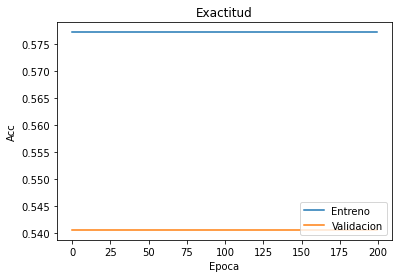

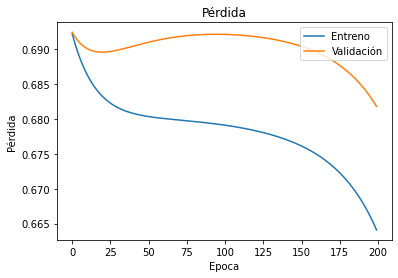

In [ ]:
plt.figure(1)
plt.plot(history.history['accuracy'])  
plt.plot(history.history['val_accuracy'])  
plt.title('Exactitud')  
plt.ylabel('Acc')  
plt.xlabel('Epoca')  
plt.legend(['Entreno', 'Validacion'], loc='lower right')
plt.show()

plt.figure(1) 
plt.plot(history.history['loss'])  
plt.plot(history.history['val_loss'])  
plt.title('Pérdida')  
plt.ylabel('Pérdida')  
plt.xlabel('Epoca')  
plt.legend(['Entreno', 'Validación'], loc='upper right')  
plt.show()

Revisemos ahora la estructura del modelo:

In [ ]:
# red convolucional
model_optuna = load_model('Modelos/Transfer_Optuna_sgd_partseed=1.tf')

model_optuna.summary()

Model: "sequential_74"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten_74 (Flatten)         (None, 2048)              0         
_________________________________________________________________
dense_598 (Dense)            (None, 42)                86058     
_________________________________________________________________
dense_599 (Dense)            (None, 4)                 172       
_________________________________________________________________
dense_600 (Dense)            (None, 18)                90        
_________________________________________________________________
dense_601 (Dense)            (None, 1)                 19        
Total params: 86,339
Trainable params: 86,339
Non-trainable params: 0
_________________________________________________________________


Finalmente, *la prueba de fuego* es la clasificación correcta de todos los frilejones. Divididos cada uno en tres conjuntos de datos. 

In [ ]:
Y_pred = model_optuna.predict(feat_X)
Y_preds = (Y_pred > 0.5)

confusion_matrix(Y.T, Y_preds)

array([[145,   0],
       [  0, 105]], dtype=int64)

Como vemos, al tener una exactitud de $1.0$ para todos los conjuntos de datos, tenemos una clasificación precisa de frilejones.

Hay que tener presente que este modelo paso por 3 conjuntos de datos diferentes y con una validación cruzada doble.

## 2. Caso aplicado

Ahora probemos nuestro modelo sobre la imagen completa de prueba del paramo ``IMG_3451.JPG``.


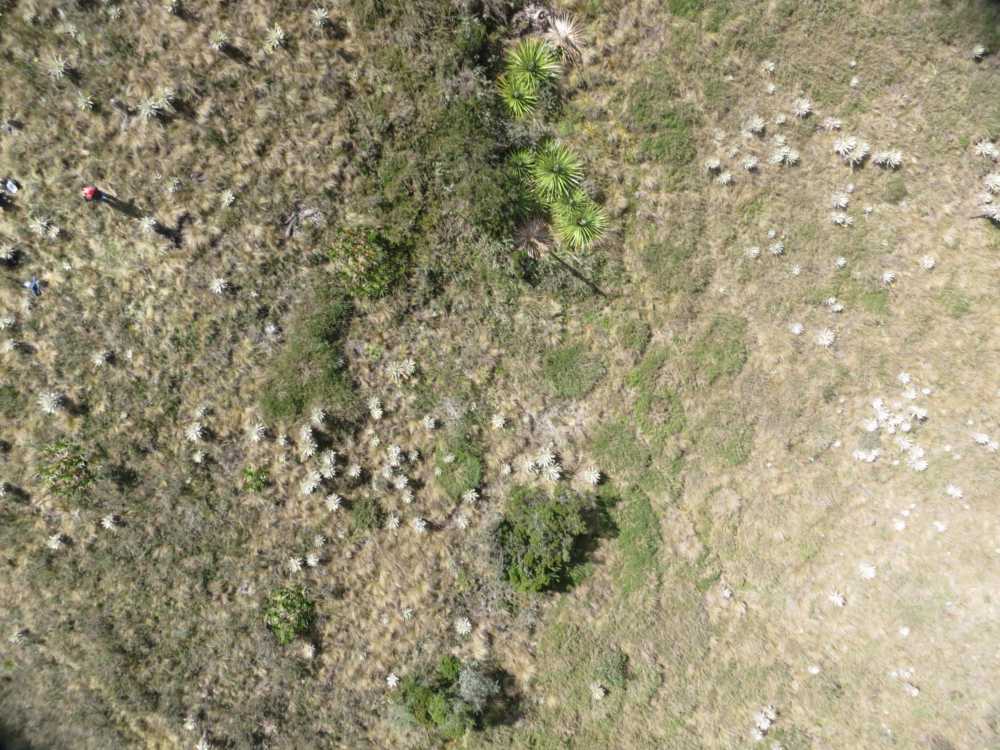

In [ ]:
from keras.preprocessing.image import load_img

img = load_img('Imagenes/IMG_3451.JPG')
img 

### 2.1 Red sencilla

In [ ]:
# red sencilla 5 neuronas
model_1 = load_model('Modelos/modelo_redsencilla_initseed=1_part_seed=3numn=5.h5')

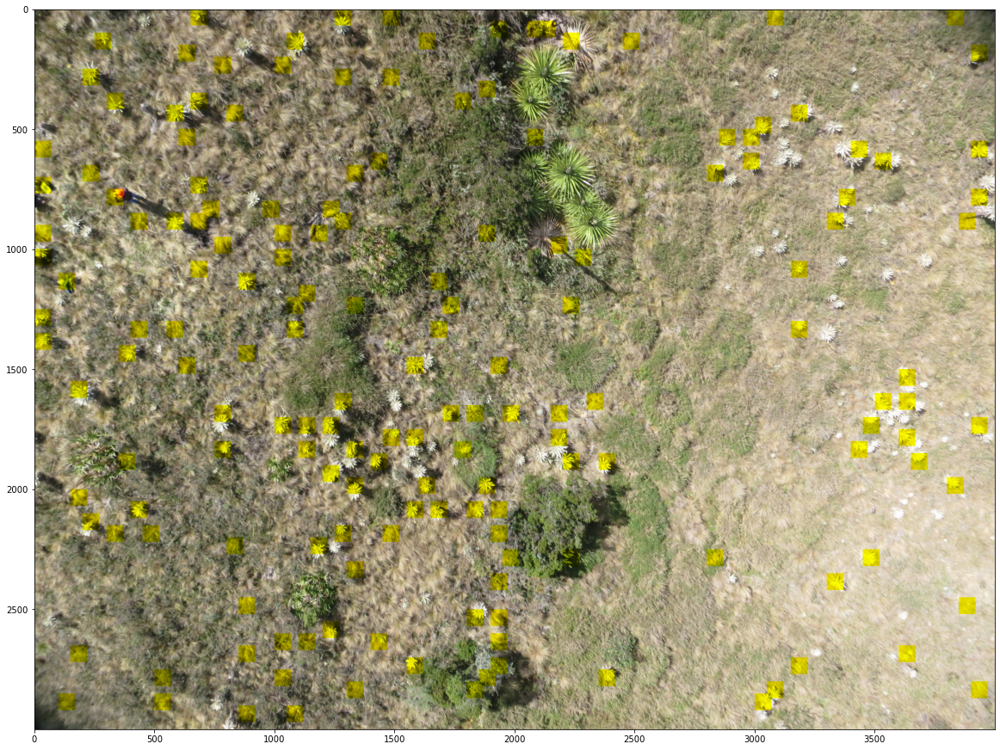

In [ ]:
# Lo pasamos por nuestra imagen de prueba
x = np.array(img)
x2 = x

ni = x.shape[0]-50
mi = x.shape[1]-50

f1=0
f2=70
for i in range(1,ni,50):
    c1=0
    c2=70
    for j in range(1,mi,50):
        subi=x[f1:f2,c1:c2,]/255.
        subi2=np.expand_dims(subi,0)
        Y_preds = model_1.predict(subi2)
        pred_P = (Y_preds > 0.5)
        if(pred_P==1):
            x2[f1:f2,c1:c2,2]=0
        c1=c1+50
        c2=c2+50
    f1=f1+50
    f2=f2+50
        
plt.figure(figsize = (20,20))
plt.imshow(x2)

### 2.2 Red multi-capa

In [ ]:
# red profunda de 6 capas
model_2 = load_model('Modelos/modelo_redprofunda_initseed=1_part_seed=8_Init=Normal.h5')

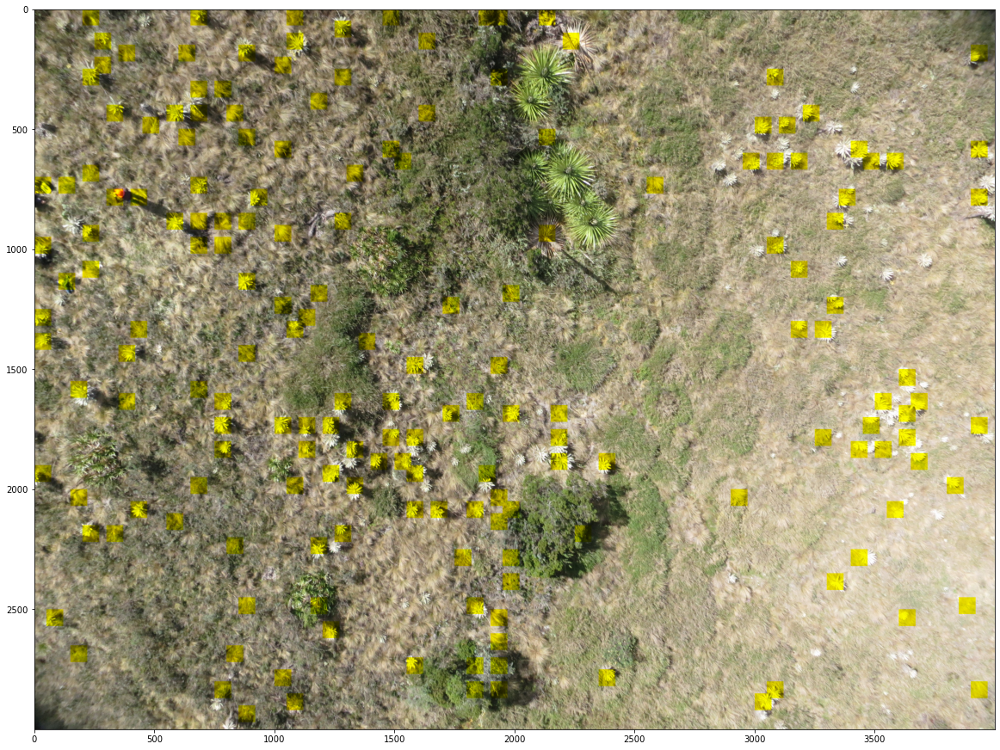

In [ ]:
# Lo pasamos por nuestra imagen de prueba
x = np.array(img)
x2 = x

ni = x.shape[0]-50
mi = x.shape[1]-50

f1=0
f2=70
for i in range(1,ni,50):
    c1=0
    c2=70
    for j in range(1,mi,50):
        subi=x[f1:f2,c1:c2,]/255.
        subi2=np.expand_dims(subi,0)
        Y_preds = model_2.predict(subi2)
        pred_P = (Y_preds > 0.5)
        if(pred_P==1):
            x2[f1:f2,c1:c2,2]=0
        c1=c1+50
        c2=c2+50
    f1=f1+50
    f2=f2+50
        
plt.figure(figsize = (20,20))
plt.imshow(x2)

### 2.3 Red Convolucional

In [ ]:
# red convolucional sencilla
model_3 = load_model('Modelos/modelo_CNN_initseed=1_part_seed=3.tf')

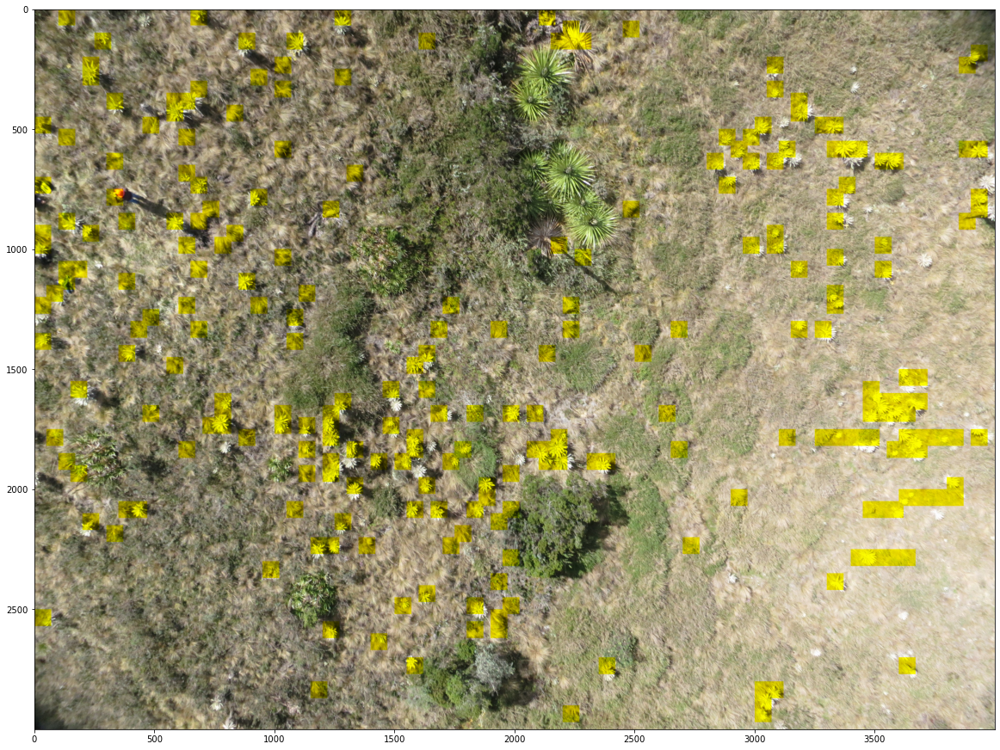

In [ ]:
# Lo pasamos por nuestra imagen de prueba
x = np.array(img)
x2 = x

ni = x.shape[0]-50
mi = x.shape[1]-50

f1=0
f2=70
for i in range(1,ni,50):
    c1=0
    c2=70
    for j in range(1,mi,50):
        subi=x[f1:f2,c1:c2,]/255.
        subi2=np.expand_dims(subi,0)
        Y_preds = model_3.predict(subi2)
        pred_P = (Y_preds > 0.5)
        if(pred_P==1):
            x2[f1:f2,c1:c2,2]=0
        c1=c1+50
        c2=c2+50
    f1=f1+50
    f2=f2+50
        
plt.figure(figsize = (20,20))
plt.imshow(x2)

### 2.4 Red Convolucional VGG-16 con transferencia

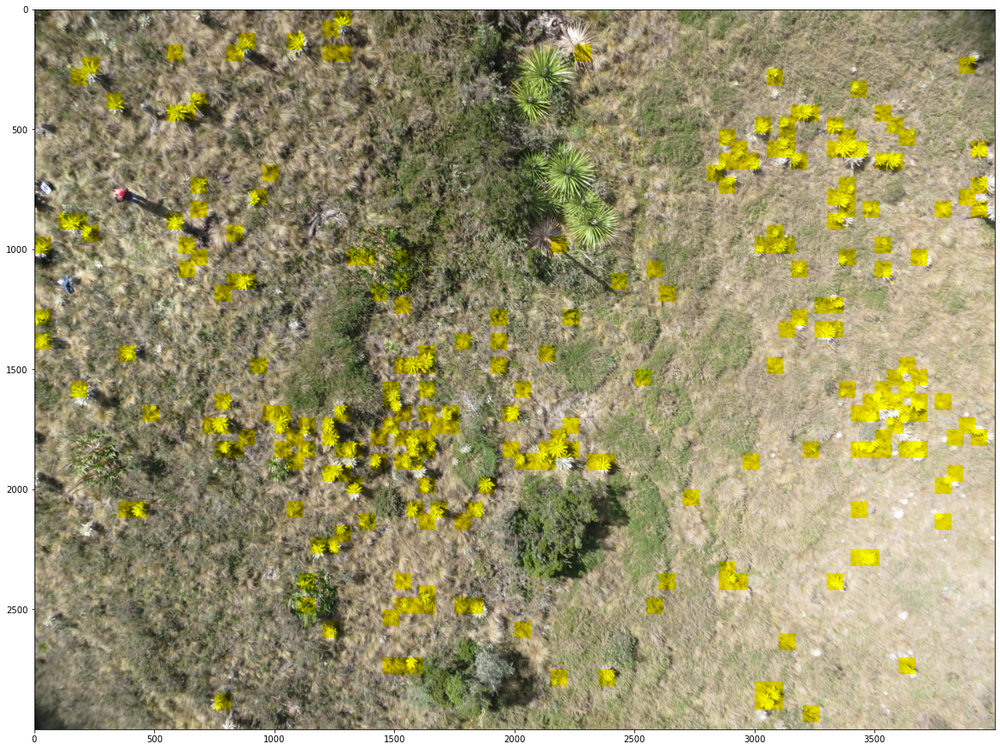

In [ ]:
# Lo pasamos por nuestra imagen de prueba
x = np.array(img)
x2 = x

ni = x.shape[0]-50
mi = x.shape[1]-50

f1=0
f2=70
for i in range(1,ni,50):
    c1=0
    c2=70
    for j in range(1,mi,50):
        subi=x[f1:f2,c1:c2,]/255.
        subi2=np.expand_dims(subi,0)
        feat_subi2 = model0.predict(subi2)
        Y_preds = model_4.predict(feat_subi2)
        pred_P = (Y_preds > 0.5)
        if(pred_P==1):
            x2[f1:f2,c1:c2,2]=0
        c1=c1+50
        c2=c2+50
    f1=f1+50
    f2=f2+50
        
plt.figure(figsize = (20,20))
plt.imshow(x2)

### 2.4 Red Convolucional VGG-16 con transferencia con ajuste de hiperparámetros automatizado con Optuna

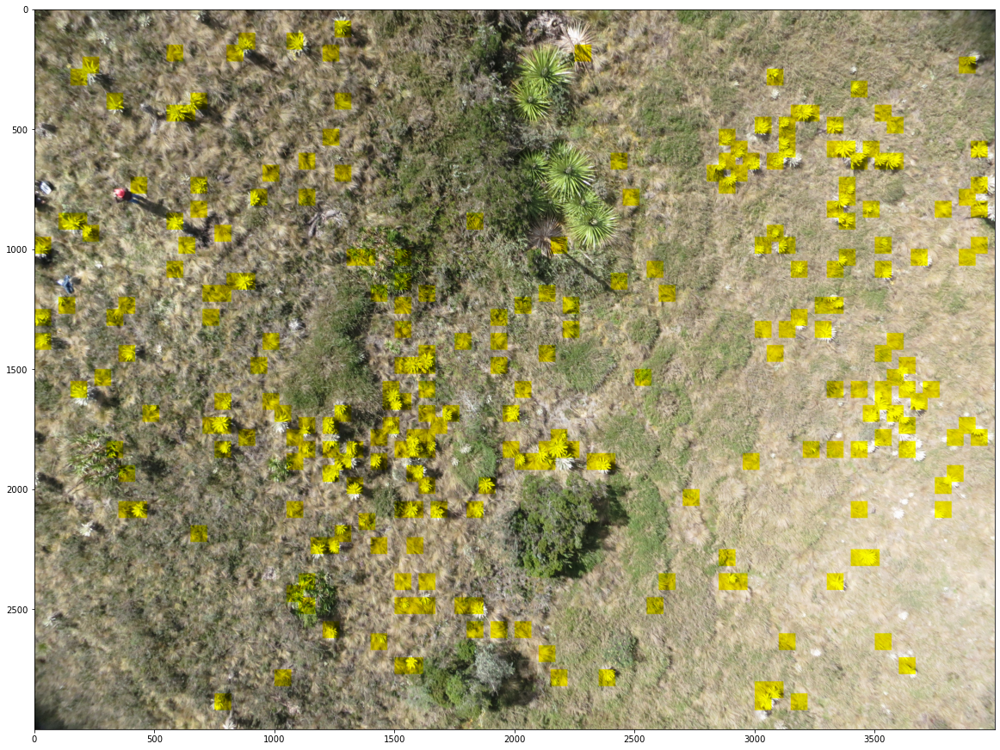

In [ ]:
# Lo pasamos por nuestra imagen de prueba
x = np.array(img)
x2 = x

ni = x.shape[0]-50
mi = x.shape[1]-50

f1=0
f2=70
for i in range(1,ni,50):
    c1=0
    c2=70
    for j in range(1,mi,50):
        subi=x[f1:f2,c1:c2,]/255.
        subi2=np.expand_dims(subi,0)
        feat_subi2 = model0.predict(subi2)
        Y_preds = model_optuna.predict(feat_subi2)
        pred_P = (Y_preds > 0.5)
        if(pred_P==1):
            x2[f1:f2,c1:c2,2]=0
        c1=c1+50
        c2=c2+50
    f1=f1+50
    f2=f2+50
        
plt.figure(figsize = (20,20))
plt.imshow(x2)

### Pregunta 2.1

¿Qué puede observar sobre el desempeño de los diferentes modelos? Argumente cuál es el mejor modelo para poner en producción.

---

**Respuesta**

Teniendo en cuenta los accuracy obtenidos para cada una de las redes implementadas, se evidencia una mejora en cada modificación que va adicionando un mayor grado de dificultad a la red, que al final se traduce en un mejor desempeño para el modelo y por tanto una mayor precisión al momento de identificar frailejones.

El modelo que generaliza de una mejor manera los datos y el cual debería ponerse en producción es el que corresponde a la red convolucional pre-entrenada, esta selección se realiza en pro de evitar una alta tasa de equivocaciones en el reconocimiento de frailejones.

A continuación se relacionan las medidas de exactitud obtenidas en cada una de las redes:

Sencilla --> 0.88  
Multi-capa --> 0.952  
Convolucional --> 0.952  
Convolucional -VGG16 -->  0.996

### Ejercicio 2.2

Investigue otra red pre-entrenada dsitinta a la VGG-16 e implemente el aprendizaje por transferencia para la deteccion de frailejones. Argumente por qué su justifica el aprendizaje por transferencia con base en el modelo pre-entrenado de su elección (cómo se relacionan la tarea base y la segunda tarea objetivo).

### Ejercicio 2.3
Construya un algoritmo que utilice el mejor modelo de red neuronal para la detección de poblaciones en la imagen completa IMG_3451.JPG, y estime la densidad para cada población detectada.

*Ayuda:* Mediante un procedimiento sencillo, primero detecte las poblaciones de frailejones y luego estime su densidad, calculada como el numero de frailejones por area poblada.

#### Respuesta

De acuerdo a las instrucciones, tenemos que detectar la densidad por cada población detectada. Y de acuerdo con 'ayuda' tenemos que detectar las poblaciones de frilejones y nuestra densidad será el número de frlejones en esa área. 

En este orden de ideas, existen muchas formas de calcular la densidad. Cada una de ellas depende de la forma en la que se detecte la población. De manera, que nosotros propondremos 3 formas de encontrar poblaciones de frilejones.

**La primera**, es sencilla e intuitiva. Encontrar todos los frilejones en la imagen. Y esta será la primera densidad; podríamos encontrar también cuantos espacios 'NO son frilejones' y de esta manera, sacar el cociente entre los dos para poder inferir de la totalidad de cuadrantes evaluados ¿cuales son frilejones?.

**La senguda**, es un poco más sofisticada. Consiste en sacar la ubicación de cada frilejon "simulando longitud y latitud" para después realizar una clusterización de las poblaciones. Es evidente que existen diversos algoritmos para poder realizar la clusterización, de manera que nosotros usaremos una que nos indique no solamente el número de frilejones, sino el solapamiento de las poblaciones y calcule una densidad. Este algoritmo es conocido como GMM o Gaussian Mixture Models. En resumen es un modelo no supervisado que clusteriza de acuerdo a los vectores que se ingresen. Nosotros ingresaremos "longitud" y "latitud" simuladas. Este algoritmo asume una distribución Gaussiana para cada cluster. De manera tal que se puede apreciar la densisdad poblacional dada esta distribución Gaussiana. 

*En comparación con K-means (un algoritmo similar)*:

$$
K-means:
(x-\mu_k)^2
$$

$$
GMM:
\frac{(x-\mu_k)^2}{\sigma^2}
$$

Entendiendo que la diferencia matemática es el denominador $\sigma^2$. Que para el GMM significa que toma la varianza como consideración cuando realiza el calculo de la medida. K-means, únicamente calcula la distancia euclidiana. Es decir, K-means calcula la distancia entre los puntos para sacar las poblaciones de frilejones; GMM calcula los *pesos* de las distancias. Existen esta y muchas otras consideraciones en el siguiente Notebook [intro_to_gmm_em.ipynb](https://nbviewer.jupyter.org/github/sergiomora03/Gaussian_Mixture_Models/blob/master/intro_to_gmm_%26_em.ipynb)

**Y la tercera**, es dividir en cuadrantes la imagen para calcular cuantos frilejones estan por cada cuadrante. Y de esta manera hayar la densidad.

---

#### Densidad total
Iniciaremos con el cálculo total de frilejones en la imagen y con ello (de acuerdo con la *ayuda*) tendrémos la densidad de frilejones. Para ello únicamente correremos el loop nuevamente y cambiaremos un poco sus parametros para contar el número exacto de frilejones en la imagen. 

NOTA: aprovecharemos también para sacar la ubicaciónd de cada frilejon simulando "latitud y longitud".

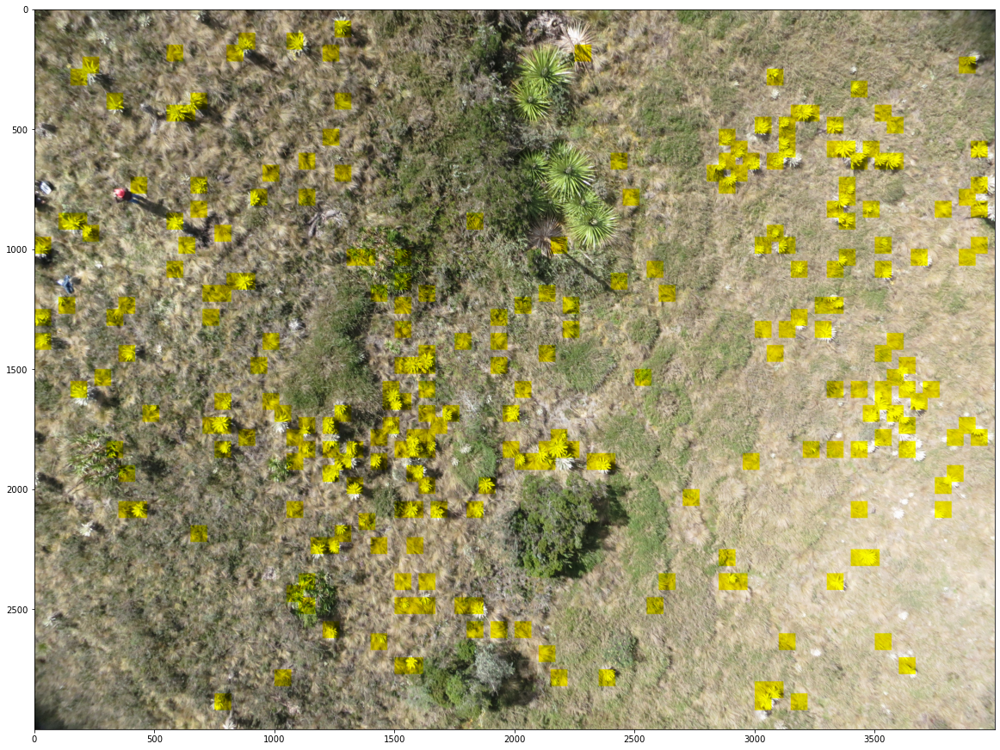

In [ ]:
# Lo pasamos por nuestra imagen de prueba
x = np.array(img)
x2 = x

# Densidad de frailejones en toda la imagen
frilejones = 0
no_frilejones = 0

# Simulando ubicación de frilejones
longitud = []
latitud = []


ni = x.shape[0]-50
mi = x.shape[1]-50

f1=0
f2=70
for i in range(1,ni,50):
    c1=0
    c2=70
    for j in range(1,mi,50):
        subi=x[f1:f2,c1:c2,]/255.
        subi2=np.expand_dims(subi,0)
        feat_subi2 = model0.predict(subi2)
        Y_preds = model_optuna.predict(feat_subi2)
        pred_P = (Y_preds > 0.5)
        if(pred_P==1):
            x2[f1:f2,c1:c2,2]=0
            frilejones += 1
            longitud.append(i)
            latitud.append(j)
        else:
            no_frilejones += 1
        #break
        c1=c1+50
        c2=c2+50
    f1=f1+50
    f2=f2+50
        
plt.figure(figsize = (20,20))
plt.imshow(x2)

Como vemos, aprovechamos el loop completo para sacar dicha información. Ahora, el número total de frilejones es:

In [ ]:
print(f'Número total de frilejones = {frilejones}')

Número total de frilejones = 259


In [ ]:
print(f'Número total de cuadrantes evaluados = {frilejones+no_frilejones}')

Número total de cuadrantes evaluados = 4661


In [ ]:
print(f'Número total de cuadrantes que no eran frilejones = {no_frilejones}')

Número total de cuadrantes que no eran frilejones = 4402


In [ ]:
print(f'Total densidad estimada = {frilejones/no_frilejones*100}%')

Total densidad estimada = 5.883689232167197%


Es necesario tener en cuenta que la densidad estimada no es la misma que la densidad indicada por las instrucciones. De acuerdo a las instrucciones la densidad total de los frilejones en la imagen es de 259.

---

#### Densidad con GMM

Ahora calcularemos la densidad por medio del GMM. Primero verifiquemos la ubicación de cada uno de los frilejones. Crearemos un dataframe y evaluaremos sus posiciones.

In [ ]:
data_ = pd.DataFrame(list(zip(longitud, latitud)), columns = ["longitud", "latitud"])
data.longitud = data.longitud * -1
data.head()

,longitud,latitud
0,-51,1251
1,-101,851
2,-101,1051
3,-151,551
4,-151,801


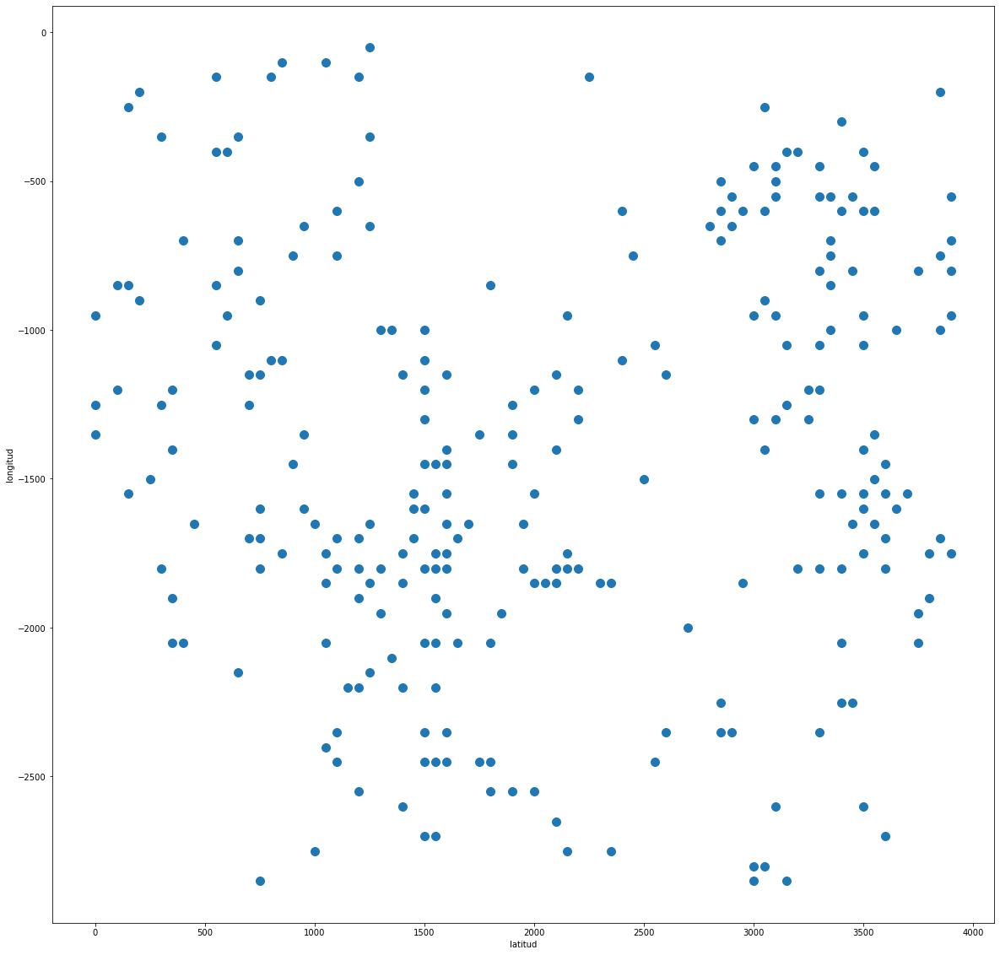

In [ ]:
data.plot.scatter("latitud", "longitud", 100, figsize = (20, 20))

Como vemos, las posiciones parecen tener sentido. Hace falta mencionar que modificamos el parámetro de longitud, multiplicandolo por -1, Dado que *matplotlib* no cambia la orientacion del eje de *Y*.

Ahora, si comparamos directamente con la imagen, podemos apreciar que cada punto azul pertenece a un frilejon de color amarillo en la imagen de la izquierda.

Text(0.5, 1.0, 'Data')

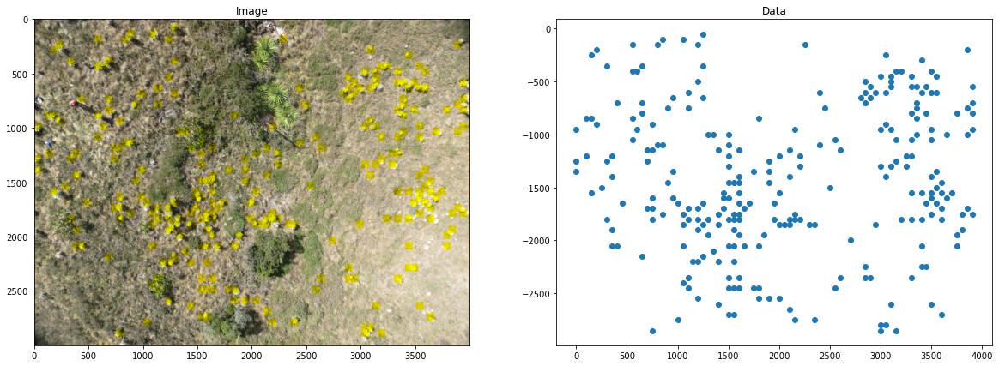

In [ ]:
f, (ax1, ax2) = plt.subplots(1, 2, sharey=False, figsize = (20, 7))
ax1.imshow(x2)
ax1.set_title('Image')
ax2.scatter(data.latitud, data.longitud)
ax2.set_title('Data')

Para calcular el **GMM** es necesario definir un número de componentes al igual que en el *k-means*. Pero estos componentes obedecen a un calculo gaussiano. De forma tal, que usaremos el **BIC** para determinar el número que mejor se ajusta o mínimiza el *Bayesian Information Criteria*. Correremos un loop para validar cual es el número de componentes que menor BIC genera.

In [ ]:
for i in range(1, 10):
    gmm = sm.GaussianMixture(n_components=i)
    gmm.fit(data.values)
    print("BIC -> ", gmm.bic(data.values), "Componentes ->", i)

BIC ->  8523.324837985418 Componentes -> 1
BIC ->  8430.454800368201 Componentes -> 2
BIC ->  8443.71551479627 Componentes -> 3
BIC ->  8444.647353220476 Componentes -> 4
BIC ->  8471.705567044924 Componentes -> 5
BIC ->  8502.669428209236 Componentes -> 6
BIC ->  8514.277456904876 Componentes -> 7
BIC ->  8490.282613354795 Componentes -> 8
BIC ->  8557.982215184502 Componentes -> 9


Como vemos, el que menor BIC genera es el de 2 comonentes. Así que procederemos a usarlo con dos componentes. Tenemos qu tener en cuenta que por default el GMM calcula la covarianza total, sobre todos los componentes. Lo cual, es coherente con lo que haremos.

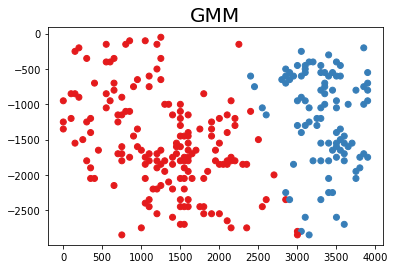

In [ ]:
gmm = sm.GaussianMixture(n_components=2, random_state=11, covariance_type='full')
gmm.fit(data)
y_pred = gmm.predict(data)


plt.scatter(data.latitud, data.longitud, c=y_pred, cmap='Set1',vmin=0, vmax=7)
plt.title("GMM", size=20)
plt.show()

Ahora, una vez escogemos el número de componentes. Usaremos el score que genera GMM, para calcular la densidad. Es mucho más interesante en tres dimensiones. De todas maneras, iniciaremos mostrando como se ve el efecto de cada uno bajo una distribución gaussiana.

In [ ]:
data['poblacion'] = y_pred

Sacando el número de frilejones, con este cluster. Tenemos:

In [ ]:
print(f'El total de frilejones en la población azul, es de = {data.poblacion.sum()} frilejones')

El total de frilejones en la población azul, es de = 95 frilejones


In [ ]:
print(f'El total de frilejones en la población roja, es de = {data.shape[0]-data.poblacion.sum()} frilejones')

El total de frilejones en la población roja, es de = 164 frilejones


Si tenemos en cuenta las instrucciones, estas son las densidad para estas dos poblaciones encontradas con el GMM-

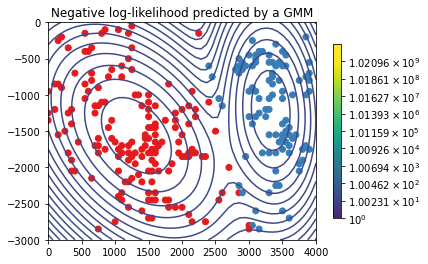

In [ ]:
X, Y = np.meshgrid(np.linspace(0., -3000.), np.linspace(4000., 0.))
XX = np.array([X.ravel(), Y.ravel()]).T
Z = -gmm.score_samples(XX)
Z = Z.reshape(X.shape)

CS = plt.contour(Y, X, Z, norm=LogNorm(vmin=1e-1, vmax=1e+9), levels=np.logspace(0, 10, 1000))
CB = plt.colorbar(CS, shrink=0.8, extend='both')
plt.scatter(data.latitud, data.longitud, c=y_pred, cmap='Set1',vmin=0, vmax=7)

plt.title('Negative log-likelihood predicted by a GMM')
plt.axis('tight')
plt.show()

Una vez vista la distribución Gaussiana sobre los dos factores del GMM. Veremos como se ven estas dos distribucciones en tres dimenciones.

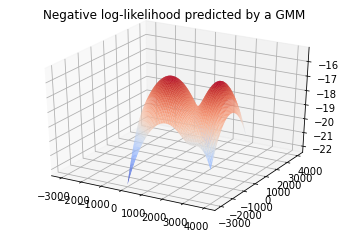

In [ ]:
fig = plt.figure()
ax = fig.gca(projection='3d')

ax.plot_surface(Y, X, Z*-1, cmap=cm.coolwarm, linewidth=0, antialiased=True)
cset = ax.contour(X, Y, Z*-1, zdir='z', offset=-100, cmap=cm.coolwarm)

plt.title('Negative log-likelihood predicted by a GMM')
plt.show()

Se aprecia que la densidad es similar entre las dos poblaciones. No obstante, una tiende a ser más extensa que la otra. Podemos sacar más análisis de este modelo para entender mucho más la densidad. Pero solo mostraremos la densidad bajo el entendimiento del GMM. Este (cabe mencionar) difiere de la desidad en las instrucciones, pero aumenta más la comprensión en la distribución de frilejones la de imagen.

---

#### Densidad por cuadrante

Ahora calcularemos la densidad para cada cuadrante, dividiremos la imagen en cerca de 400 cuadrantes de 100x300 cada uno. Y luego,correremos el mismo loop que detecta el número de frilejones en toda la imagen. Tenemos entonces:


In [ ]:
# Lo pasamos por nuestra imagen de prueba
x = np.array(img)
x2 = x

# Densidad de frailejones en toda la imagen
frilejones = 0
no_frilejones = 0

# Simulando ubicación de frilejones
longitud = []
latitud = []

# Número de cuadro
cuadro = 0

# Cantidad de frilejones
cantidad = pd.DataFrame(columns = ['Cuadro', 'Frilejones', 'No_Frilejones'])

# Margenes de la imagen
ni = x.shape[0]-100
mi = x.shape[1]-100

for f in range(1,ni,100):
    for r in range(1,mi,300):
        cuadro += 1
        frilejones_cuadro = 0
        no_frilejones_cuadro = 0
        f1=0
        f2=70
        for i in range(1,100,50):
            c1=0
            c2=70
            for j in range(1,300,50):
                subi=x[f1:f2,c1:c2,]/255.
                subi2=np.expand_dims(subi,0)
                feat_subi2 = model0.predict(subi2)
                Y_preds = model_optuna.predict(feat_subi2)
                pred_P = (Y_preds > 0.5)
                if(pred_P==1):
                    x2[f1:f2,c1:c2,2]=0
                    frilejones_cuadro += 1
                    frilejones += 1
                    longitud.append(i)
                    latitud.append(j)
                else:
                    no_frilejones += 1
                    no_frilejones_cuadro += 1
                #break
                c1=c1+50
                c2=c2+50
            f1=f1+50
            f2=f2+50
        cantidad = cantidad.append({'Cuadro' : cuadro,
                                            'Frilejones' : frilejones_cuadro,
                                            'No_Frilejones': no_frilejones_cuadro
                                           }, ignore_index = True) 
        print("Población N°", cuadro, ", Número Frilejones =", frilejones_cuadro, " , No Frilejones = ", no_frilejones_cuadro)

        
        
plt.figure(figsize = (20,20))
plt.imshow(x2)

Población N° 1 , Número Frilejones = 0  , No Frilejones =  12
Población N° 2 , Número Frilejones = 0  , No Frilejones =  12
Población N° 3 , Número Frilejones = 0  , No Frilejones =  12
Población N° 4 , Número Frilejones = 0  , No Frilejones =  12
Población N° 5 , Número Frilejones = 0  , No Frilejones =  12
Población N° 6 , Número Frilejones = 0  , No Frilejones =  12
Población N° 7 , Número Frilejones = 0  , No Frilejones =  12
Población N° 8 , Número Frilejones = 0  , No Frilejones =  12
Población N° 9 , Número Frilejones = 0  , No Frilejones =  12
Población N° 10 , Número Frilejones = 0  , No Frilejones =  12
Población N° 11 , Número Frilejones = 0  , No Frilejones =  12
Población N° 12 , Número Frilejones = 0  , No Frilejones =  12
Población N° 13 , Número Frilejones = 0  , No Frilejones =  12
Población N° 14 , Número Frilejones = 0  , No Frilejones =  12
Población N° 15 , Número Frilejones = 0  , No Frilejones =  12
Población N° 16 , Número Frilejones = 0  , No Frilejones =  12
P

KeyboardInterrupt: 

In [ ]:
cantidad

,Cuadro,Frilejones,No_Frilejones
0,1,0,12
1,2,0,12
2,3,0,12
3,4,0,12
4,5,0,12
5,6,0,12
6,7,0,12
7,8,0,12
8,9,0,12
9,10,0,12
